# CoDA — Graph snapshots **only when changed** (uncertainty-aware)

This notebook runs acquisition → extinction with the uncertainty-aware split rule, but **only draws a graph snapshot when the graph changes** relative to the previous episode.

**Change criterion** (fast, deterministic):
- Any change in transition tensor shape (e.g., new clone added).
- After aggregating over actions, any change in the **thresholded** adjacency (same threshold as the plotter).
- Any change in `clone_dict` mapping (detects clone re-wiring/merge).

This matches the visual “Graph at episode XX” you use, but avoids redundant frames.


In [9]:

import sys, numpy as np
# sys.path.append('/mnt/data')
import matplotlib.pyplot as plt
from typing import List
from spatial_environments import GridEnvRightDownNoSelf, GridEnvRightDownNoCue
from coda_trial_by_trial_util import CoDAAgent, CoDAConfig
# from spatial_environments import GridEnvRightDownNoSelf, GridEnvRightDownNoCue
from util import generate_dataset, generate_dataset_post_augmentation
from coda_metrics import kl_over_time, entropy_over_time, markovization_score, ref_empirical_from_rollouts, greedy_right_down_policy


In [10]:

# --- Config ---
# CUE = 5
THRESH = 0.3               # must match env.plot_graph threshold
cfg = CoDAConfig(
    theta_split=0.6, theta_merge=0.5,
    n_threshold=8, min_presence_episodes=3, min_effective_exposure=5.0,
    confidence=0.8, 
    count_decay=0.9, 
    # trace_decay=0.9,    # makes PC recent
    # retro_decay=0.9     # makes RC recent
)
N_SEEDS   = 30
SEED0     = 0
# N_ACQ     = 250
# N_EXT     = 300
# MAX_STEPS = 20
CUE       = 5

# cfg.theta_split = 0.85
N_ACQ, N_EXT = 250, 300
MAX_STEPS = 20
N_ROLL_REF = 300
env = GridEnvRightDownNoSelf(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
agent = CoDAAgent(env, cfg)


In [11]:
# --- Minimal environment for near/far (single dummy action) ---
class NFEnv:
    def __init__(self, n_states: int, reward: int = 6, no_reward: int = 7):
        # What CoDAAgent uses:
        self.num_unique_states = int(n_states)
        self.valid_actions = {s: [0] for s in range(self.num_unique_states)}  # one action
        self.rewarded_terminals   = [int(reward)]     # treat '6' as US
        self.unrewarded_terminals = [int(no_reward)]  # treat '7' as no‑US (optional)
        # Clone bookkeeping used by _split_state / _merge_cue
        self.clone_dict = {}          # {clone_id: base_successor}
        self.reverse_clone_dict = {}  # {base_successor: latest_clone_id}

    def add_clone_dict(self, clone_id: int, successor: int):
        self.clone_dict[clone_id] = successor

    def add_reverse_clone_dict(self, new_clone: int, successor: int):
        self.reverse_clone_dict[successor] = new_clone
# --- Base strings you gave (near/far) ---
near = [1,1,1,1,1,1,  2,2,2,2,  1,1,1,  4,6,  1,1,1,  5,5,  1,1,  7, 0,0,0]
far  = [1,1,1,1,1,1,  3,3,3,3,  1,1,1,  4,4,  1,1,1,  5,6,  1,1,  7, 0,0,0]

preR1_idx = list(range(10,13))   # indices used for Fig.4 blocks
preR2_idx = list(range(15,18))
def block_indices(rows, cols): return [(r,c) for r in rows for c in cols]
offdiag_pairs     = block_indices(preR1_idx, preR2_idx) + block_indices(preR2_idx, preR1_idx)
same_preR1_pairs  = block_indices(preR1_idx, preR1_idx)
same_preR2_pairs  = block_indices(preR2_idx, preR2_idx)

# --- Make a stochastic episode by toggling whether 6 appears after 4/5 ---
import random

def sample_episode(p_4_to_6=0.5, p_5_to_6=0.5):
    """
    Returns a single observation sequence (list[int]).
    - With prob p_4_to_6, NEAR will include '... 4,6 ...', otherwise we drop that '6'.
    - With prob p_5_to_6, FAR  will include '... 5,6 ...', otherwise we drop that '6'.
    Near vs Far trials are chosen 50/50 here; adjust as you like.
    """
    if random.random() < 0.5:                      # NEAR trial
        seq = near.copy()
        # near has "... 4, 6, 1,1,1 ..."
        i4 = seq.index(4)
        if random.random() >= p_4_to_6:
            # drop the '6' that follows the '4' (no US on this near trial)
            if i4+1 < len(seq) and seq[i4+1] == 6:
                del seq[i4+1]
        return seq
    else:                                          # FAR trial
        seq = far.copy()
        # far has "... 5, 6, 1,1 ..."
        i5 = seq.index(5)           # first 5 (the one followed by 6)
        # make sure we pick the 5 that is followed by 6 (there are two 5s in 'near' base)
        # the far base already places the 5 that is followed by 6 at i5
        if random.random() >= p_5_to_6:
            if i5+1 < len(seq) and seq[i5+1] == 6:
                del seq[i5+1]       # drop the 6 (no US on this far trial)
        return seq
# Build env and agent
n_base = max(max(near), max(far)) + 1
env = NFEnv(n_states=n_base, reward=6, no_reward=7)  # 6 = US; 7 = no‑US

In [12]:
# Build env and agent
n_base = max(max(near), max(far)) + 1
env = NFEnv(n_states=n_base, reward=6, no_reward=7)  # 6 = US; 7 = no‑US

# Keep your class as-is; just lighten gates so splits propagate
cfg = CoDAConfig(
    gamma=0.9, lam=0.8,
    theta_split=0.85,          # was 0.90
    theta_merge=0.50,
    n_threshold=3,             # evidence gates relaxed so splits start earlier
    min_presence_episodes=3,
    min_effective_exposure=8.0,
    confidence=0.90,
    alpha0=0.25, beta0=0.25,
    count_decay=1.0, trace_decay=1.0, retro_decay=1.0
)
agent = CoDAAgent(env, cfg)    # <-- your class

# Helper: truncate a sampled episode to the *first* terminal (6 if present, else 7)
def to_terminal(states):
    if 6 in states:
        return states[:states.index(6)+1]   # rewarded terminal
    if 7 in states:
        return states[:states.index(7)+1]   # unrewarded terminal
    return states

# Run training
N_EPISODES = 2000
for ep in range(N_EPISODES):
    obs_seq = sample_episode(p_4_to_6=0.5, p_5_to_6=0.5)
    states  = to_terminal(obs_seq)                 # ends at 6 (reward) or 7 (no‑reward)
    actions = [0]*(len(states)-1)                  # single dummy action
    agent.update_with_episode(states, actions)     # prospective + retrospective accumulation
    agent.maybe_split()                            # allow new cues
    # agent.maybe_merge()                          # leave off during acquisition if you prefer

# Quick readouts to ensure it's working
pc = agent.prospective()             # P(reward|state)
print("Salient cues:", sorted(agent.salient_cues))
print("Mean PC preR1:", pc[10:13].mean(), "  Mean PC preR2:", pc[15:18].mean())


Salient cues: [2]
Mean PC preR1: nan   Mean PC preR2: nan


/var/folders/s0/k9fg8kp94xl307gydfsd9gf00000gq/T/ipykernel_46829/2282533314.py:40: RuntimeWarning: Mean of empty slice.
  print("Mean PC preR1:", pc[10:13].mean(), "  Mean PC preR2:", pc[15:18].mean())


In [13]:
# import numpy as np

def sanitize_for_plot(env, T, eps=1e-12):
    """
    Remove clones with ~zero inbound+outbound mass and rebuild reverse map.
    Safe for growing/shrinking T during splits/merges.
    """
    if T is None or getattr(T, "ndim", 0) != 3:
        return

    S = T.shape[0]

    # Outbound mass from each state: sum over actions and next states
    out_mass = T.sum(axis=(1, 2))   # shape [S]

    # Inbound mass to each state: sum over sources and actions
    in_mass  = T.sum(axis=(0, 1))   # shape [S]

    active = (out_mass + in_mass) > eps

    # Drop clone ids that are inactive or out of bounds
    for cl in list(env.clone_dict.keys()):
        if cl >= S or not active[cl]:
            env.clone_dict.pop(cl, None)

    # Rebuild reverse mapping (parent -> latest clone)
    env.reverse_clone_dict = {parent: cl for cl, parent in env.clone_dict.items()}

def make_terminals_absorbing_for_plot(T, terminals):
    T = T.copy()
    for t in terminals:
        if t < T.shape[0]:
            T[t, :, :] = 0.0
    return T
def thresh_adj(T, thr=0.3):
    A = T.sum(axis=1)         # [S,S]
    return (A >= thr).astype(np.uint8)

def clone_dict_tuple(d):
    return tuple(sorted(d.items()))

def graph_changed(prev_T, prev_map, curr_T, curr_map, thr=0.3):
    if prev_T is None or prev_T.shape != curr_T.shape:
        return True
    A_prev = thresh_adj(prev_T, thr)
    A_curr = thresh_adj(curr_T, thr)
    if A_prev.shape != A_curr.shape:
        return True
    if (A_prev != A_curr).any():
        return True
    return prev_map != curr_map



In [14]:

def _n_actions(env):
    return max(a for acts in env.valid_actions.values() for a in acts) + 1

def _base_successor(env, s, a):
    i, j  = env.state_to_pos[s]
    di, dj = env.base_actions[a]
    ni, nj = i + di, j + dj
    return env.pos_to_state.get((ni, nj), s)

def _build_base_T(env):
    S0 = env.num_unique_states
    A  = _n_actions(env)
    T  = np.zeros((S0, A, S0), dtype=float)
    terminals = set(env.rewarded_terminals) | set(env.unrewarded_terminals)
    for s, acts in env.valid_actions.items():
        if s in terminals: 
            continue
        for a in acts:
            sp = _base_successor(env, s, a)
            T[s, a, sp] = 1.0
    return T

def _descendants_until_terminal(env, start, terminals):
    adj = {s: [_base_successor(env, s, a) for a in env.valid_actions.get(s, [])]
           for s in range(env.num_unique_states)}
    seen, Q = set(), [start]
    while Q:
        s = Q.pop(0)
        for sp in adj.get(s, []):
            if sp in terminals: 
                continue
            if sp not in seen:
                seen.add(sp); Q.append(sp)
    return seen

def build_gt_acquisition_with_clones(env, cue_state: int) -> np.ndarray:
    S0 = env.num_unique_states
    A  = _n_actions(env)
    T0 = _build_base_T(env)

    terminals = set(env.rewarded_terminals) | set(env.unrewarded_terminals)
    rewT = env.rewarded_terminals
    unrewT = env.unrewarded_terminals

    D = _descendants_until_terminal(env, cue_state, terminals)
    clone_of = {orig: S0 + k for k, orig in enumerate(sorted(D))}
    S = S0 + len(clone_of)
    T = np.zeros((S, A, S), dtype=float)
    T[:S0, :, :S0] = T0

    for a in env.valid_actions[cue_state]:
        sp = _base_successor(env, cue_state, a)
        if sp in D:
            T[cue_state, a, sp] = 0.0
            T[cue_state, a, clone_of[sp]] = 1.0

    for orig, cl in clone_of.items():
        for a in env.valid_actions[orig]:
            sp = _base_successor(env, orig, a)
            if sp in terminals:
                for t in rewT:   T[cl, a, t] = 1.0
                for t in unrewT: T[cl, a, t] = 0.0
            else:
                T[cl, a, clone_of[sp] if sp in clone_of else sp] = 1.0

        for a in env.valid_actions[orig]:
            sp = _base_successor(env, orig, a)
            if sp in rewT:
                T[orig, a, sp] = 0.0
                idx = rewT.index(sp)
                T[orig, a, unrewT[idx]] = 1.0
    return T

def build_gt_extinction_no_clones(env2) -> np.ndarray:
    T = _build_base_T(env2)
    for s in range(env2.num_unique_states):
        for a in env2.valid_actions.get(s, []):
            sp = _base_successor(env2, s, a)
            if sp in env2.rewarded_terminals:
                idx = env2.rewarded_terminals.index(sp)
                T[s, a, sp] = 0.0
                T[s, a, env2.unrewarded_terminals[idx]] = 1.0
    return T

def _pad3(arr: np.ndarray, shape: tuple) -> np.ndarray:
    S, A, S2 = arr.shape
    Sg, Ag, S2g = shape
    if (S, A, S2) == (Sg, Ag, S2g): 
        return arr
    out = np.zeros((Sg, Ag, S2g), dtype=float)
    out[:min(S,Sg), :min(A,Ag), :min(S2,S2g)] = arr[:min(S,Sg), :min(A,Ag), :min(S2,S2g)]
    return out

def _ref_fn_fixed(T_fixed: np.ndarray):
    def _fn(T_learned):
        shape = tuple(max(x,y) for x,y in zip(T_learned.shape, T_fixed.shape))
        return _pad3(T_fixed, shape)
    return _fn


In [15]:

def ref_builder_factory(env, policy_fn, nroll=300, max_steps=20):
    def _make_ref(T_learned):
        return ref_empirical_from_rollouts(env, policy_fn, n_episodes=nroll, max_steps=max_steps)
    return _make_ref

def run_one_seed(seed:int):
    np.random.seed(seed)

    env = GridEnvRightDownNoSelf(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])

    T_ref_acq_fixed = build_gt_acquisition_with_clones(env, cue_state=CUE)
    ref_fn_acq = _ref_fn_fixed(T_ref_acq_fixed)


    agent = CoDAAgent(env, cfg)

    T_series_acq: List[np.ndarray] = []
    with_clones = False
    for ep in range(1, N_ACQ+1):
        if with_clones:
            (states, actions) = generate_dataset_post_augmentation(env, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
        else:
            (states, actions) = generate_dataset(env, n_episodes=1, max_steps=MAX_STEPS)[0]
        agent.update_with_episode(states, actions)
        if agent.maybe_split():
            with_clones = True
        T_series_acq.append(agent.get_T().copy())

    env2 = GridEnvRightDownNoCue(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
    env2.clone_dict = dict(getattr(env, "clone_dict", {}))
    env2.reverse_clone_dict = dict(getattr(env, "reverse_clone_dict", {}))
    agent.env = env2

    T_ref_ext_fixed = build_gt_extinction_no_clones(env2)
    ref_fn_ext = _ref_fn_fixed(T_ref_ext_fixed)

    T_series_ext: List[np.ndarray] = []
    for ep in range(N_ACQ+1, N_ACQ+N_EXT+1):
        (states, actions) = generate_dataset_post_augmentation(env2, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
        agent.update_with_episode(states, actions)
        agent.maybe_merge()
        T_series_ext.append(agent.get_T().copy())

    # ref_fn_acq = ref_builder_factory(env,  greedy_right_down_policy, nroll=N_ROLL_REF, max_steps=MAX_STEPS)
    # ref_fn_ext = ref_builder_factory(env2, greedy_right_down_policy, nroll=N_ROLL_REF, max_steps=MAX_STEPS)

    KL_acq = kl_over_time(T_series_acq, ref_fn_acq, use_js=False)
    JS_acq = kl_over_time(T_series_acq, ref_fn_acq, use_js=True)
    H_acq  = entropy_over_time(T_series_acq)
    MS_acq = np.array([markovization_score(T) for T in T_series_acq])

    KL_ext = kl_over_time(T_series_ext, ref_fn_ext, use_js=False)
    JS_ext = kl_over_time(T_series_ext, ref_fn_ext, use_js=True)
    H_ext  = entropy_over_time(T_series_ext)
    MS_ext = np.array([markovization_score(T) for T in T_series_ext])

    return dict(KL_acq=KL_acq, JS_acq=JS_acq, H_acq=H_acq, MS_acq=MS_acq,
                KL_ext=KL_ext, JS_ext=JS_ext, H_ext=H_ext, MS_ext=MS_ext)


In [16]:

# run many seeds
results = []
for k in range(N_SEEDS):
    res = run_one_seed(SEED0 + k)
    results.append(res)

def _pad_stack(arrs):
    L = max(len(a) for a in arrs)
    M = np.full((len(arrs), L), np.nan)
    for i,a in enumerate(arrs):
        M[i,:len(a)] = a
    return M

def mean_se(arrs):
    M = _pad_stack(arrs)
    mean = np.nanmean(M, axis=0)
    se   = np.nanstd(M, axis=0, ddof=max(1,min(len(arrs)-1,1))) / np.sqrt(max(1,len(arrs)))
    return mean, se

KL_acq_runs = [r["KL_acq"] for r in results]
JS_acq_runs = [r["JS_acq"] for r in results]
H_acq_runs  = [r["H_acq"]  for r in results]
MS_acq_runs = [r["MS_acq"] for r in results]

KL_ext_runs = [r["KL_ext"] for r in results]
JS_ext_runs = [r["JS_ext"] for r in results]
H_ext_runs  = [r["H_ext"]  for r in results]
MS_ext_runs = [r["MS_ext"] for r in results]


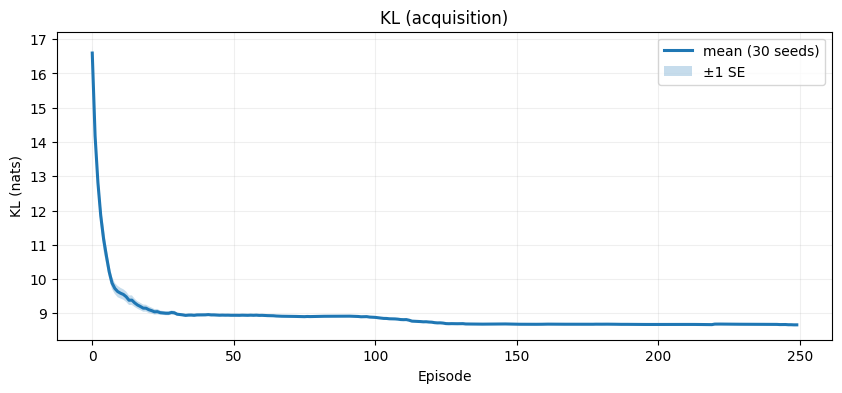

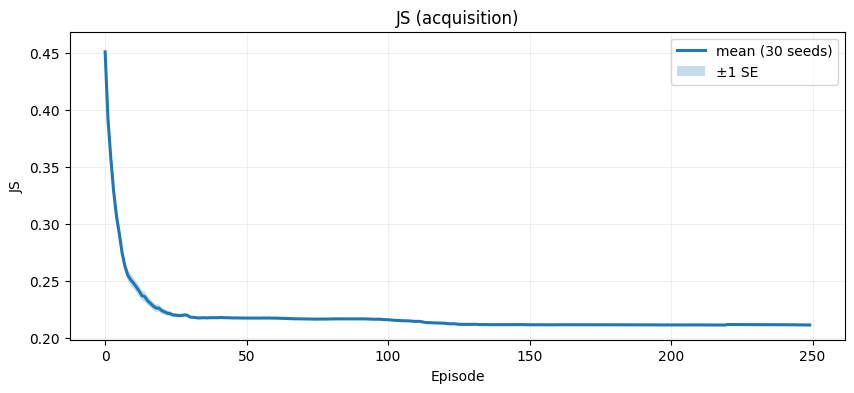

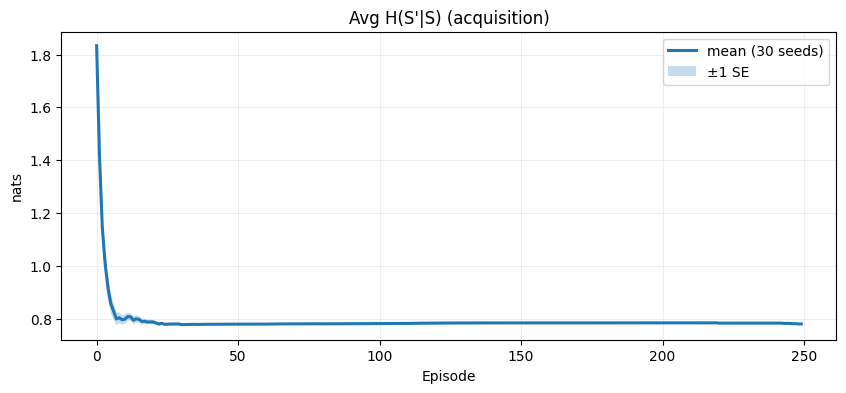

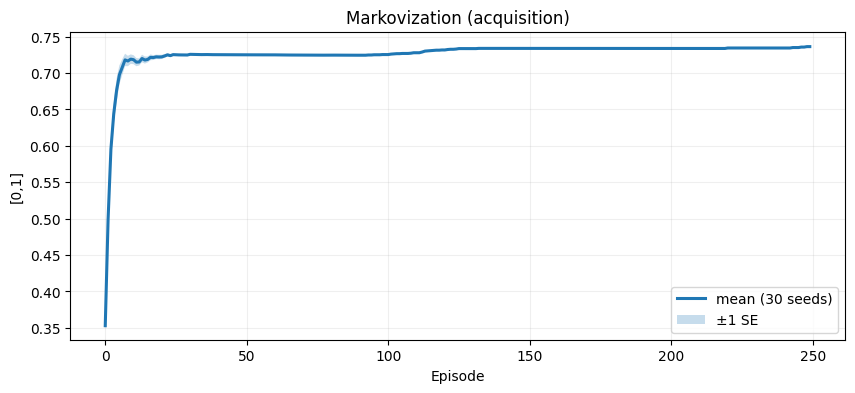

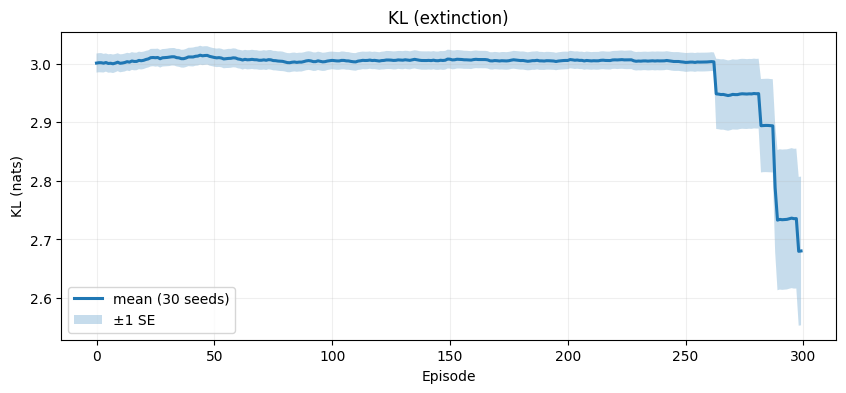

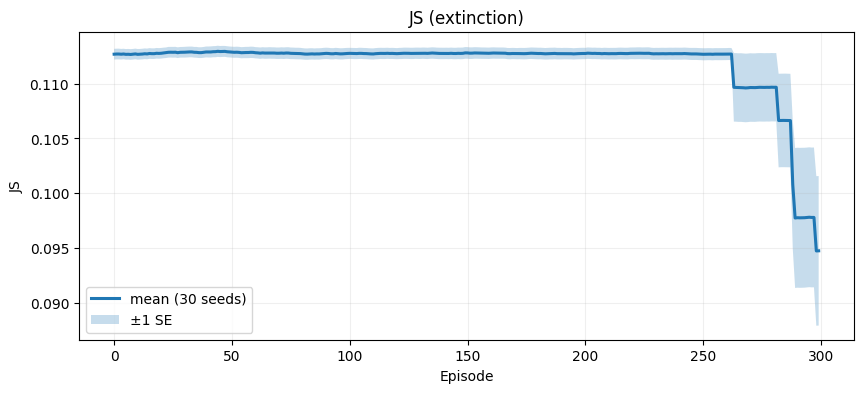

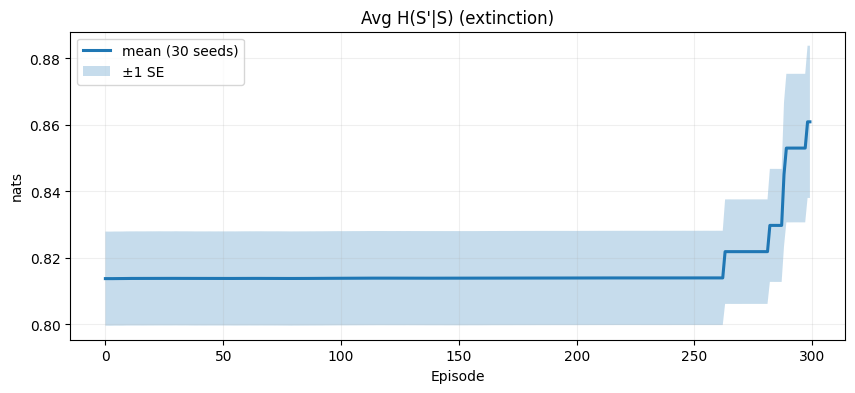

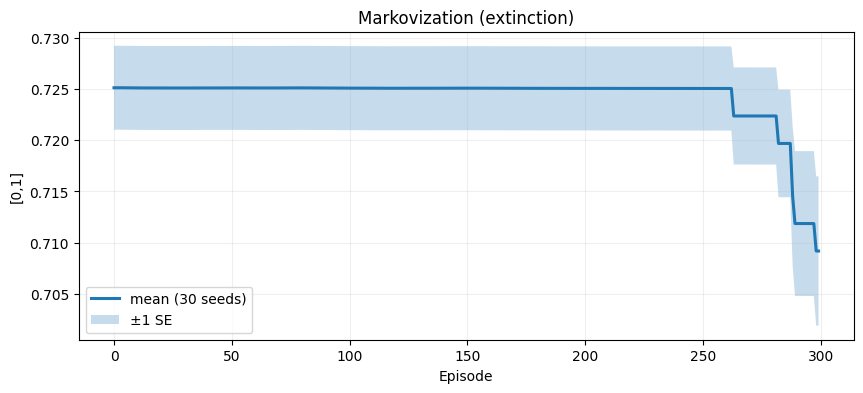

In [17]:

def plot_band(y_runs, title, ylabel):
    mean, se = mean_se(y_runs)
    x = np.arange(len(mean))
    plt.plot(x, mean, lw=2.2, label=f"mean ({len(y_runs)} seeds)")
    plt.fill_between(x, mean-se, mean+se, alpha=0.25, label="±1 SE")
    plt.title(title); plt.xlabel("Episode"); plt.ylabel(ylabel); plt.legend(); plt.grid(alpha=0.2)

plt.figure(figsize=(10,4)); plot_band(KL_acq_runs, "KL (acquisition)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_acq_runs, "JS (acquisition)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_acq_runs,  "Avg H(S'|S) (acquisition)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_acq_runs, "Markovization (acquisition)", "[0,1]"); plt.show()

plt.figure(figsize=(10,4)); plot_band(KL_ext_runs, "KL (extinction)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_ext_runs, "JS (extinction)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_ext_runs,  "Avg H(S'|S) (extinction)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_ext_runs, "Markovization (extinction)", "[0,1]"); plt.show()


In [18]:

def thresh_adj(T, thr=0.3):
    """Aggregate over actions and threshold to binary adjacency."""
    A = T.sum(axis=1)   # [S,S]
    if A.ndim != 2:
        # handle empty / malformed
        return None
    return (A >= thr).astype(np.uint8)

def clone_dict_tuple(d):
    """Stable tuple view of clone mapping for change detection."""
    # sort by clone_id
    return tuple(sorted(d.items()))


In [19]:

def graph_changed(prev_T, prev_clone_map, curr_T, curr_clone_map, thr=THRESH):
    if prev_T is None:
        return True
    # shape change (e.g., clones added)
    if prev_T.shape != curr_T.shape:
        return True
    # adjacency change
    A_prev = thresh_adj(prev_T, thr=thr)
    A_curr = thresh_adj(curr_T, thr=thr)
    if A_prev is None or A_curr is None:
        return True
    if A_prev.shape != A_curr.shape:
        return True
    if np.any(A_prev != A_curr):
        return True
    # clone map change
    if prev_clone_map != curr_clone_map:
        return True
    return False


In [20]:

# --- Run loops; only plot when changed ---
with_clones = False
prev_T = None
prev_map = None
changed_episodes = []

# Acquisition
for ep in range(1, N_ACQ+1):
    if with_clones:
        (states, actions) = generate_dataset_post_augmentation(env, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
    else:
        (states, actions) = generate_dataset(env, n_episodes=1, max_steps=MAX_STEPS)[0]

    agent.update_with_episode(states, actions)
    new = agent.maybe_split()
    if new:
        with_clones = True

    T_curr = agent.get_T().copy()
    map_curr = clone_dict_tuple(env.clone_dict)

    if graph_changed(prev_T, prev_map, T_curr, map_curr, thr=THRESH):





        
        sanitize_for_plot(env, T_curr)
        env.plot_graph(T_curr, niter=ep, threshold=THRESH, save=False, savename=f'graph_ep{ep}.png')
        changed_episodes.append(ep)
        prev_T, prev_map = T_curr, map_curr

print("Changed episodes (acquisition):", changed_episodes[:20], "... total:", len(changed_episodes))


AttributeError: 'NFEnv' object has no attribute 'reset'

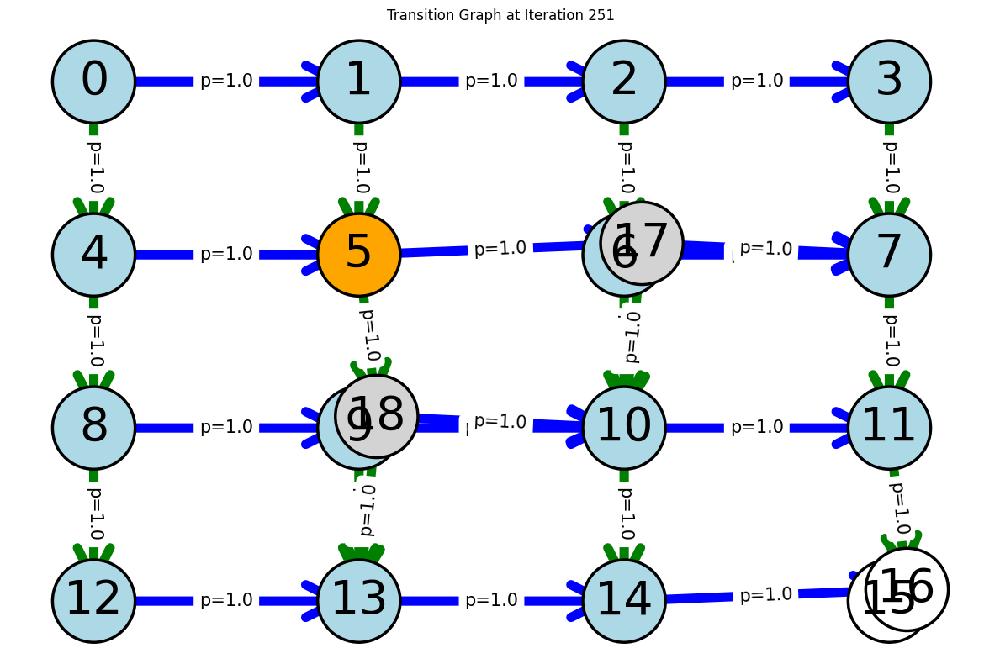

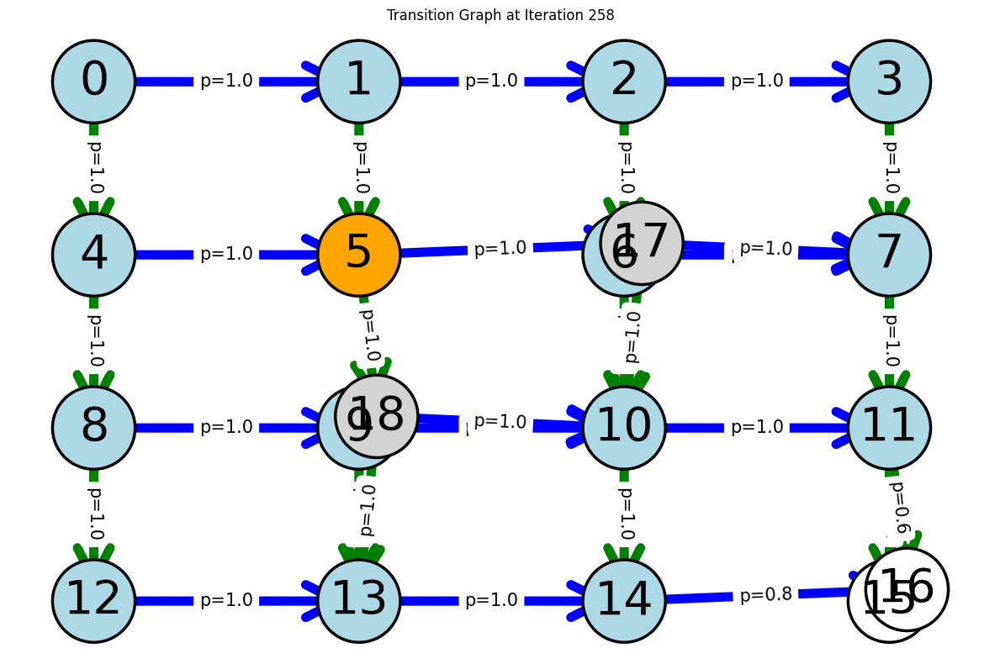

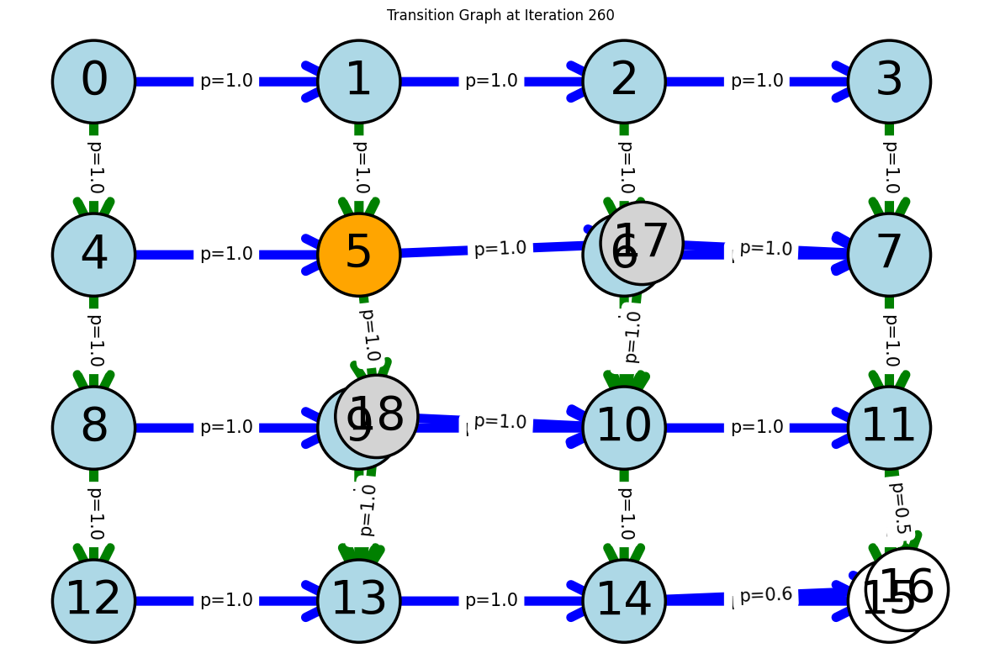

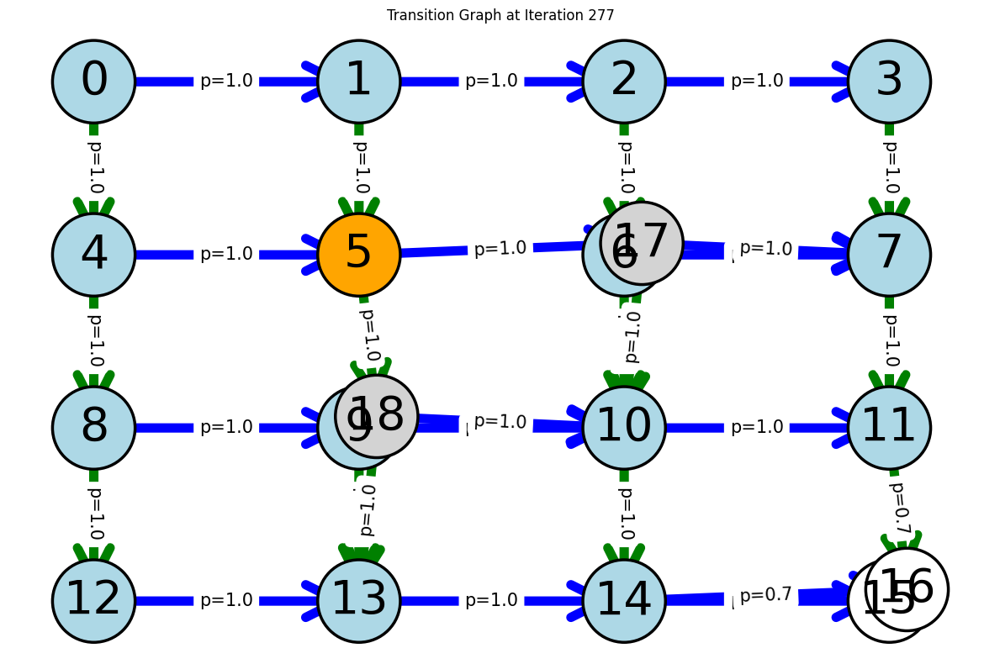

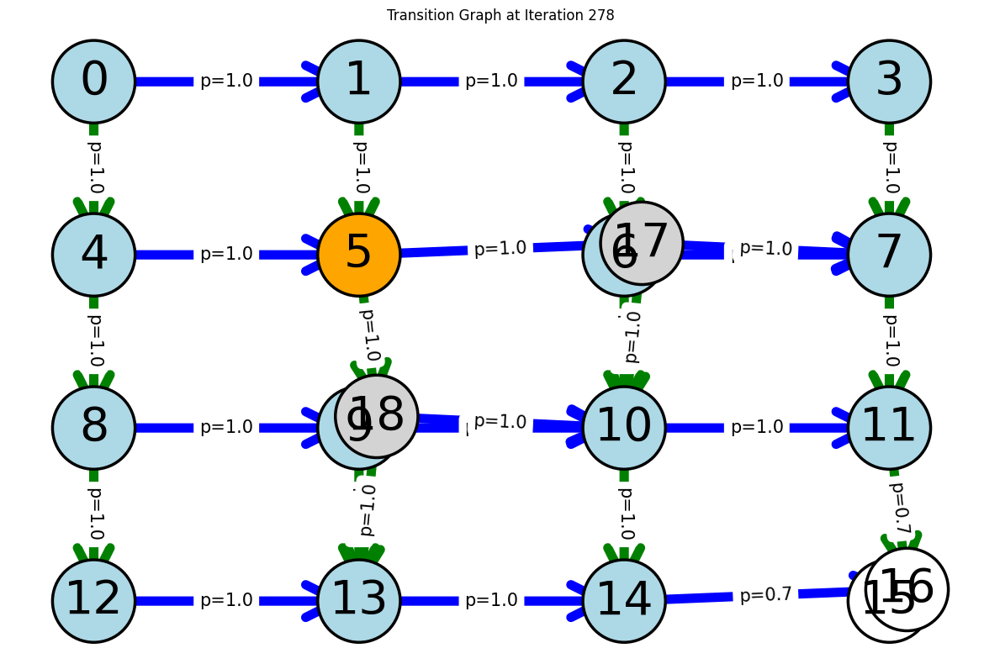

...

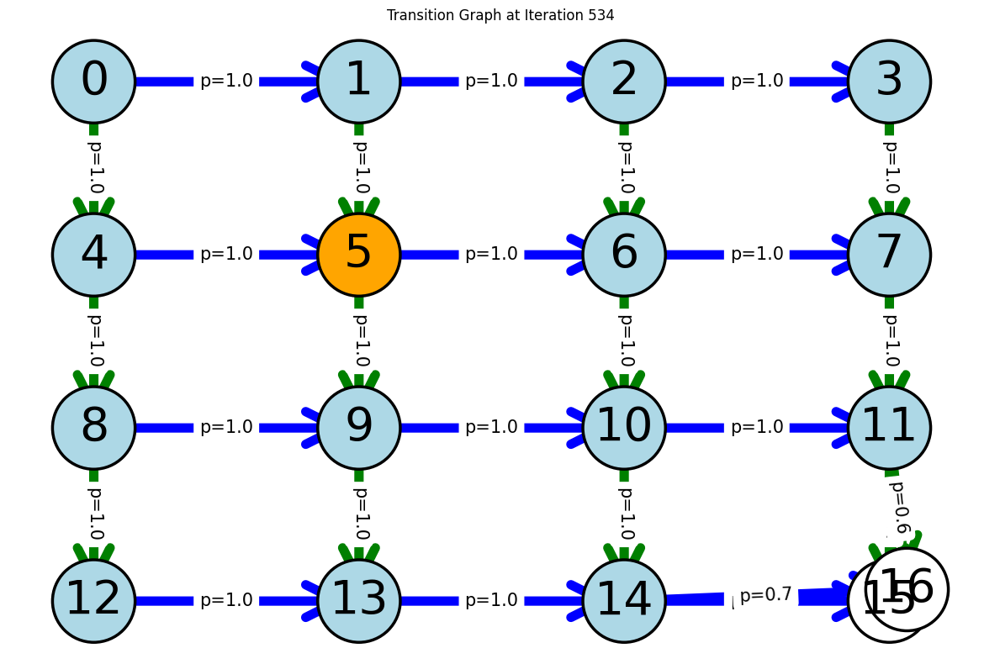

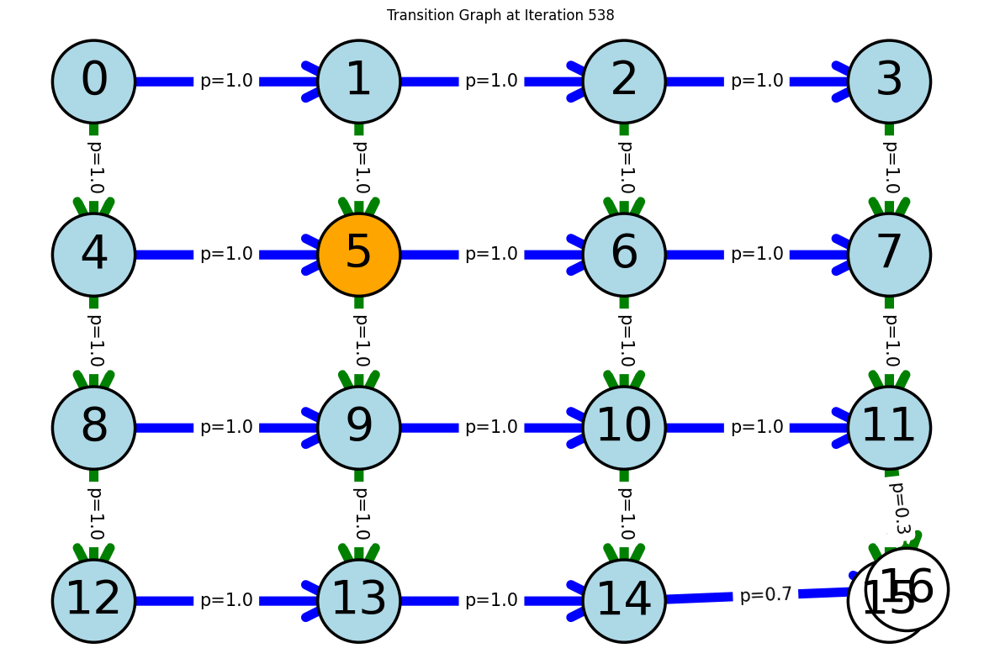

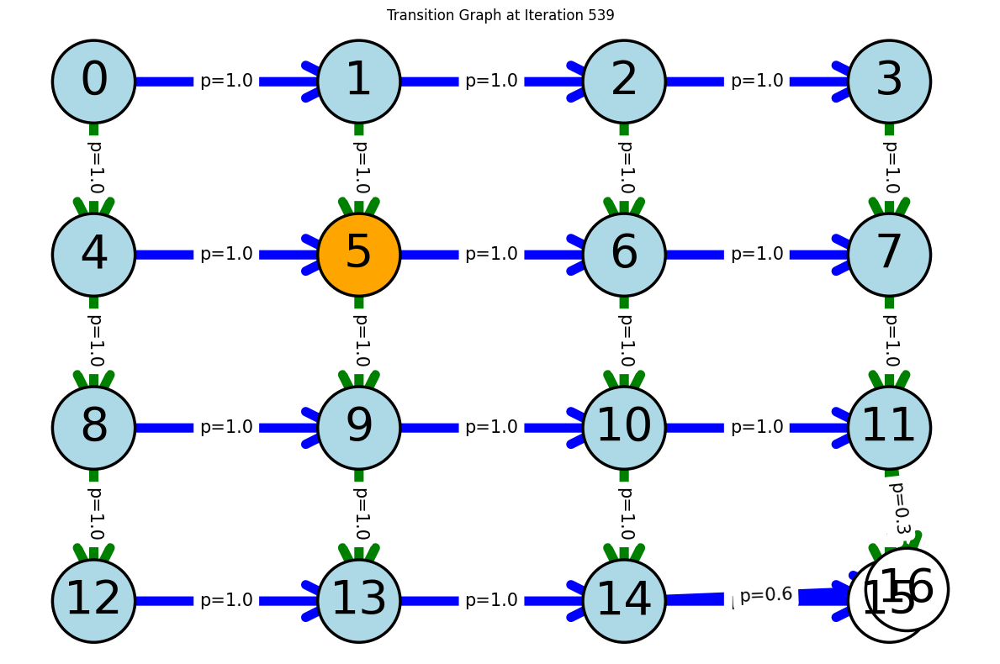

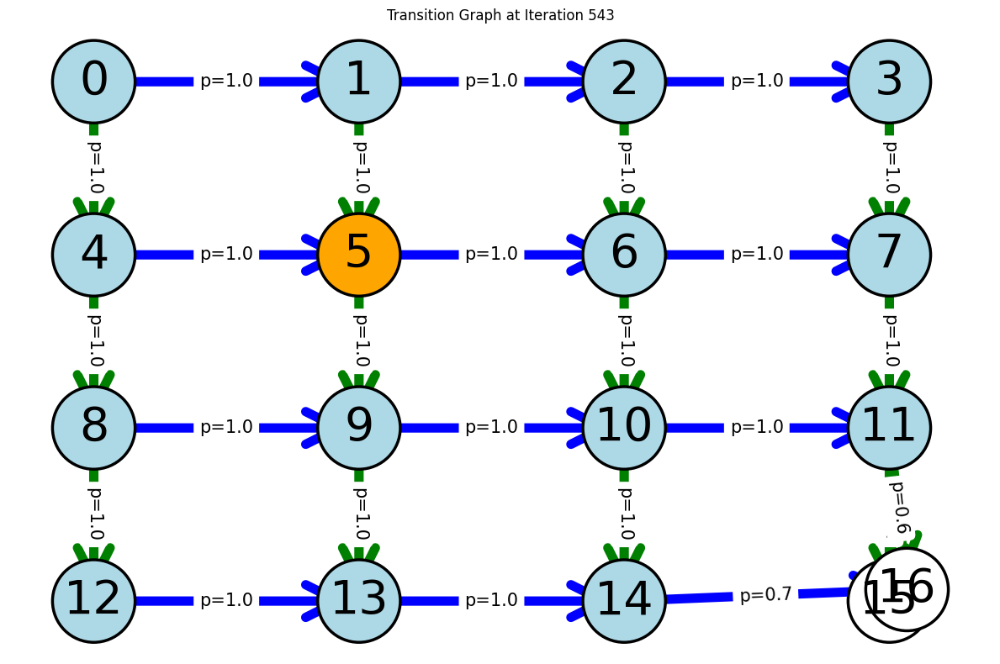

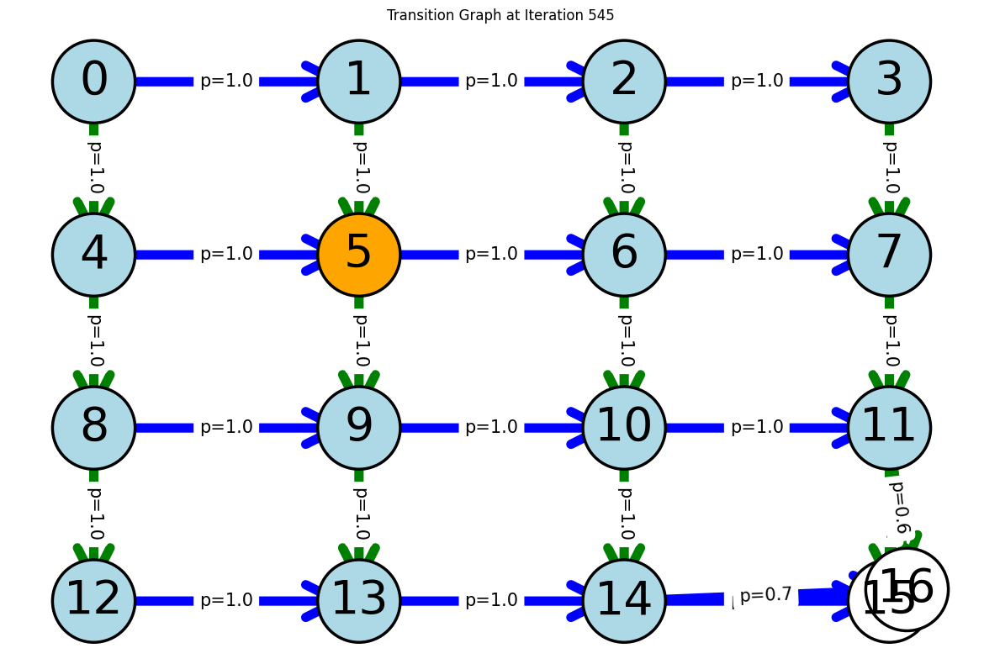

Extinction changed episodes: [251, 258, 260, 277, 278, 280, 283, 284, 289, 293, 294, 295, 297, 313, 314, 317, 319, 321, 324, 325, 329, 331, 334, 335, 338, 341, 342, 345, 354, 355] ... total: 80


In [ ]:

# Extinction / degradation
THRESH = 0.3
prev_T, prev_map = prev_T, prev_map  # reuse from acquisition if you kept them
changed_ext = []

env2 = GridEnvRightDownNoCue(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
env2.clone_dict = dict(agent.env.clone_dict)
env2.reverse_clone_dict = dict(agent.env.reverse_clone_dict)
agent.env = env2

for ep in range(N_ACQ+1, N_ACQ+N_EXT+1):
    (states, actions) = generate_dataset_post_augmentation(env2, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
    agent.update_with_episode(states, actions)
    agent.maybe_merge()

    T_curr  = agent.get_T().copy()
    map_curr = clone_dict_tuple(env2.clone_dict)

    if graph_changed(prev_T, prev_map, T_curr, map_curr, thr=THRESH):
        # (optional) clean terminals/clones just for the figure:
        T_vis = make_terminals_absorbing_for_plot(T_curr, env2.rewarded_terminals + env2.unrewarded_terminals)
        sanitize_for_plot(env2, T_vis)
        env2.plot_graph(T_vis, niter=ep, threshold=THRESH, save=False, savename=f'graph_ep{ep}.png')

        changed_ext.append(ep)
        prev_T, prev_map = T_curr, map_curr

print("Extinction changed episodes:", changed_ext[:30], "... total:", len(changed_ext))


In [ ]:
# PATCH: Fixed version that populates clone_dict for proper graph visualization
def build_gt_acquisition_with_clones(env, cue_state: int) -> np.ndarray:
    S0 = env.num_unique_states
    A  = _n_actions(env)
    T0 = _build_base_T(env)

    terminals = set(env.rewarded_terminals) | set(env.unrewarded_terminals)
    rewT = env.rewarded_terminals
    unrewT = env.unrewarded_terminals

    D = _descendants_until_terminal(env, cue_state, terminals)
    clone_of = {orig: S0 + k for k, orig in enumerate(sorted(D))}
    S = S0 + len(clone_of)
    T = np.zeros((S, A, S), dtype=float)
    T[:S0, :, :S0] = T0

    for a in env.valid_actions[cue_state]:
        sp = _base_successor(env, cue_state, a)
        if sp in D:
            T[cue_state, a, sp] = 0.0
            T[cue_state, a, clone_of[sp]] = 1.0

    for orig, cl in clone_of.items():
        for a in env.valid_actions[orig]:
            sp = _base_successor(env, orig, a)
            if sp in terminals:
                for t in rewT:   T[cl, a, t] = 1.0
                for t in unrewT: T[cl, a, t] = 0.0
            else:
                T[cl, a, clone_of[sp] if sp in clone_of else sp] = 1.0

        for a in env.valid_actions[orig]:
            sp = _base_successor(env, orig, a)
            if sp in rewT:
                T[orig, a, sp] = 0.0
                idx = rewT.index(sp)
                T[orig, a, unrewT[idx]] = 1.0
    
    # KEY FIX: Populate clone_dict so plotting overlays clones on their parent states
    for orig, cl in clone_of.items():
        env.clone_dict[cl] = orig  # Maps clone_id -> original_state_id
    env.reverse_clone_dict = {parent: cl for cl, parent in env.clone_dict.items()}
    
    return T

In [ ]:

# Collect T snapshots during acquisition and extinction.
# If you already recorded them earlier, just reuse those lists.
T_series_acq = []
T_series_ext = []

# Re-run quick pass to collect snapshots only (no plotting) -- uses your existing variables:
# Acquisition
with_clones = False
for ep in range(1, N_ACQ+1):
    if with_clones:
        (states, actions) = generate_dataset_post_augmentation(env, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
    else:
        (states, actions) = generate_dataset(env, n_episodes=1, max_steps=MAX_STEPS)[0]
    agent.update_with_episode(states, actions)
    if agent.maybe_split():
        with_clones = True
    T_series_acq.append(agent.get_T().copy())

# Extinction
env2 = GridEnvRightDownNoCue(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
env2.clone_dict = dict(getattr(env, "clone_dict", {}))
env2.reverse_clone_dict = dict(getattr(env, "reverse_clone_dict", {}))
agent.env = env2

for ep in range(N_ACQ+1, N_ACQ+N_EXT+1):
    (states, actions) = generate_dataset_post_augmentation(env2, agent.get_T(), n_episodes=1, max_steps=MAX_STEPS)[0]
    agent.update_with_episode(states, actions)
    agent.maybe_merge()
    T_series_ext.append(agent.get_T().copy())


Learned acquisition graph shape: (26, 2, 26)
Ground-truth acquisition graph shape: (24, 2, 24)
Learned extinction graph shape: (26, 2, 26)
Ground-truth extinction graph shape: (17, 2, 17)

Acquisition Comparison:
  Edge match rate: 0.976
  L1 distance (adjacency): 0.0237
  KL divergence: 0.0000

Extinction Comparison:
  Edge match rate: 0.975
  L1 distance (adjacency): 0.0221
  KL divergence: 46.6017

=== Ground-Truth (Acquisition) ===


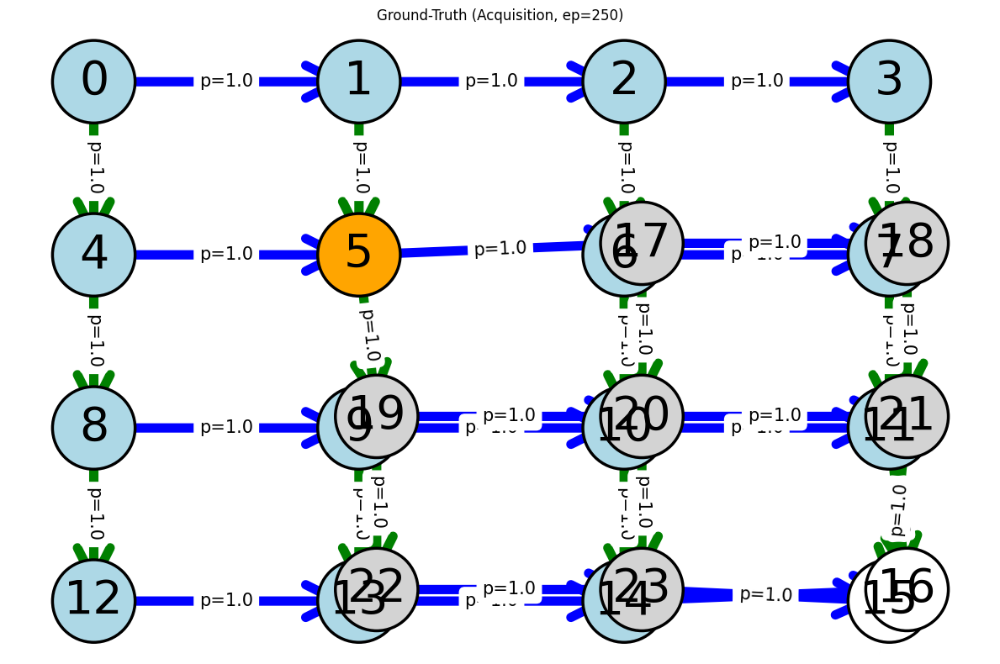


=== Learned (Acquisition) ===


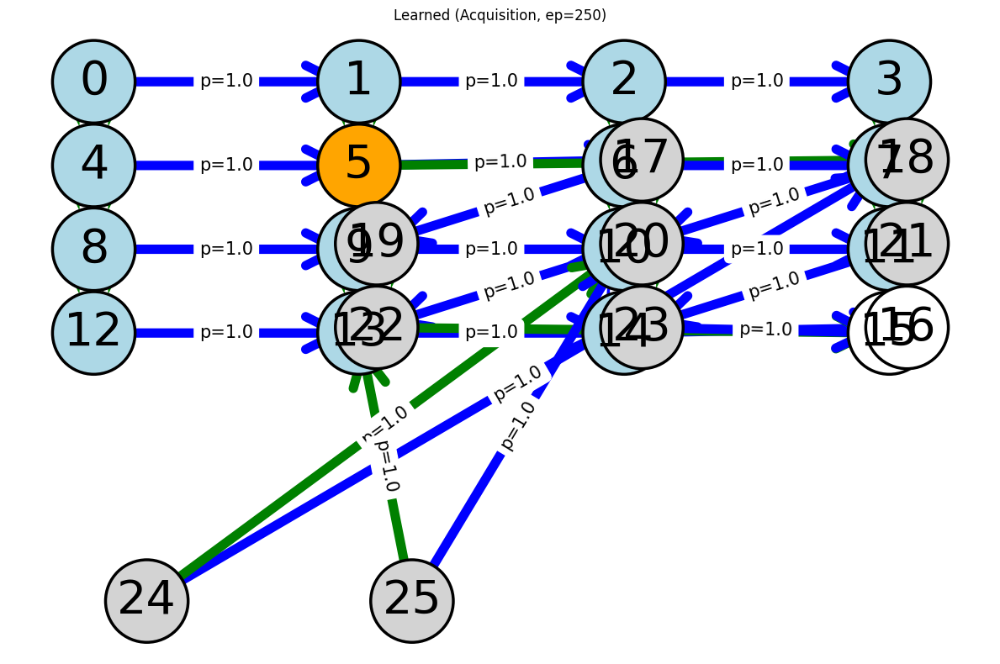


=== Ground-Truth (Extinction) ===


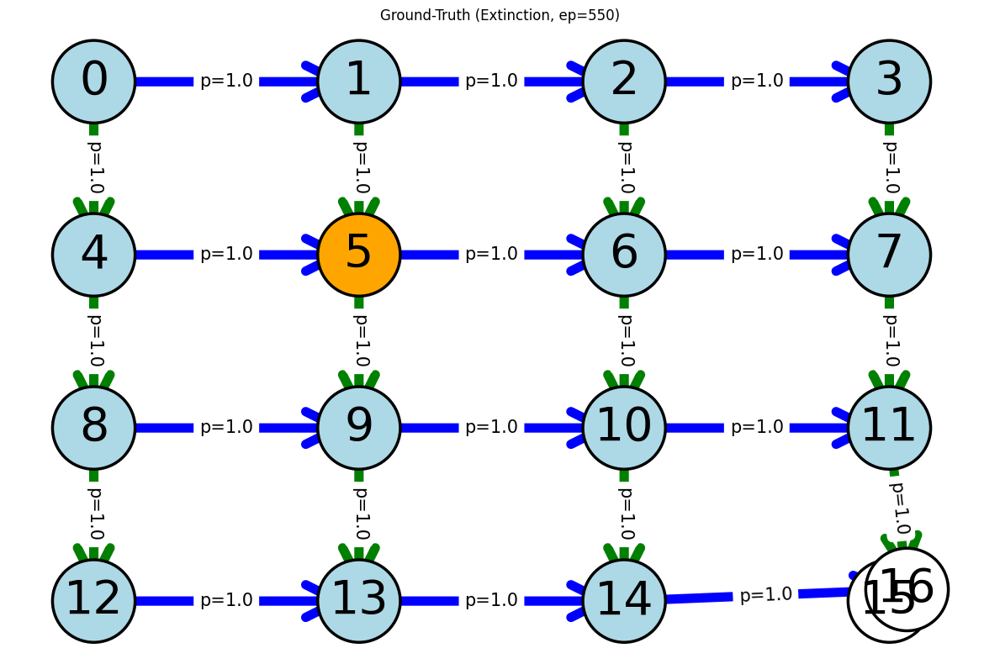


=== Learned (Extinction) ===


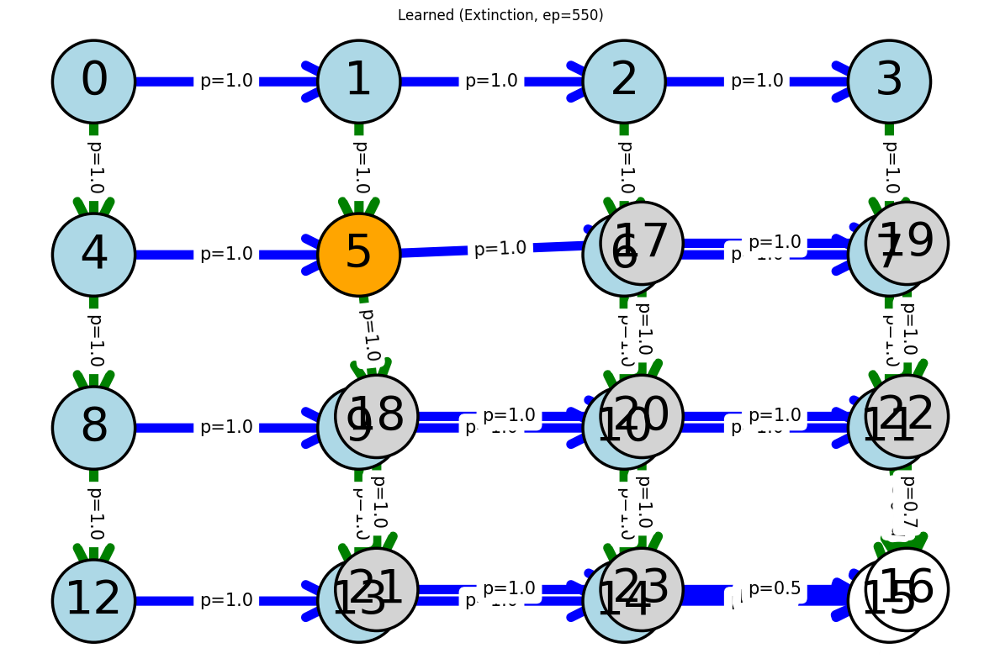

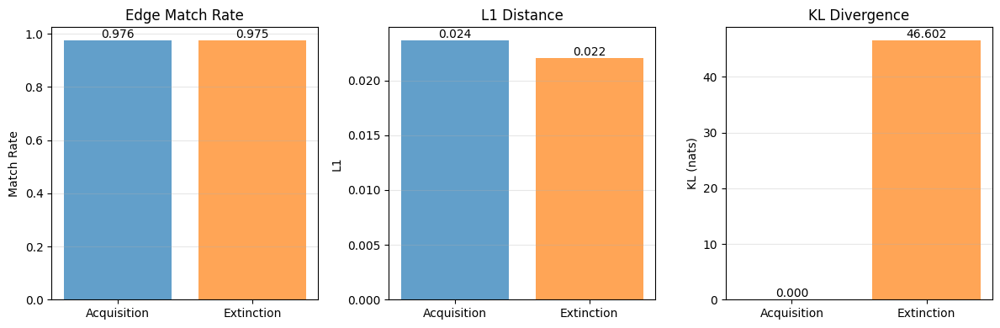

In [ ]:
# Compare learned vs ground-truth representations

# Check if T_series exist, otherwise run the data collection first
if 'T_series_acq' not in locals() or 'T_series_ext' not in locals():
    print("ERROR: Please run cell 19 first to generate T_series_acq and T_series_ext")
    print("Cell 19 is the one that starts with: # Collect T snapshots during acquisition and extinction.")
else:
    # Get final learned representations
    T_learned_acq = T_series_acq[-1].copy()
    T_learned_ext = T_series_ext[-1].copy()

    # Build ground-truth representations
    T_gt_acq = build_gt_acquisition_with_clones(env, cue_state=CUE)
    T_gt_ext = build_gt_extinction_no_clones(env2)

    print(f"Learned acquisition graph shape: {T_learned_acq.shape}")
    print(f"Ground-truth acquisition graph shape: {T_gt_acq.shape}")
    print(f"Learned extinction graph shape: {T_learned_ext.shape}")
    print(f"Ground-truth extinction graph shape: {T_gt_ext.shape}")

    # Compute comparison metrics
    def compare_graphs(T_learned, T_gt, name=""):
        # Pad to same shape if needed
        max_shape = tuple(max(s1, s2) for s1, s2 in zip(T_learned.shape, T_gt.shape))
        T_l = _pad3(T_learned, max_shape)
        T_g = _pad3(T_gt, max_shape)
        
        # Aggregate over actions for adjacency
        A_l = T_l.sum(axis=1)
        A_g = T_g.sum(axis=1)
        
        # Binary adjacency at threshold
        B_l = (A_l >= THRESH).astype(int)
        B_g = (A_g >= THRESH).astype(int)
        
        # Metrics
        edge_match = np.sum(B_l == B_g) / B_l.size
        l1_dist = np.mean(np.abs(A_l - A_g))
        kl_div = np.sum(np.where((A_g > 0) & (A_l > 0), 
                                 A_g * np.log((A_g + 1e-10) / (A_l + 1e-10)), 0))
        
        print(f"\n{name} Comparison:")
        print(f"  Edge match rate: {edge_match:.3f}")
        print(f"  L1 distance (adjacency): {l1_dist:.4f}")
        print(f"  KL divergence: {kl_div:.4f}")
        
        return {"edge_match": edge_match, "l1": l1_dist, "kl": kl_div}

    metrics_acq = compare_graphs(T_learned_acq, T_gt_acq, "Acquisition")
    metrics_ext = compare_graphs(T_learned_ext, T_gt_ext, "Extinction")

    # Visualize learned vs ground-truth (separate figures)
    
    # Acquisition: Ground-truth
    # print("\n=== Ground-Truth (Acquisition) ===")
    # T_vis_gt_acq = make_terminals_absorbing_for_plot(T_gt_acq, env.rewarded_terminals + env.unrewarded_terminals)
    # env_temp = GridEnvRightDownNoSelf(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
    # env_temp.plot_graph(T_vis_gt_acq, niter=N_ACQ, threshold=THRESH, save=False)
    # plt.title(f"Ground-Truth (Acquisition, ep={N_ACQ})", fontsize=12, fontweight='bold')
    # plt.show()

    # Acquisition: Ground-truth
    print("\n=== Ground-Truth (Acquisition) ===")
    T_vis_gt_acq = make_terminals_absorbing_for_plot(T_gt_acq, env.rewarded_terminals + env.unrewarded_terminals)
    env_temp = GridEnvRightDownNoSelf(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
    env_temp.clone_dict = dict(env.clone_dict)  # ADD THIS LINE
    env_temp.reverse_clone_dict = dict(env.reverse_clone_dict)  # ADD THIS LINE TOO
    env_temp.plot_graph(T_vis_gt_acq, niter=N_ACQ, threshold=THRESH, save=False, title=f"Ground-Truth (Acquisition, ep={N_ACQ})")
    plt.show()

    # Acquisition: Learned
    print("\n=== Learned (Acquisition) ===")
    T_vis_learned_acq = make_terminals_absorbing_for_plot(T_learned_acq, env.rewarded_terminals + env.unrewarded_terminals)
    sanitize_for_plot(env, T_vis_learned_acq)
    env.plot_graph(T_vis_learned_acq, niter=N_ACQ, threshold=THRESH, save=False, title=f"Learned (Acquisition, ep={N_ACQ})")
    plt.show()

    # Extinction: Ground-truth
    print("\n=== Ground-Truth (Extinction) ===")
    T_vis_gt_ext = make_terminals_absorbing_for_plot(T_gt_ext, env2.rewarded_terminals + env2.unrewarded_terminals)
    env2_temp = GridEnvRightDownNoCue(cue_states=[CUE], env_size=(4,4), rewarded_terminal=[15])
    env2_temp.clone_dict = dict(env2.clone_dict)  # ADD THIS LINE
    env2_temp.reverse_clone_dict = dict(env2.reverse_clone_dict)  # ADD THIS LINE TOO
    env2_temp.plot_graph(T_vis_gt_ext, niter=N_ACQ+N_EXT, threshold=THRESH, save=False, title=f"Ground-Truth (Extinction, ep={N_ACQ+N_EXT})")
    plt.show()



    # Extinction: Learned
    print("\n=== Learned (Extinction) ===")
    T_vis_learned_ext = make_terminals_absorbing_for_plot(T_learned_ext, env2.rewarded_terminals + env2.unrewarded_terminals)
    sanitize_for_plot(env2, T_vis_learned_ext)
    env2.plot_graph(T_vis_learned_ext, niter=N_ACQ+N_EXT, threshold=THRESH, save=False, title=f"Learned (Extinction, ep={N_ACQ+N_EXT})")
    plt.show()

    # Plot comparison metrics as bar charts
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))

    metrics_list = ['edge_match', 'l1', 'kl']
    titles = ['Edge Match Rate', 'L1 Distance', 'KL Divergence']
    ylabels = ['Match Rate', 'L1', 'KL (nats)']

    for idx, (metric, title, ylabel) in enumerate(zip(metrics_list, titles, ylabels)):
        ax = axes[idx]
        values = [metrics_acq[metric], metrics_ext[metric]]
        bars = ax.bar(['Acquisition', 'Extinction'], values, color=['#1f77b4', '#ff7f0e'], alpha=0.7)
        ax.set_ylabel(ylabel)
        ax.set_title(title)
        ax.grid(axis='y', alpha=0.3)
        
        # Add value labels on bars
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., height,
                    f'{height:.3f}', ha='center', va='bottom')

    plt.tight_layout()
    plt.show()

# Now, degradation and latent inhibition

In [ ]:
# Always-reward variant: terminal delivers reward regardless of cue/history
class GridEnvRightDownAlwaysReward(GridEnvRightDownNoSelf):
    def step(self, action):
        # Use base dynamics to compute next state & done flag
        ns, _, done = super().step(action)
        # Force reward at terminal regardless of visited_cue
        if done and hasattr(self, "is_terminal") and self.is_terminal(ns):
            return ns, 1, True
        return ns, 0, done

In [ ]:
# ==========================================================
# Analytic ground-truth builders (ACQUISITION / EXTINCTION / DEGRADATION)
# ==========================================================
import numpy as np

def _base_T_from_env(env):
    """
    Deterministic [S, A, S] from grid geometry (no clones).
    Assumes env.valid_actions, env.state_to_pos, env.pos_to_state, env.base_actions are defined.
    Terminals are set absorbing (no outgoing mass).
    """
    S = int(env.num_unique_states)
    A = max(a for acts in env.valid_actions.values() for a in acts) + 1 if env.valid_actions else 0
    T = np.zeros((S, A, S), dtype=float)

    # deterministic right/down moves
    for s, acts in env.valid_actions.items():
        for a in acts:
            i, j = env.state_to_pos[s]
            di, dj = env.base_actions[a]
            ni, nj = i + di, j + dj
            sp = env.pos_to_state[(ni, nj)]
            T[s, a, sp] = 1.0

    # terminals absorbing
    for t in (env.rewarded_terminals + env.unrewarded_terminals):
        if 0 <= t < S:
            T[t, :, :] = 0.0
    return T

def gt_acquisition_with_clones(env, cue_states):
    """
    Acquisition GT: Markovian map created by cloning the *successors* of each cue,
    and redirecting cue->successor edges to cue->clone(successor). Clones inherit
    their parent successor's outgoing transitions.
    Returns [S_gt, A, S_gt]; S_gt >= original S.
    """
    T = _base_T_from_env(env)
    S, A, _ = T.shape
    successor_to_clone = {}

    for cue in cue_states:
        for a in env.get_valid_actions(cue):
            i, j = env.state_to_pos[cue]
            di, dj = env.base_actions[a]
            ni, nj = i + di, j + dj
            sp = env.pos_to_state[(ni, nj)]

            # reuse clone if this successor already cloned
            if sp in successor_to_clone:
                cl = successor_to_clone[sp]
            else:
                cl = S
                S += 1
                # grow T by 1 state (pad last axis and first axis consistently)
                T = np.pad(T, ((0,1),(0,0),(0,1)), mode='constant')
                # clone inherits outgoing from parent successor (NOTE: parent row is in old slice [:, :S-1])
                T[cl, :, :T.shape[2]-1] = T[sp, :, :T.shape[2]-1]
                successor_to_clone[sp] = cl

            # redirect cue->sp to cue->cl
            mass = T[cue, a, sp]
            T[cue, a, sp] = 0.0
            T[cue, a, cl] = mass

    # terminals absorbing (safety)
    for t in (env.rewarded_terminals + env.unrewarded_terminals):
        if 0 <= t < T.shape[0]:
            T[t, :, :] = 0.0
    return T

def gt_extinction_no_clones(env2):
    """
    Extinction GT: no clones; terminal transitions *always* go to the NON-reward terminal.
    We redirect any incoming mass to rewarded terminal -> unrewarded terminal.
    """
    T = _base_T_from_env(env2)
    # map rewarded terminal(s) to paired unrewarded terminal(s)
    for idx, rt in enumerate(env2.rewarded_terminals):
        if idx < len(env2.unrewarded_terminals):
            nt = env2.unrewarded_terminals[idx]
            mask = T[:, :, rt] > 0
            T[:, :, nt][mask] = T[:, :, rt][mask]
            T[:, :, rt][mask] = 0.0
    return T

def gt_degradation_no_clones(env_always_reward):
    """
    Contingency degradation GT: reward is given regardless of cue/history.
    Structural GT is simply the base right/down graph with terminals absorbing (no clones).
    """
    return _base_T_from_env(env_always_reward)

# ------------------------------------------
# Backwards compatibility: provide 'build_*' names
# so existing code that calls build_gt_* keeps working.
# ------------------------------------------
def build_gt_acquisition_with_clones(env, cue_state):
    return gt_acquisition_with_clones(env, cue_states=[cue_state])

def build_gt_extinction_no_clones(env2):
    return gt_extinction_no_clones(env2)

def build_gt_degradation_no_clones(env_always_reward):
    return gt_degradation_no_clones(env_always_reward)

In [ ]:
def gt_degradation_no_clones(env_always_reward):
    """
    Degradation GT: no clones; transitions are the base right/down grid transitions.
    Reward is always delivered at the (rewarded) terminal, but that does not change the
    transition *structure*, so this is simply the base graph without clones.
    """
    T = base_T_from_env(env_always_reward)
    # Terminals have no outgoing edges; incoming edges unchanged (deterministic).
    return T

In [ ]:
def run_latent_inhibition_seed(seed:int,
                               cfg:CoDAConfig,
                               pre_episodes:int = 500,
                               acq_episodes:int = 1000,
                               max_steps:int = 20,
                               cue:int = 5):
    """
    Phase 1 (pre-exposure):  no reward (extinction-like) to inflate P(US & ~CS)
    Phase 2 (acquisition):   normal cued task; splitting should be delayed
    Metrics are computed across the entire run vs. the acquisition GT-with-clones.
    References: paper pp. 3–4, Fig. 3b; Methods p.8 (protocol & rationale).  [oai_citation:1‡Learning_the_structure_of_aliased_state_spaces_in_non_Markovian_tasks (1).pdf](sediment://file_00000000335c722fbbd1dce642c2838e)
    """
    np.random.seed(seed)

    # -------- Pre-exposure (no reward) --------
    env_pre = GridEnvRightDownNoCue(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent   = CoDAAgent(env_pre, cfg)

    T_series = []

    for ep in range(1, pre_episodes+1):
        (states, actions) = generate_dataset(env_pre, n_episodes=1, max_steps=max_steps)[0]
        agent.update_with_episode(states, actions)
        # No splitting expected (no US); still collect T
        T_series.append(agent.get_T().copy())

    # -------- Acquisition (normal cued task) --------
    env_acq = GridEnvRightDownNoSelf(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent.env = env_acq  # keep uncertainty/accumulators; switch to cued env

    with_clones = False
    for ep in range(1, acq_episodes+1):
        if with_clones:
            (states, actions) = generate_dataset_post_augmentation(env_acq, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        else:
            (states, actions) = generate_dataset(env_acq, n_episodes=1, max_steps=max_steps)[0]

        agent.update_with_episode(states, actions)
        new = agent.maybe_split()
        if new:
            with_clones = True

        T_series.append(agent.get_T().copy())

    # GT for latent inhibition evaluation: acquisition graph with clones
    T_ref = gt_acquisition_with_clones(env_acq, cue_states=[cue])

    # Metrics over time (full series vs acquisition GT)
    KL = kl_over_time_fixed(T_series, T_ref, use_js=False)
    JS = kl_over_time_fixed(T_series, T_ref, use_js=True)
    H  = entropy_over_time(T_series)
    MS = np.array([markovization_score(T) for T in T_series])

    return dict(T_series=T_series, T_ref=T_ref, KL=KL, JS=JS, H=H, MS=MS)

In [ ]:
def run_contingency_degradation_seed(seed:int,
                                     cfg:CoDAConfig,
                                     acq_episodes:int = 1000,
                                     degr_episodes:int = 1000,
                                     max_steps:int = 20,
                                     cue:int = 5,
                                     wash_in:int = 50,
                                     edge_eps_early:float = 1e-4,
                                     edge_eps_late:float  = 1e-6):
    """
    Phase 1 (acquisition):      normal cued task (splits form).
    Phase 2 (degradation):      reward at terminal regardless of cue/history (always reward).
                                RC falls while PC~1, so clones should merge.
    We report metrics separately for acq (vs acq GT-with-clones) and degr (vs degr GT no-clones).
    References: paper p.4 (Contingency degradation; Eq. 3); Methods p.8.  [oai_citation:2‡Learning_the_structure_of_aliased_state_spaces_in_non_Markovian_tasks (1).pdf](sediment://file_00000000335c722fbbd1dce642c2838e)
    """
    np.random.seed(seed)

    # -------- Acquisition --------
    env_acq = GridEnvRightDownNoSelf(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent   = CoDAAgent(env_acq, cfg)

    T_series_acq = []
    with_clones = False

    for ep in range(1, acq_episodes+1):
        if with_clones:
            (states, actions) = generate_dataset_post_augmentation(env_acq, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        else:
            (states, actions) = generate_dataset(env_acq, n_episodes=1, max_steps=max_steps)[0]

        agent.update_with_episode(states, actions)
        if agent.maybe_split():
            with_clones = True

        T_series_acq.append(agent.get_T().copy())

    T_ref_acq = gt_acquisition_with_clones(env_acq, cue_states=[cue])

    # -------- Degradation (always reward; no reset) --------
    env_deg = GridEnvRightDownAlwaysReward(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    # carry learned clones into degradation env so merges are meaningful
    env_deg.clone_dict = dict(getattr(env_acq, "clone_dict", {}))
    env_deg.reverse_clone_dict = dict(getattr(env_acq, "reverse_clone_dict", {}))
    agent.env = env_deg

    # short wash-in to encourage structural merges early (optional)
    orig = dict(count_decay=agent.cfg.count_decay, trace_decay=agent.cfg.trace_decay, retro_decay=agent.cfg.retro_decay,
                theta_merge=agent.cfg.theta_merge, confidence=agent.cfg.confidence,
                min_presence_episodes=agent.cfg.min_presence_episodes,
                min_effective_exposure=agent.cfg.min_effective_exposure)

    agent.cfg.count_decay = 0.98
    agent.cfg.trace_decay = 0.98
    agent.cfg.retro_decay = 0.98
    agent.cfg.theta_merge = 0.60
    agent.cfg.confidence  = 0.99
    agent.cfg.min_presence_episodes += 3
    agent.cfg.min_effective_exposure = int(agent.cfg.min_effective_exposure * 1.5)

    T_series_deg = []
    for k in range(degr_episodes):
        (states, actions) = generate_dataset_post_augmentation(env_deg, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        agent.update_with_episode(states, actions)
        agent._edge_eps_override = edge_eps_early if k < wash_in else edge_eps_late
        agent.maybe_merge()
        T_series_deg.append(agent.get_T().copy())

        if k == wash_in - 1:
            # restore original cfg after wash-in
            for key, val in orig.items():
                setattr(agent.cfg, key, val)

    T_ref_deg = gt_degradation_no_clones(env_deg)

    # Metrics (separate for each phase)
    KL_acq = kl_over_time_fixed(T_series_acq, T_ref_acq, use_js=False)
    JS_acq = kl_over_time_fixed(T_series_acq, T_ref_acq, use_js=True)
    H_acq  = entropy_over_time(T_series_acq)
    MS_acq = np.array([markovization_score(T) for T in T_series_acq])

    KL_deg = kl_over_time_fixed(T_series_deg, T_ref_deg, use_js=False)
    JS_deg = kl_over_time_fixed(T_series_deg, T_ref_deg, use_js=True)
    H_deg  = entropy_over_time(T_series_deg)
    MS_deg = np.array([markovization_score(T) for T in T_series_deg])

    return dict(
        env_acq=env_acq, env_deg=env_deg,
        T_series_acq=T_series_acq, T_series_deg=T_series_deg,
        T_ref_acq=T_ref_acq, T_ref_deg=T_ref_deg,
        KL_acq=KL_acq, JS_acq=JS_acq, H_acq=H_acq, MS_acq=MS_acq,
        KL_deg=KL_deg, JS_deg=JS_deg, H_deg=H_deg, MS_deg=MS_deg
    )

In [ ]:
# -------- Latent inhibition: multi-seed --------
def run_latent_inhibition_many(cfg:CoDAConfig,
                               seeds:list,
                               pre_episodes:int=500,
                               acq_episodes:int=1000,
                               max_steps:int=20,
                               cue:int=5):
    runs = [run_latent_inhibition_seed(s, cfg, pre_episodes, acq_episodes, max_steps, cue) for s in seeds]
    KL_runs = [r["KL"] for r in runs]
    JS_runs = [r["JS"] for r in runs]
    H_runs  = [r["H"]  for r in runs]
    MS_runs = [r["MS"] for r in runs]
    return dict(runs=runs, KL=KL_runs, JS=JS_runs, H=H_runs, MS=MS_runs)

def plot_latent_inhibition_summary(res_li, pre_episodes:int, title_suffix=""):
    plot_band(res_li["KL"], f"KL (latent inhibition{title_suffix})", "KL (nats)")
    plot_band(res_li["JS"], f"JS (latent inhibition{title_suffix})", "JS")
    plot_band(res_li["H"],  f"Avg H(S'|S) (latent inhibition{title_suffix})", "nats")
    plot_band(res_li["MS"], f"Markovization (latent inhibition{title_suffix})", "[0,1]")
    # vertical line to show transition from pre-exposure to acquisition
    for fig_num in plt.get_fignums()[-4:]:
        plt.figure(fig_num)
        plt.axvline(pre_episodes, ls="--", alpha=0.4)

# -------- Degradation: multi-seed --------
def run_degradation_many(cfg:CoDAConfig,
                         seeds:list,
                         acq_episodes:int=1000,
                         degr_episodes:int=1000,
                         max_steps:int=20,
                         cue:int=5):
    runs = [run_contingency_degradation_seed(s, cfg, acq_episodes, degr_episodes, max_steps, cue) for s in seeds]
    return dict(
        runs=runs,
        KL_acq=[r["KL_acq"] for r in runs], JS_acq=[r["JS_acq"] for r in runs],
        H_acq=[r["H_acq"] for r in runs],   MS_acq=[r["MS_acq"] for r in runs],
        KL_deg=[r["KL_deg"] for r in runs], JS_deg=[r["JS_deg"] for r in runs],
        H_deg=[r["H_deg"] for r in runs],   MS_deg=[r["MS_deg"] for r in runs],
    )

def plot_degradation_summary(res_deg, title_suffix=""):
    plot_band(res_deg["KL_acq"], f"KL (acquisition — degradation runs{title_suffix})", "KL (nats)")
    plot_band(res_deg["JS_acq"], f"JS (acquisition — degradation runs{title_suffix})", "JS")
    plot_band(res_deg["H_acq"],  f"Avg H(S'|S) (acquisition — degradation runs{title_suffix})", "nats")
    plot_band(res_deg["MS_acq"], f"Markovization (acquisition — degradation runs{title_suffix})", "[0,1]")

    plot_band(res_deg["KL_deg"], f"KL (contingency degradation{title_suffix})", "KL (nats)")
    plot_band(res_deg["JS_deg"], f"JS (contingency degradation{title_suffix})", "JS")
    plot_band(res_deg["H_deg"],  f"Avg H(S'|S) (contingency degradation{title_suffix})", "nats")
    plot_band(res_deg["MS_deg"], f"Markovization (contingency degradation{title_suffix})", "[0,1]")

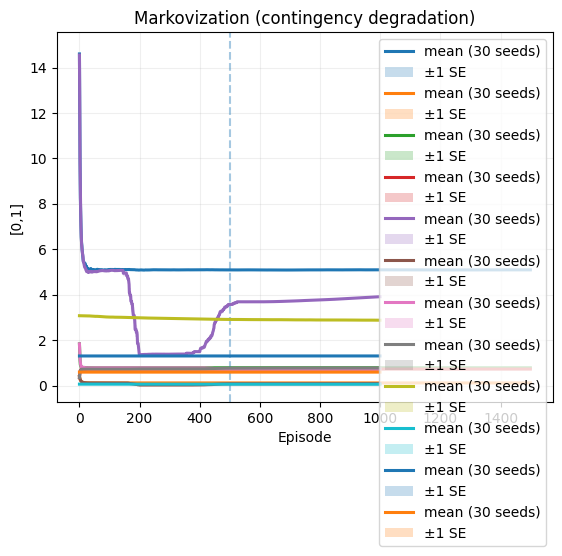

In [ ]:
# --- Parameters (paper-style) ---
N_LI_PRE = 500
N_LI_ACQ = 1000
N_CD_ACQ = 1000
N_CD_DEG = 1000
SEEDS    = list(range(30))  # 30 seeds

# Use your v2 acquisition cfg (keep it as you’ve set earlier)
cfg_li = CoDAConfig()  # latent inhibition relies on v2-like gating & uncertainty
cfg_cd = CoDAConfig()  # degradation uses same; merges depend on retrospective fall

# -------- Latent inhibition --------
res_li = run_latent_inhibition_many(cfg_li, SEEDS, pre_episodes=N_LI_PRE, acq_episodes=N_LI_ACQ, max_steps=MAX_STEPS, cue=CUE)
plot_latent_inhibition_summary(res_li, pre_episodes=N_LI_PRE)

# -------- Contingency degradation --------
res_deg = run_degradation_many(cfg_cd, SEEDS, acq_episodes=N_CD_ACQ, degr_episodes=N_CD_DEG, max_steps=MAX_STEPS, cue=CUE)
plot_degradation_summary(res_deg)

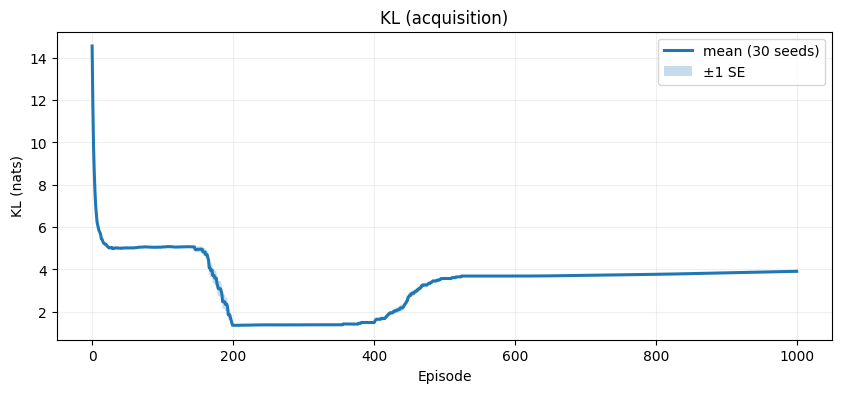

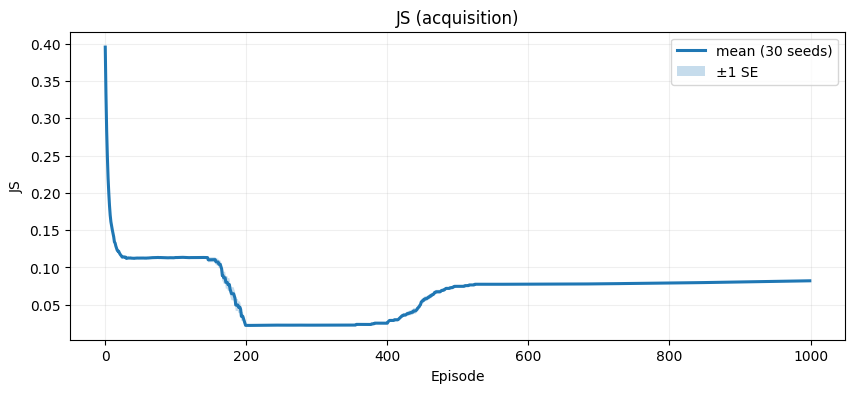

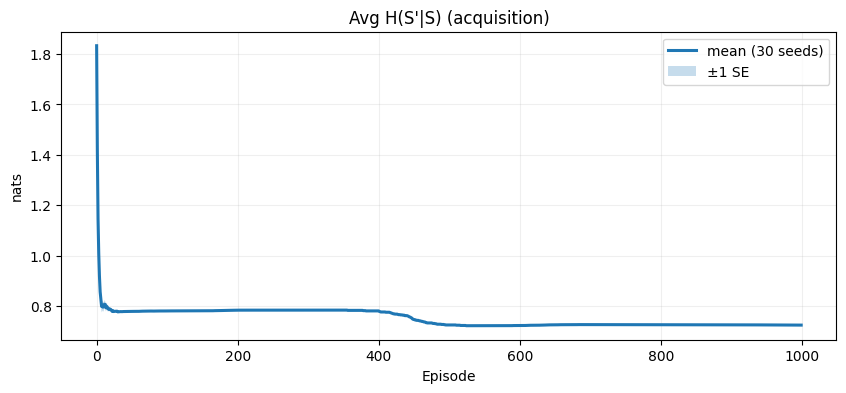

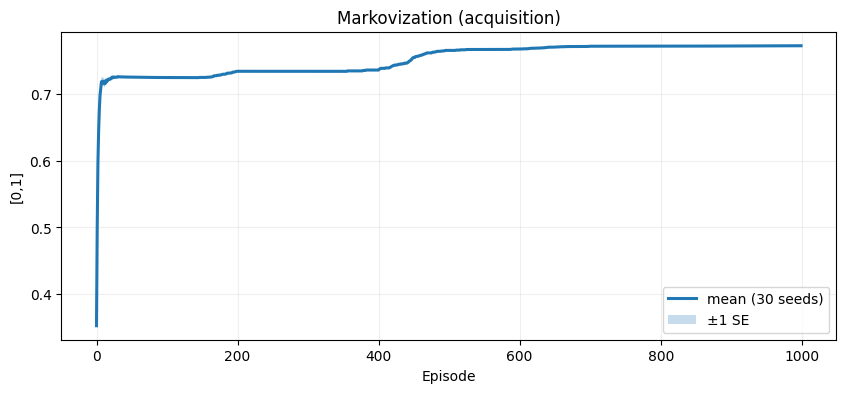

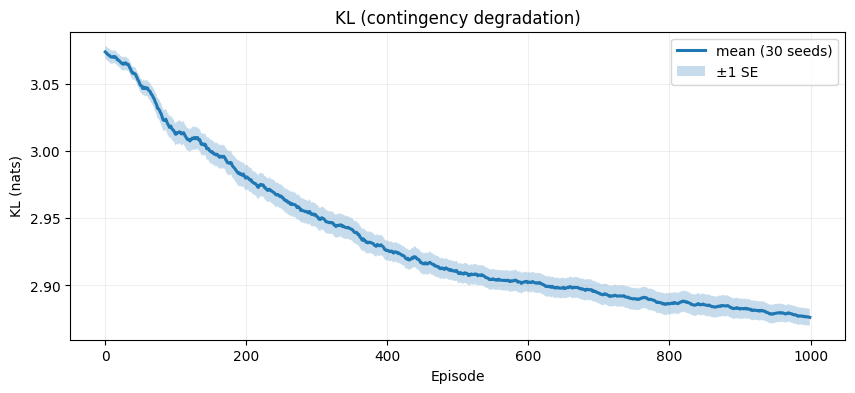

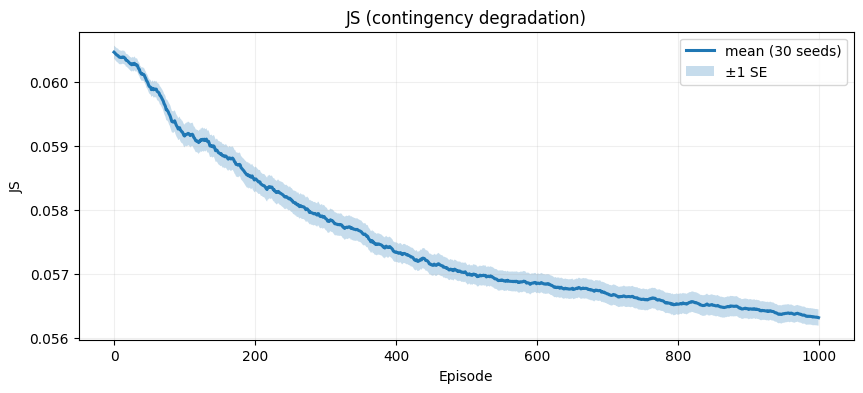

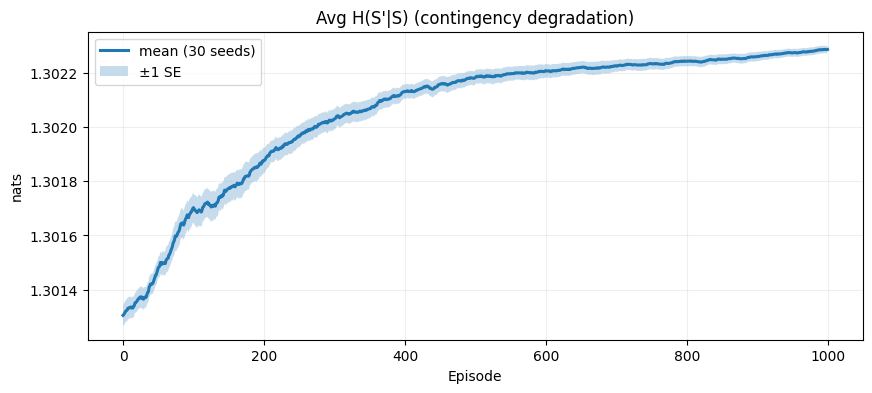

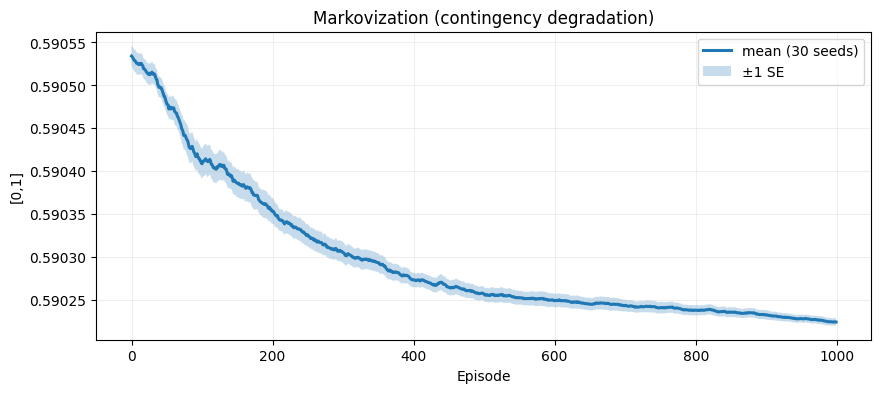

In [ ]:
# ===== Contingency degradation: plots in the same style as acquisition/extinction =====

# Unpack runs
KL_acq_runs = res_deg["KL_acq"]
JS_acq_runs = res_deg["JS_acq"]
H_acq_runs  = res_deg["H_acq"]
MS_acq_runs = res_deg["MS_acq"]

KL_deg_runs = res_deg["KL_deg"]
JS_deg_runs = res_deg["JS_deg"]
H_deg_runs  = res_deg["H_deg"]
MS_deg_runs = res_deg["MS_deg"]

# Reuse your mean±SE band helper
def mean_se(arrs):
    L = max(len(a) for a in arrs)
    M = np.full((len(arrs), L), np.nan)
    for i, a in enumerate(arrs):
        M[i, :len(a)] = a
    mean = np.nanmean(M, axis=0)
    se   = np.nanstd(M, axis=0, ddof=max(1, min(len(arrs)-1, 1))) / np.sqrt(max(1, len(arrs)))
    return mean, se

def plot_band(y_runs, title, ylabel):
    mean, se = mean_se(y_runs)
    x = np.arange(len(mean))
    plt.plot(x, mean, lw=2.2, label=f"mean ({len(y_runs)} seeds)")
    plt.fill_between(x, mean-se, mean+se, alpha=0.25, label="±1 SE")
    plt.title(title); plt.xlabel("Episode"); plt.ylabel(ylabel); plt.legend(); plt.grid(alpha=0.2)

# Acquisition portion (degradation runs, pre-switch)
plt.figure(figsize=(10,4)); plot_band(KL_acq_runs, "KL (acquisition)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_acq_runs, "JS (acquisition)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_acq_runs,  "Avg H(S'|S) (acquisition)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_acq_runs, "Markovization (acquisition)", "[0,1]"); plt.show()

# Degradation portion (post-switch)
plt.figure(figsize=(10,4)); plot_band(KL_deg_runs, "KL (contingency degradation)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_deg_runs, "JS (contingency degradation)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_deg_runs,  "Avg H(S'|S) (contingency degradation)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_deg_runs, "Markovization (contingency degradation)", "[0,1]"); plt.show()

for fig_num in plt.get_fignums()[-4:]:  # last 4 figures (degradation plots)
    plt.figure(fig_num)
    plt.axvline(N_CD_ACQ, ls="--", color="tab:cyan", alpha=0.4)

# real

In [ ]:
# ==========================================================
# Core utilities + Analytic Ground-Truth builders + Metrics
# ==========================================================
import numpy as np

# ---------------------------
# Small numeric helpers
# ---------------------------
EPS = 1e-12

def _safe_row_norm(x: np.ndarray, axis: int = -1, eps: float = EPS) -> np.ndarray:
    y = x.astype(float, copy=True)
    s = y.sum(axis=axis, keepdims=True)
    s[s < eps] = 1.0
    return y / s

def _pad3(A: np.ndarray, shape):
    """Zero-pad a [S,A,S] tensor to 'shape' without cropping."""
    S, A_, S2 = A.shape
    Sg, Ag, S2g = shape
    out = np.zeros((Sg, Ag, S2g), dtype=float)
    out[:min(S,Sg), :min(A_,Ag), :min(S2,S2g)] = A[:min(S,Sg), :min(A_,Ag), :min(S2,S2g)]
    return out

def _agg(T: np.ndarray) -> np.ndarray:
    """Aggregate over actions to get P(s'|s) as [S,S] row-stochastic."""
    P = T.sum(axis=1)
    return _safe_row_norm(P, axis=1)

def _row_kl(p: np.ndarray, q: np.ndarray, eps: float = EPS) -> float:
    p = np.clip(p, eps, 1.0); p /= p.sum()
    q = np.clip(q, eps, 1.0); q /= q.sum()
    return float(np.sum(p * (np.log(p) - np.log(q))))

def _row_js(p: np.ndarray, q: np.ndarray, eps: float = EPS) -> float:
    p = np.clip(p, eps, 1.0); p /= p.sum()
    q = np.clip(q, eps, 1.0); q /= q.sum()
    m = 0.5*(p+q)
    return 0.5*_row_kl(p, m, eps) + 0.5*_row_kl(q, m, eps)

def _row_H(p: np.ndarray, eps: float = EPS) -> float:
    p = np.clip(p, eps, 1.0); p /= p.sum()
    return float(-np.sum(p * np.log(p)))

# ---------------------------
# Deterministic base transitions from geometry
# ---------------------------
def base_T_from_env(env):
    """
    Deterministic [S, A, S] from grid geometry (no clones).
    Assumes env.valid_actions, env.state_to_pos, env.pos_to_state, env.base_actions.
    Terminals are set absorbing (no outgoing mass).
    """
    S = int(env.num_unique_states)
    A = max(a for acts in env.valid_actions.values() for a in acts) + 1 if env.valid_actions else 0
    T = np.zeros((S, A, S), dtype=float)

    for s, acts in env.valid_actions.items():
        for a in acts:
            i, j = env.state_to_pos[s]
            di, dj = env.base_actions[a]
            ni, nj = i + di, j + dj
            sp = env.pos_to_state[(ni, nj)]
            T[s, a, sp] = 1.0

    # terminals absorbing
    for t in (env.rewarded_terminals + env.unrewarded_terminals):
        if 0 <= t < S:
            T[t, :, :] = 0.0
    return T

# internal alias used by some earlier snippets
_base_T_from_env = base_T_from_env

# ---------------------------
# Analytic ground-truth builders
# ---------------------------
def gt_acquisition_with_clones(env, cue_states):
    """
    Acquisition GT: Markovian by cloning each 'successor' of the cue state(s), and
    redirecting cue->successor edges to cue->clone(successor). Clones inherit the
    parent's outgoing transitions.
    """
    T = base_T_from_env(env)
    S, A, _ = T.shape
    successor_to_clone = {}

    for cue in cue_states:
        for a in env.get_valid_actions(cue):
            i, j = env.state_to_pos[cue]
            di, dj = env.base_actions[a]
            ni, nj = i + di, j + dj
            sp = env.pos_to_state[(ni, nj)]

            if sp in successor_to_clone:
                cl = successor_to_clone[sp]
            else:
                cl = S
                S += 1
                T = np.pad(T, ((0,1),(0,0),(0,1)), mode='constant')
                # clone inherits outgoing of parent successor (into old slice)
                T[cl, :, :T.shape[2]-1] = T[sp, :, :T.shape[2]-1]
                successor_to_clone[sp] = cl

            # redirect cue->sp to cue->cl
            mass = T[cue, a, sp]
            T[cue, a, sp] = 0.0
            T[cue, a, cl] = mass

    # safety: terminals absorbing
    for t in (env.rewarded_terminals + env.unrewarded_terminals):
        if 0 <= t < T.shape[0]:
            T[t, :, :] = 0.0
    return T

def gt_extinction_no_clones(env2):
    """
    Extinction GT: no clones; any transition that would go into a rewarded terminal
    is redirected to the paired unrewarded terminal. Terminals are absorbing.
    """
    T = base_T_from_env(env2)
    for idx, rt in enumerate(env2.rewarded_terminals):
        if idx < len(env2.unrewarded_terminals):
            nt = env2.unrewarded_terminals[idx]
            mask = T[:, :, rt] > 0
            T[:, :, nt][mask] = T[:, :, rt][mask]
            T[:, :, rt][mask] = 0.0
    return T

def gt_degradation_no_clones(env_always_reward):
    """
    Contingency degradation GT: reward is given regardless of cue/history.
    Structural GT is the base right/down graph without clones; terminals absorbing.
    """
    return base_T_from_env(env_always_reward)

# Back-compat names some cells call:
def build_gt_acquisition_with_clones(env, cue_state):
    return gt_acquisition_with_clones(env, cue_states=[cue_state])

def build_gt_extinction_no_clones(env2):
    return gt_extinction_no_clones(env2)

def build_gt_degradation_no_clones(env_always_reward):
    return gt_degradation_no_clones(env_always_reward)

# ---------------------------
# Metrics (fixed reference)
# ---------------------------
def kl_over_time_fixed(T_series, T_ref_fixed, use_js: bool = False):
    """
    Row-average KL (or JS if use_js=True) between learned T_t and a fixed
    reference T_ref_fixed (both aggregated over actions). Pads shapes as needed.
    Returns 1D array with one value per episode in T_series.
    """
    scores = []
    shape = T_ref_fixed.shape
    Q = _agg(T_ref_fixed)
    for T in T_series:
        P = _agg(_pad3(T, shape))
        if use_js:
            row_vals = [_row_js(P[i], Q[i]) for i in range(P.shape[0])]
        else:
            row_vals = [_row_kl(P[i], Q[i]) for i in range(P.shape[0])]
        scores.append(float(np.mean(row_vals)))
    return np.array(scores)

def entropy_over_time(T_series):
    """Average next-state entropy H(S'|S) per episode."""
    vals = []
    for T in T_series:
        P = _agg(T)
        vals.append(float(np.mean([_row_H(P[i]) for i in range(P.shape[0])])))
    return np.array(vals)

def markovization_score(T: np.ndarray) -> float:
    """
    1 - normalized conditional entropy averaged across states.
    Returns a score in [0,1], higher = more deterministic/Markovian.
    """
    P = _agg(T)
    H = np.array([_row_H(P[i]) for i in range(P.shape[0])])
    Hmax = np.log(max(2, P.shape[1]))
    return float(1.0 - np.mean(H)/Hmax)

In [ ]:
class GridEnvRightDownAlwaysReward(GridEnvRightDownNoSelf):
    def step(self, action):
        # Use base dynamics to compute next state & done flag
        ns, _, done = super().step(action)
        # Force reward at terminal regardless of visited_cue
        if done and hasattr(self, "is_terminal") and self.is_terminal(ns):
            return ns, 1, True
        return ns, 0, done

In [ ]:
def gt_degradation_no_clones(env_always_reward):
    """
    Degradation GT: no clones; transitions are the base right/down grid transitions.
    Reward is always delivered at the (rewarded) terminal, but that does not change the
    transition *structure*, so this is simply the base graph without clones.
    """
    T = base_T_from_env(env_always_reward)
    # Terminals have no outgoing edges; incoming edges unchanged (deterministic).
    return T


In [ ]:
def run_latent_inhibition_seed(seed:int,
                               cfg:CoDAConfig,
                               pre_episodes:int = 500,
                               acq_episodes:int = 1000,
                               max_steps:int = 20,
                               cue:int = 5):
    """
    Phase 1 (pre-exposure):  no reward (extinction-like) to inflate P(US & ~CS)
    Phase 2 (acquisition):   normal cued task; splitting should be delayed
    Metrics are computed across the entire run vs. the acquisition GT-with-clones.
    References: paper pp. 3–4, Fig. 3b; Methods p.8 (protocol & rationale). :contentReference[oaicite:1]{index=1}
    """
    np.random.seed(seed)

    # -------- Pre-exposure (no reward) --------
    env_pre = GridEnvRightDownNoCue(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent   = CoDAAgent(env_pre, cfg)

    T_series = []

    for ep in range(1, pre_episodes+1):
        (states, actions) = generate_dataset(env_pre, n_episodes=1, max_steps=max_steps)[0]
        agent.update_with_episode(states, actions)
        # No splitting expected (no US); still collect T
        T_series.append(agent.get_T().copy())

    # -------- Acquisition (normal cued task) --------
    env_acq = GridEnvRightDownNoSelf(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent.env = env_acq  # keep uncertainty/accumulators; switch to cued env

    with_clones = False
    for ep in range(1, acq_episodes+1):
        if with_clones:
            (states, actions) = generate_dataset_post_augmentation(env_acq, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        else:
            (states, actions) = generate_dataset(env_acq, n_episodes=1, max_steps=max_steps)[0]

        agent.update_with_episode(states, actions)
        new = agent.maybe_split()
        if new:
            with_clones = True

        T_series.append(agent.get_T().copy())

    # GT for latent inhibition evaluation: acquisition graph with clones
    T_ref = gt_acquisition_with_clones(env_acq, cue_states=[cue])

    # Metrics over time (full series vs acquisition GT)
    KL = kl_over_time_fixed(T_series, T_ref, use_js=False)
    JS = kl_over_time_fixed(T_series, T_ref, use_js=True)
    H  = entropy_over_time(T_series)
    MS = np.array([markovization_score(T) for T in T_series])

    return dict(T_series=T_series, T_ref=T_ref, KL=KL, JS=JS, H=H, MS=MS)


In [ ]:
def run_contingency_degradation_seed(seed:int,
                                     cfg:CoDAConfig,
                                     acq_episodes:int = 1000,
                                     degr_episodes:int = 1000,
                                     max_steps:int = 20,
                                     cue:int = 5,
                                     wash_in:int = 50,
                                     edge_eps_early:float = 1e-4,
                                     edge_eps_late:float  = 1e-6):
    """
    Phase 1 (acquisition):      normal cued task (splits form).
    Phase 2 (degradation):      reward at terminal regardless of cue/history (always reward).
                                RC falls while PC~1, so clones should merge.
    We report metrics separately for acq (vs acq GT-with-clones) and degr (vs degr GT no-clones).
    References: paper p.4 (Contingency degradation; Eq. 3); Methods p.8. :contentReference[oaicite:2]{index=2}
    """
    np.random.seed(seed)

    # -------- Acquisition --------
    env_acq = GridEnvRightDownNoSelf(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    agent   = CoDAAgent(env_acq, cfg)

    T_series_acq = []
    with_clones = False

    for ep in range(1, acq_episodes+1):
        if with_clones:
            (states, actions) = generate_dataset_post_augmentation(env_acq, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        else:
            (states, actions) = generate_dataset(env_acq, n_episodes=1, max_steps=max_steps)[0]

        agent.update_with_episode(states, actions)
        new = agent.maybe_split()
        if new:
            with_clones = True

        T_curr = agent.get_T().copy()
        T_series_acq.append(T_curr)

        # === plot last iteration graph ===
        if ep == acq_episodes:
            print(f"Latent inhibition — final acquisition graph (seed {seed})")
            T_vis = make_terminals_absorbing_for_plot(T_curr, env_acq.rewarded_terminals + env_acq.unrewarded_terminals)
            sanitize_for_plot(env_acq, T_vis)
            env_acq.plot_graph(T_vis, niter=ep, threshold=0.3, save=False, title=f"Latent Inhibition — Final Graph (seed={seed})")
            plt.show()

    T_ref_acq = gt_acquisition_with_clones(env_acq, cue_states=[cue])

    # -------- Degradation (always reward; no reset) --------
    env_deg = GridEnvRightDownAlwaysReward(cue_states=[cue], env_size=(4,4), rewarded_terminal=[15])
    # carry learned clones into degradation env so merges are meaningful
    env_deg.clone_dict = dict(getattr(env_acq, "clone_dict", {}))
    env_deg.reverse_clone_dict = dict(getattr(env_acq, "reverse_clone_dict", {}))
    agent.env = env_deg

    # short wash-in to encourage structural merges early (optional)
    orig = dict(count_decay=agent.cfg.count_decay, trace_decay=agent.cfg.trace_decay, retro_decay=agent.cfg.retro_decay,
                theta_merge=agent.cfg.theta_merge, confidence=agent.cfg.confidence,
                min_presence_episodes=agent.cfg.min_presence_episodes,
                min_effective_exposure=agent.cfg.min_effective_exposure)

    agent.cfg.count_decay = 0.98
    agent.cfg.trace_decay = 0.98
    agent.cfg.retro_decay = 0.98
    agent.cfg.theta_merge = 0.60
    agent.cfg.confidence  = 0.99
    agent.cfg.min_presence_episodes += 3
    agent.cfg.min_effective_exposure = int(agent.cfg.min_effective_exposure * 1.5)

    T_series_deg = []
    for k in range(degr_episodes):
        (states, actions) = generate_dataset_post_augmentation(env_deg, agent.get_T(), n_episodes=1, max_steps=max_steps)[0]
        agent.update_with_episode(states, actions)
        agent._edge_eps_override = edge_eps_early if k < wash_in else edge_eps_late
        agent.maybe_merge()

        T_curr = agent.get_T().copy()
        T_series_deg.append(T_curr)

        # === plot last iteration graph ===
        if k == degr_episodes - 1:
            print(f"Contingency degradation — final graph (seed {seed})")
            T_vis = make_terminals_absorbing_for_plot(T_curr, env_deg.rewarded_terminals + env_deg.unrewarded_terminals)
            sanitize_for_plot(env_deg, T_vis)
            env_deg.plot_graph(T_vis, niter=k+1, threshold=0.3, save=False, title=f"Contingency Degradation — Final Graph (seed={seed})")
            # plt.title(f"Contingency Degradation — Final Graph (seed={seed})")
            plt.show()

    T_ref_deg = gt_degradation_no_clones(env_deg)

    # Metrics (separate for each phase)
    KL_acq = kl_over_time_fixed(T_series_acq, T_ref_acq, use_js=False)
    JS_acq = kl_over_time_fixed(T_series_acq, T_ref_acq, use_js=True)
    H_acq  = entropy_over_time(T_series_acq)
    MS_acq = np.array([markovization_score(T) for T in T_series_acq])

    KL_deg = kl_over_time_fixed(T_series_deg, T_ref_deg, use_js=False)
    JS_deg = kl_over_time_fixed(T_series_deg, T_ref_deg, use_js=True)
    H_deg  = entropy_over_time(T_series_deg)
    MS_deg = np.array([markovization_score(T) for T in T_series_deg])

    return dict(
        env_acq=env_acq, env_deg=env_deg,
        T_series_acq=T_series_acq, T_series_deg=T_series_deg,
        T_ref_acq=T_ref_acq, T_ref_deg=T_ref_deg,
        KL_acq=KL_acq, JS_acq=JS_acq, H_acq=H_acq, MS_acq=MS_acq,
        KL_deg=KL_deg, JS_deg=JS_deg, H_deg=H_deg, MS_deg=MS_deg
    )


In [ ]:
# -------- Latent inhibition: multi-seed --------
def run_latent_inhibition_many(cfg:CoDAConfig,
                               seeds:list,
                               pre_episodes:int=500,
                               acq_episodes:int=1000,
                               max_steps:int=20,
                               cue:int=5):
    runs = [run_latent_inhibition_seed(s, cfg, pre_episodes, acq_episodes, max_steps, cue) for s in seeds]
    KL_runs = [r["KL"] for r in runs]
    JS_runs = [r["JS"] for r in runs]
    H_runs  = [r["H"]  for r in runs]
    MS_runs = [r["MS"] for r in runs]
    return dict(runs=runs, KL=KL_runs, JS=JS_runs, H=H_runs, MS=MS_runs)

def plot_latent_inhibition_summary(res_li, pre_episodes:int, title_suffix=""):
    plot_band(res_li["KL"], f"KL (latent inhibition{title_suffix})", "KL (nats)")
    plot_band(res_li["JS"], f"JS (latent inhibition{title_suffix})", "JS")
    plot_band(res_li["H"],  f"Avg H(S'|S) (latent inhibition{title_suffix})", "nats")
    plot_band(res_li["MS"], f"Markovization (latent inhibition{title_suffix})", "[0,1]")
    # vertical line to show transition from pre-exposure to acquisition
    for fig_num in plt.get_fignums()[-4:]:
        plt.figure(fig_num)
        plt.axvline(pre_episodes, ls="--", alpha=0.4)

# -------- Degradation: multi-seed --------
def run_degradation_many(cfg:CoDAConfig,
                         seeds:list,
                         acq_episodes:int=1000,
                         degr_episodes:int=1000,
                         max_steps:int=20,
                         cue:int=5):
    runs = [run_contingency_degradation_seed(s, cfg, acq_episodes, degr_episodes, max_steps, cue) for s in seeds]
    return dict(
        runs=runs,
        KL_acq=[r["KL_acq"] for r in runs], JS_acq=[r["JS_acq"] for r in runs],
        H_acq=[r["H_acq"] for r in runs],   MS_acq=[r["MS_acq"] for r in runs],
        KL_deg=[r["KL_deg"] for r in runs], JS_deg=[r["JS_deg"] for r in runs],
        H_deg=[r["H_deg"] for r in runs],   MS_deg=[r["MS_deg"] for r in runs],
    )

def plot_degradation_summary(res_deg, title_suffix=""):
    plot_band(res_deg["KL_acq"], f"KL (acquisition — degradation runs{title_suffix})", "KL (nats)")
    plot_band(res_deg["JS_acq"], f"JS (acquisition — degradation runs{title_suffix})", "JS")
    plot_band(res_deg["H_acq"],  f"Avg H(S'|S) (acquisition — degradation runs{title_suffix})", "nats")
    plot_band(res_deg["MS_acq"], f"Markovization (acquisition — degradation runs{title_suffix})", "[0,1]")

    plot_band(res_deg["KL_deg"], f"KL (contingency degradation{title_suffix})", "KL (nats)")
    plot_band(res_deg["JS_deg"], f"JS (contingency degradation{title_suffix})", "JS")
    plot_band(res_deg["H_deg"],  f"Avg H(S'|S) (contingency degradation{title_suffix})", "nats")
    plot_band(res_deg["MS_deg"], f"Markovization (contingency degradation{title_suffix})", "[0,1]")


Latent inhibition — final acquisition graph (seed 0)


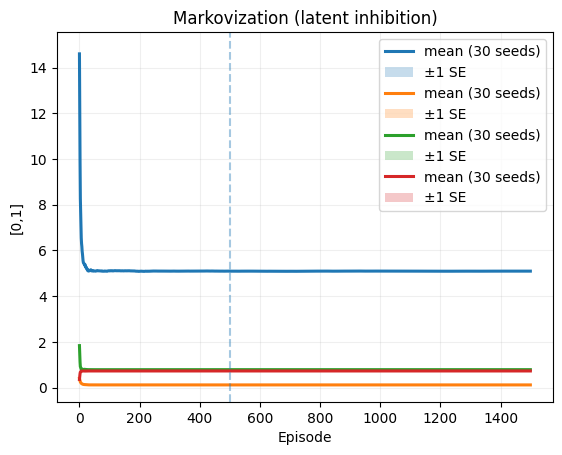

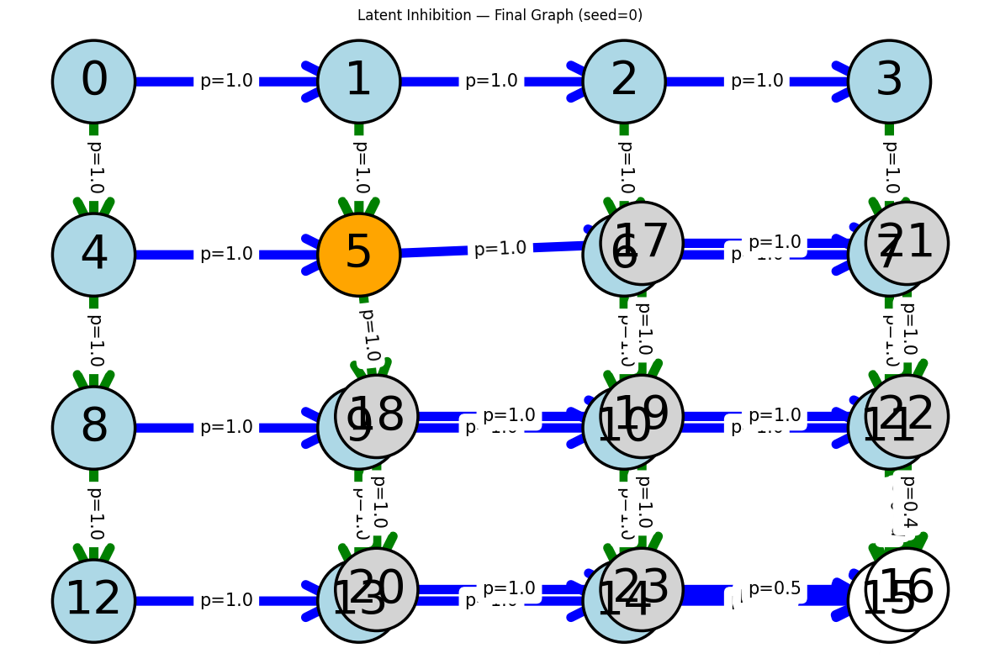

Contingency degradation — final graph (seed 0)


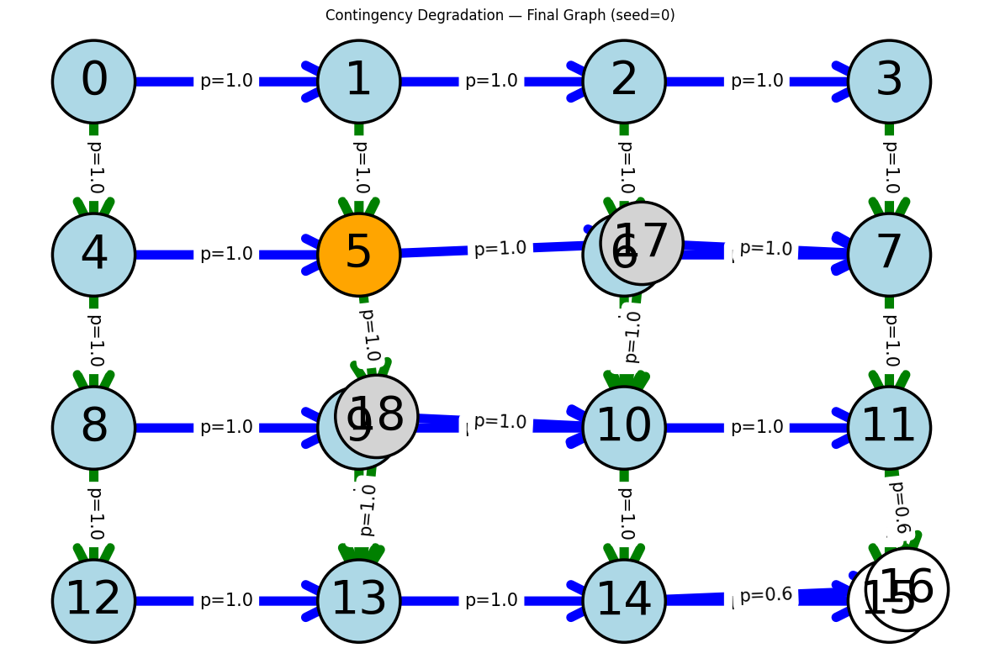

Latent inhibition — final acquisition graph (seed 1)


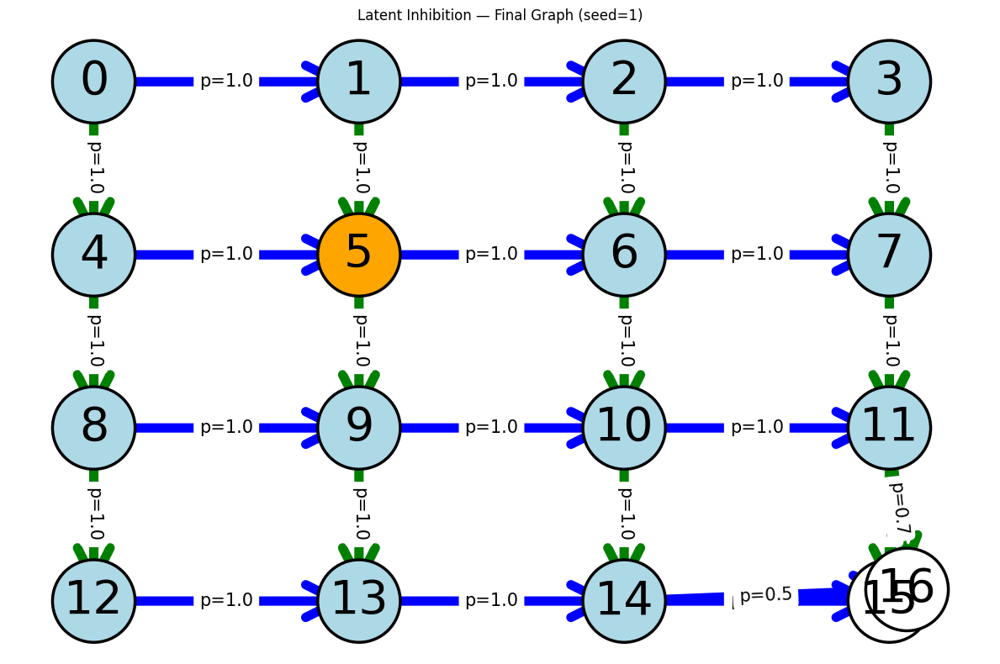

Contingency degradation — final graph (seed 1)


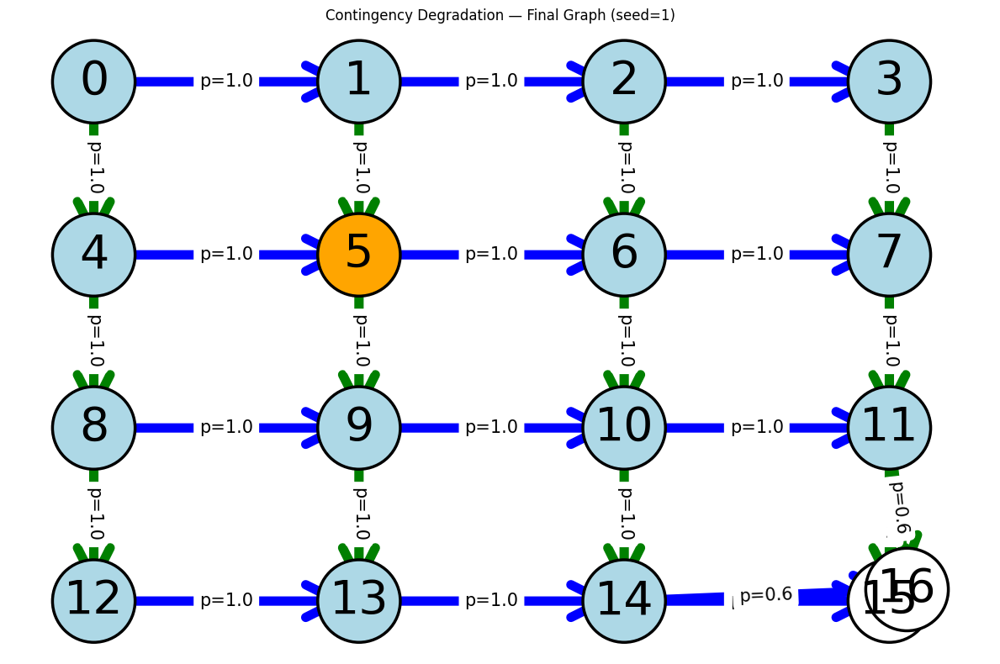

Latent inhibition — final acquisition graph (seed 2)


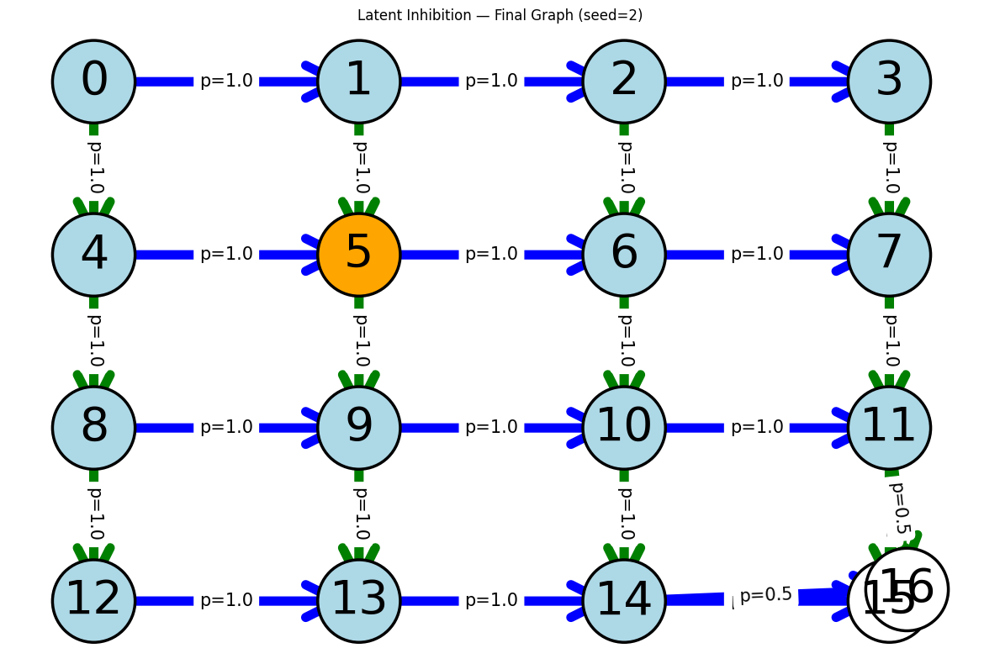

Contingency degradation — final graph (seed 2)


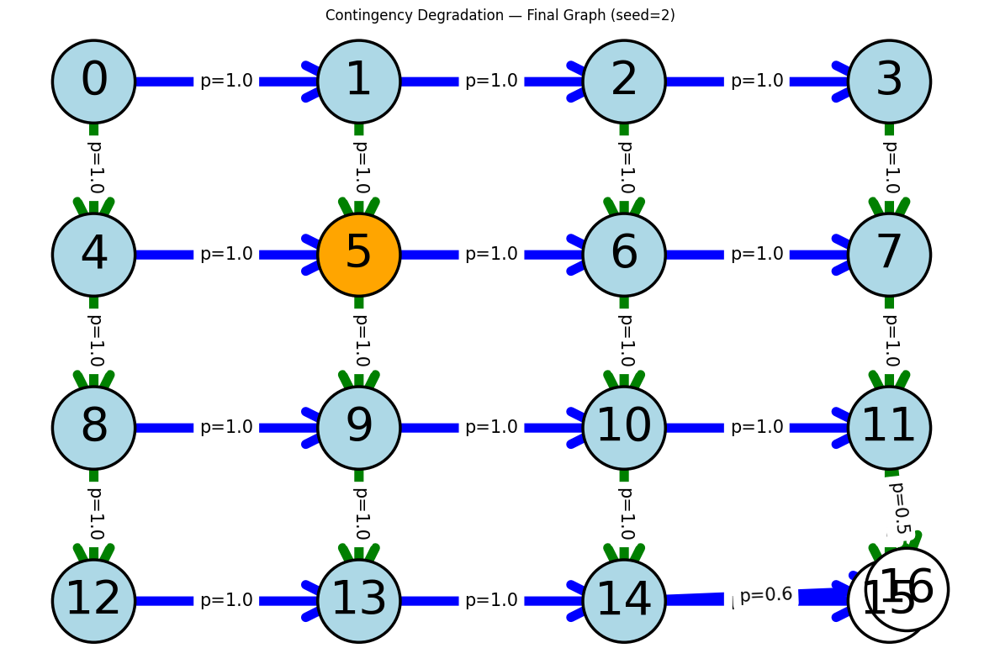

Latent inhibition — final acquisition graph (seed 3)


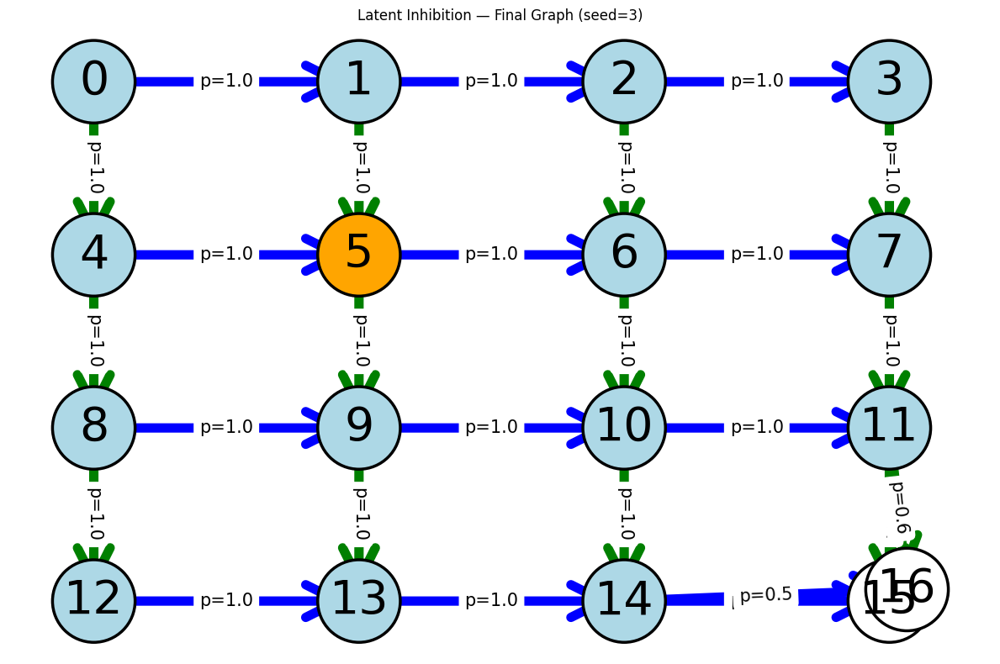

Contingency degradation — final graph (seed 3)


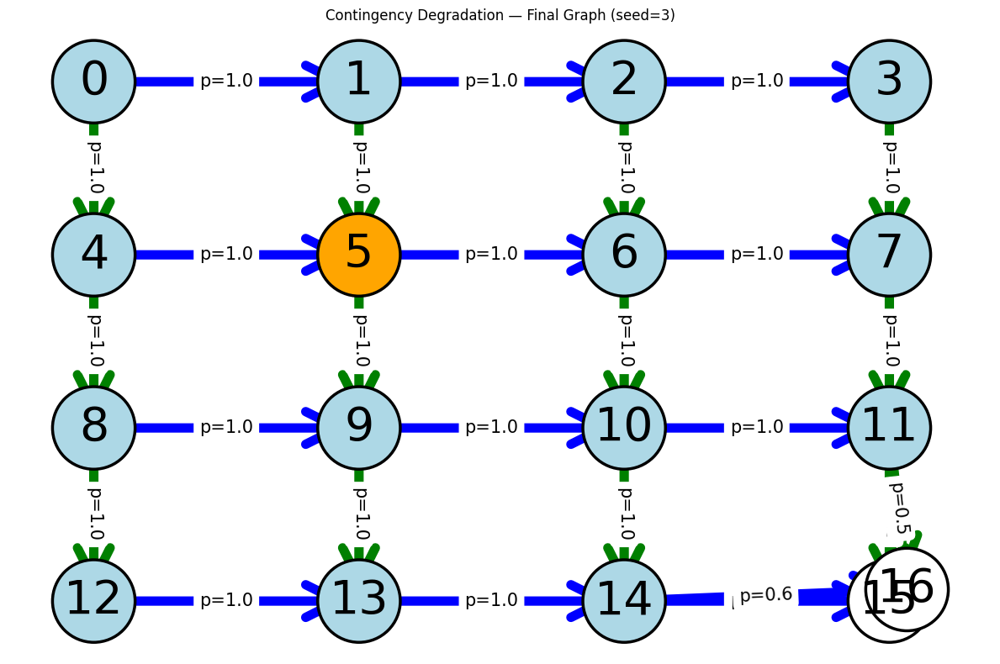

Latent inhibition — final acquisition graph (seed 4)


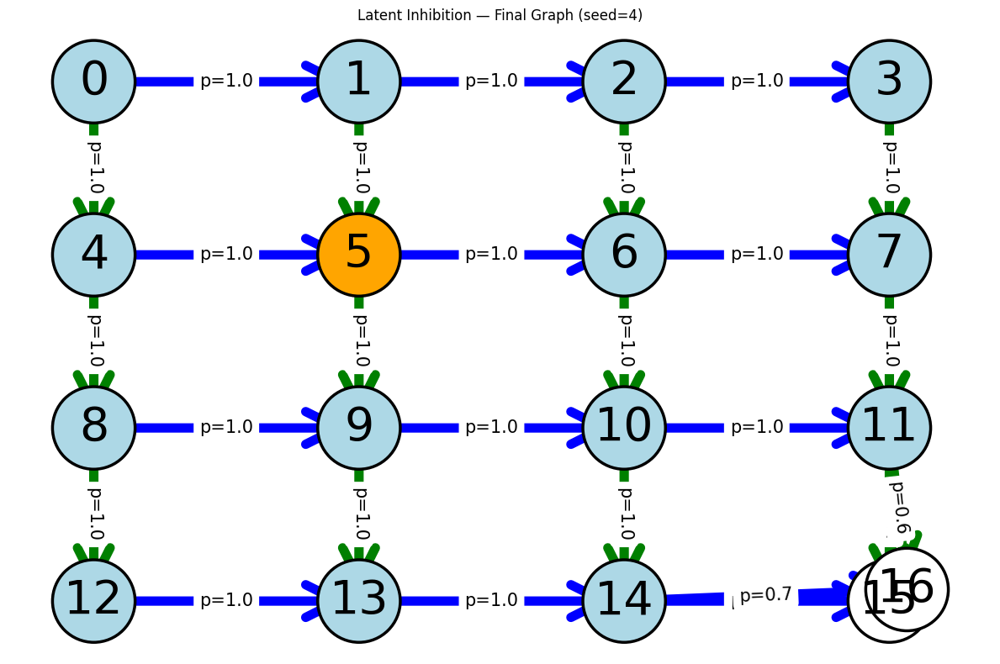

Contingency degradation — final graph (seed 4)


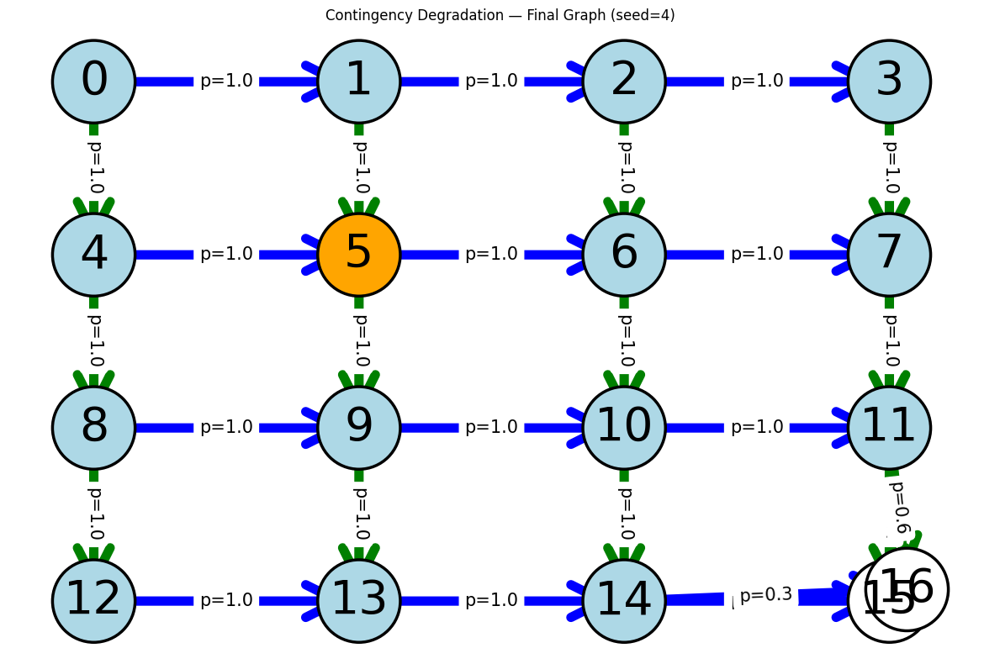

Latent inhibition — final acquisition graph (seed 5)


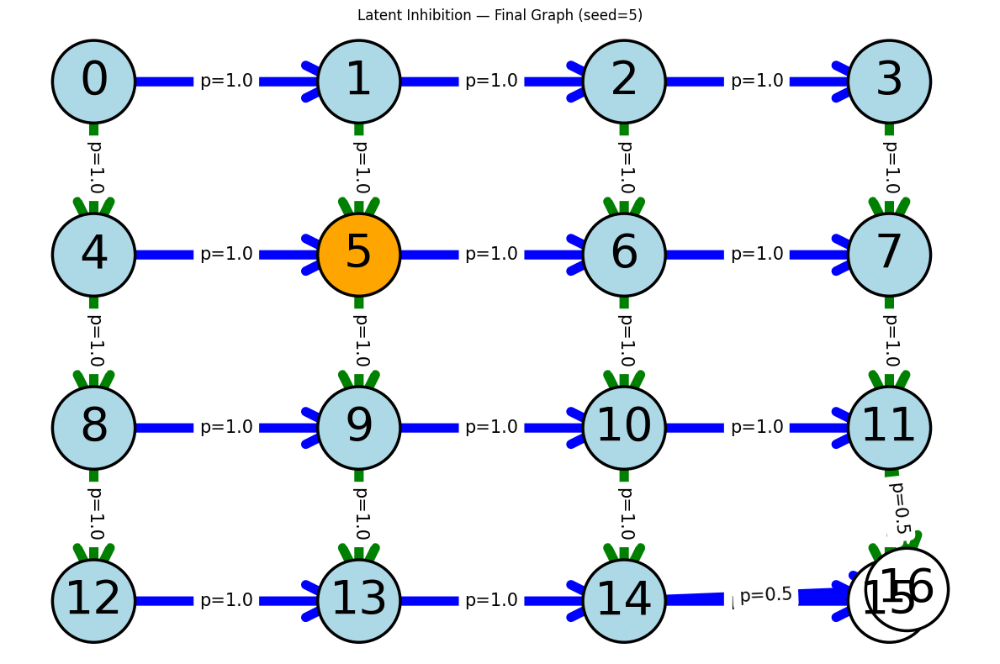

Contingency degradation — final graph (seed 5)


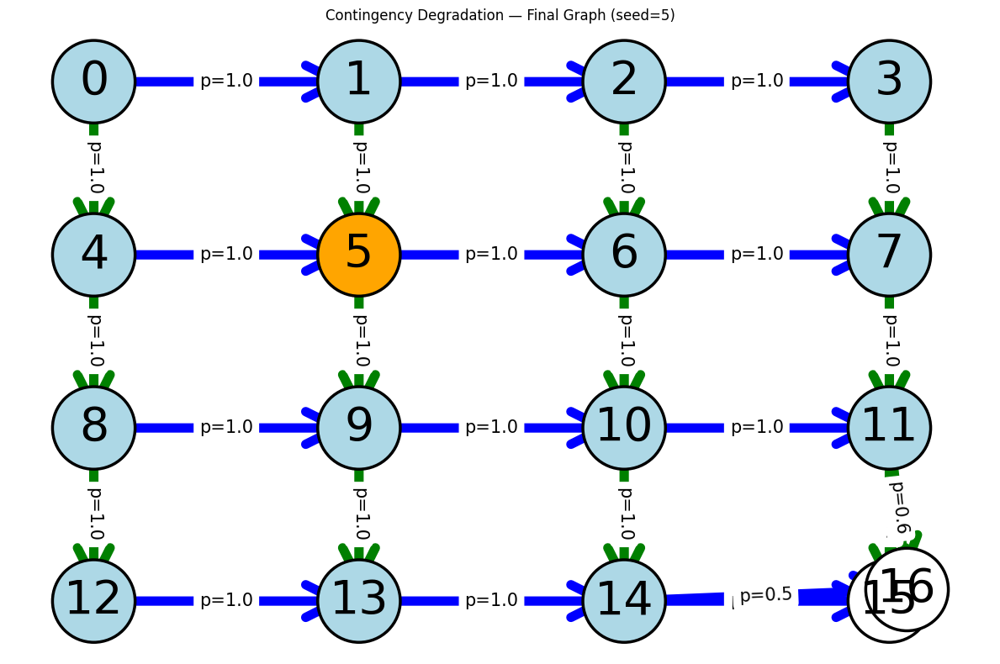

Latent inhibition — final acquisition graph (seed 6)


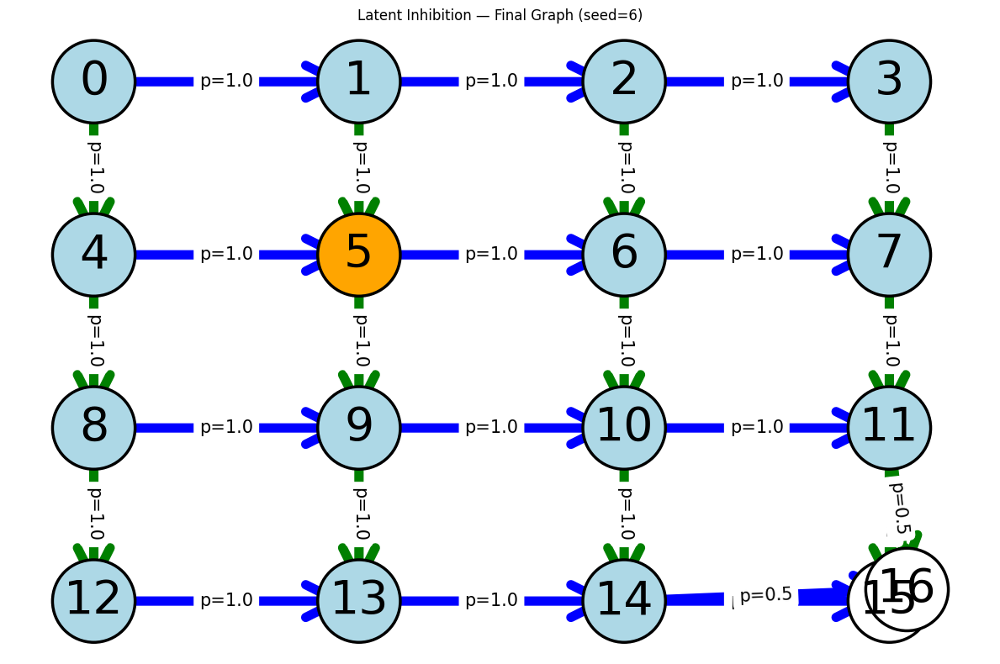

Contingency degradation — final graph (seed 6)


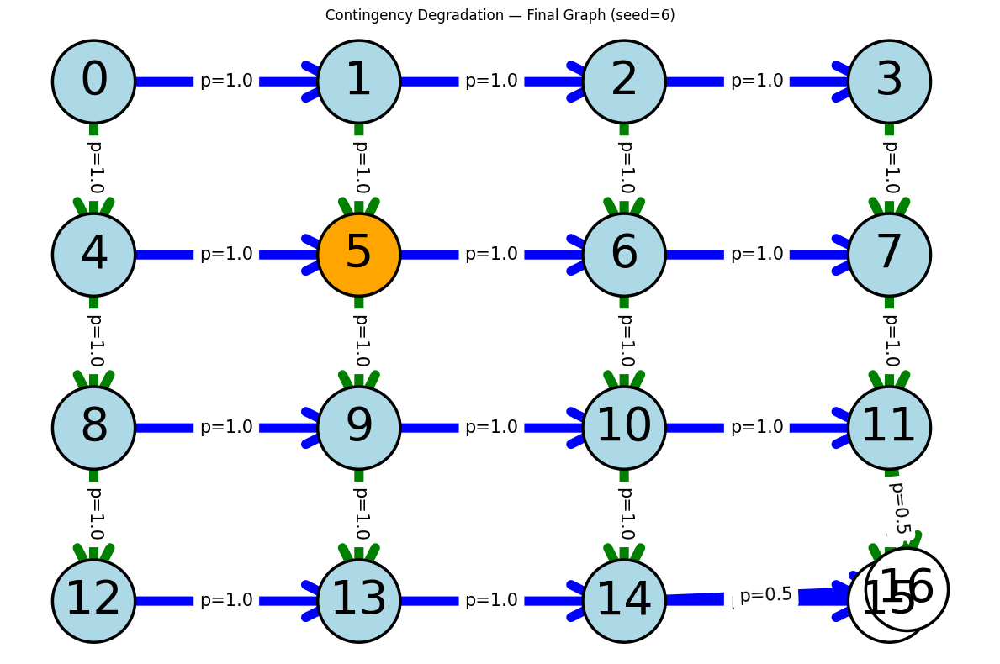

Latent inhibition — final acquisition graph (seed 7)


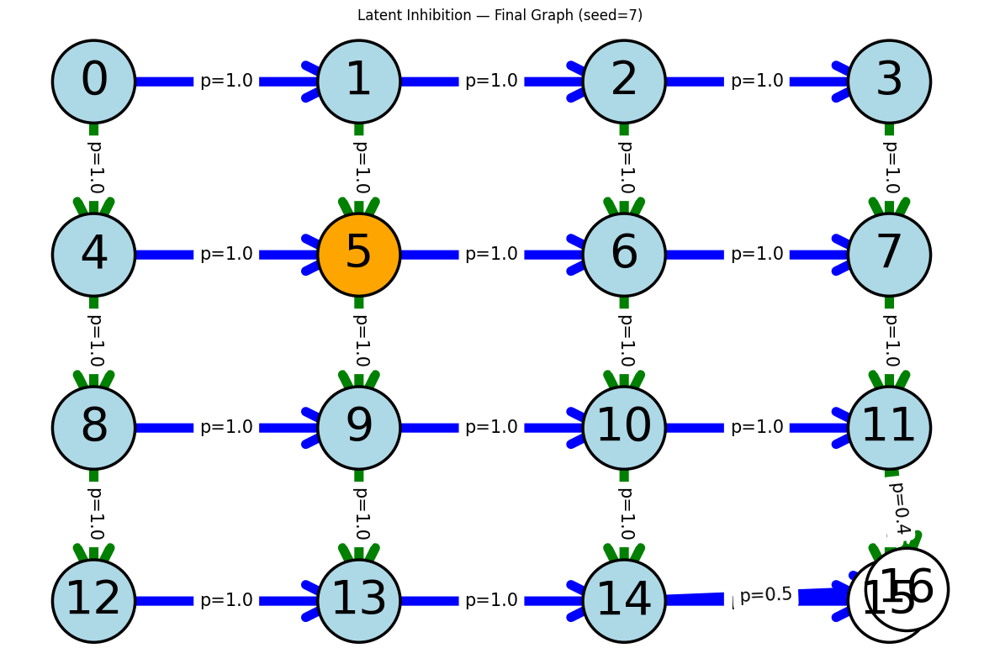

Contingency degradation — final graph (seed 7)


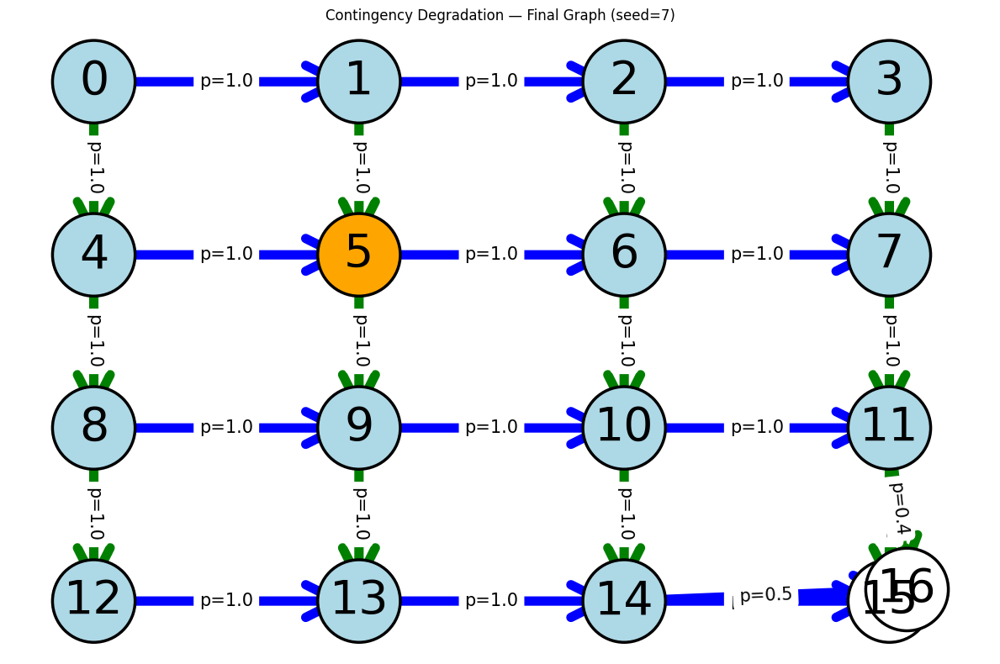

Latent inhibition — final acquisition graph (seed 8)


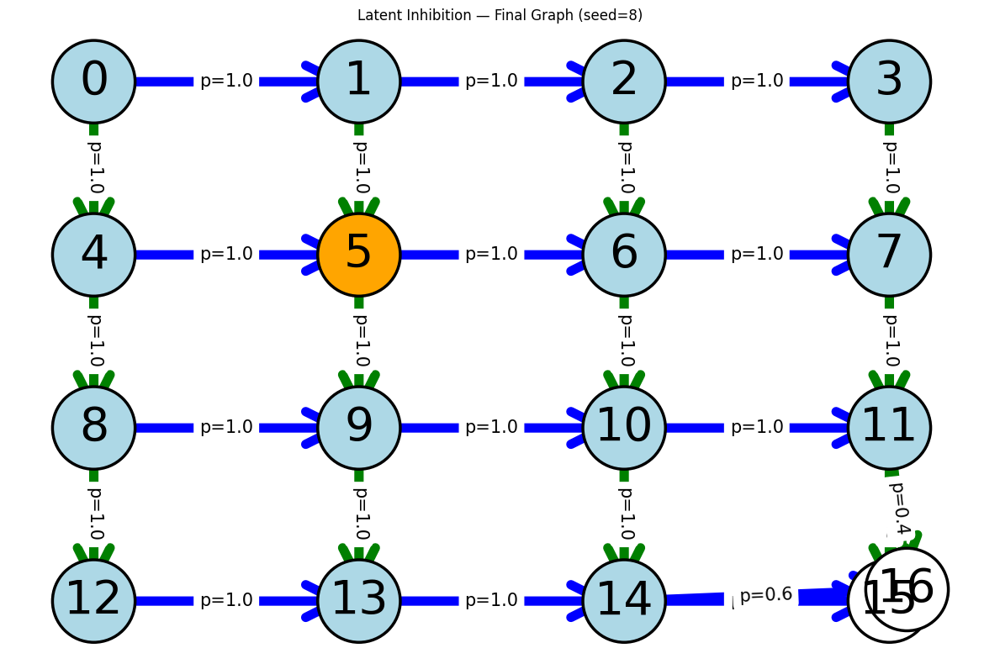

Contingency degradation — final graph (seed 8)


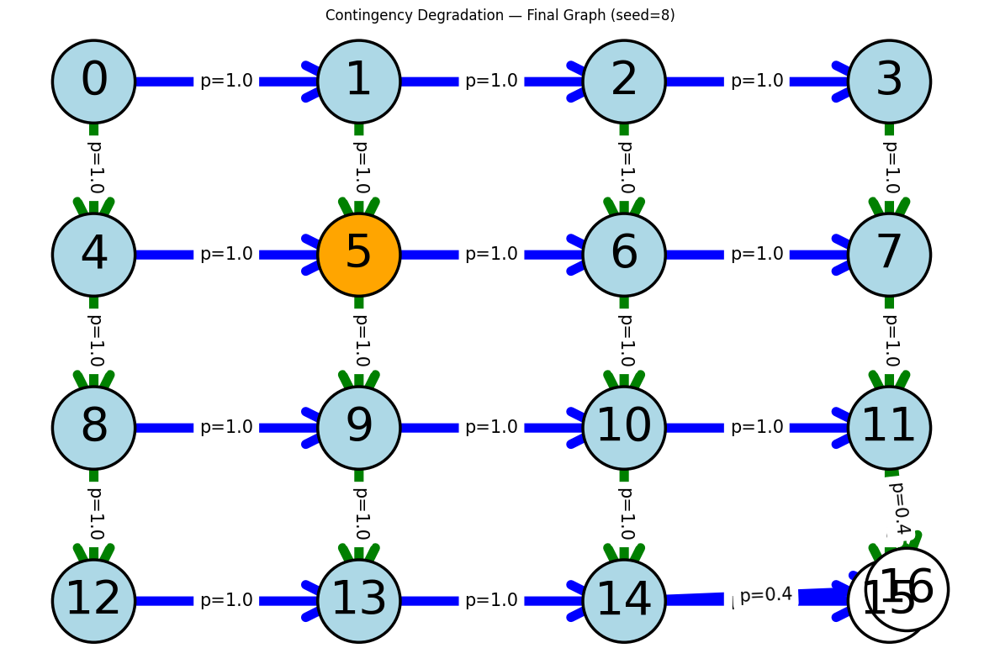

Latent inhibition — final acquisition graph (seed 9)


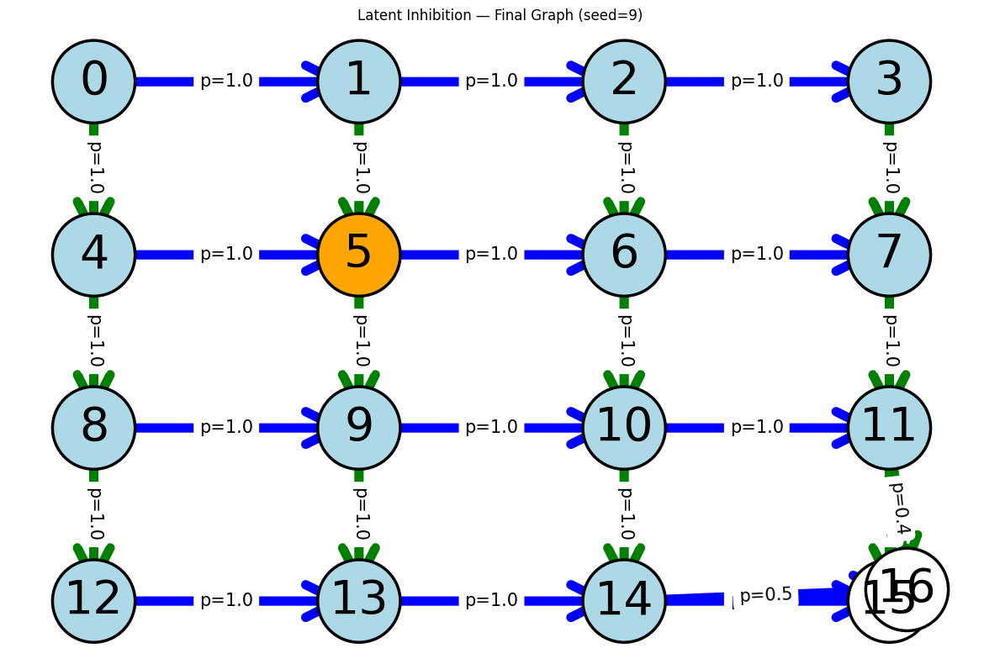

Contingency degradation — final graph (seed 9)


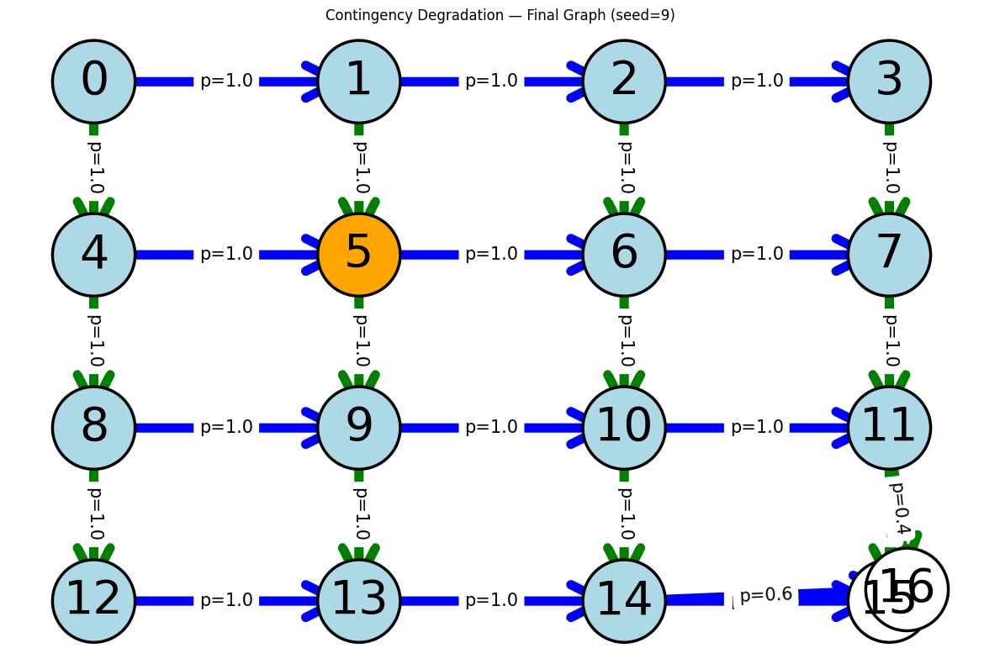

Latent inhibition — final acquisition graph (seed 10)


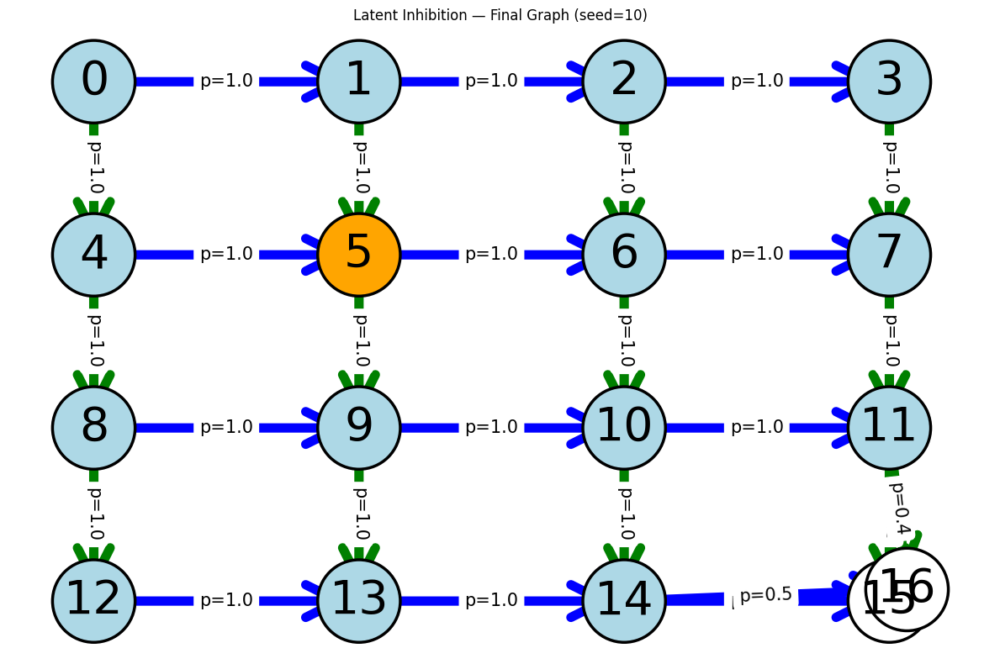

Contingency degradation — final graph (seed 10)


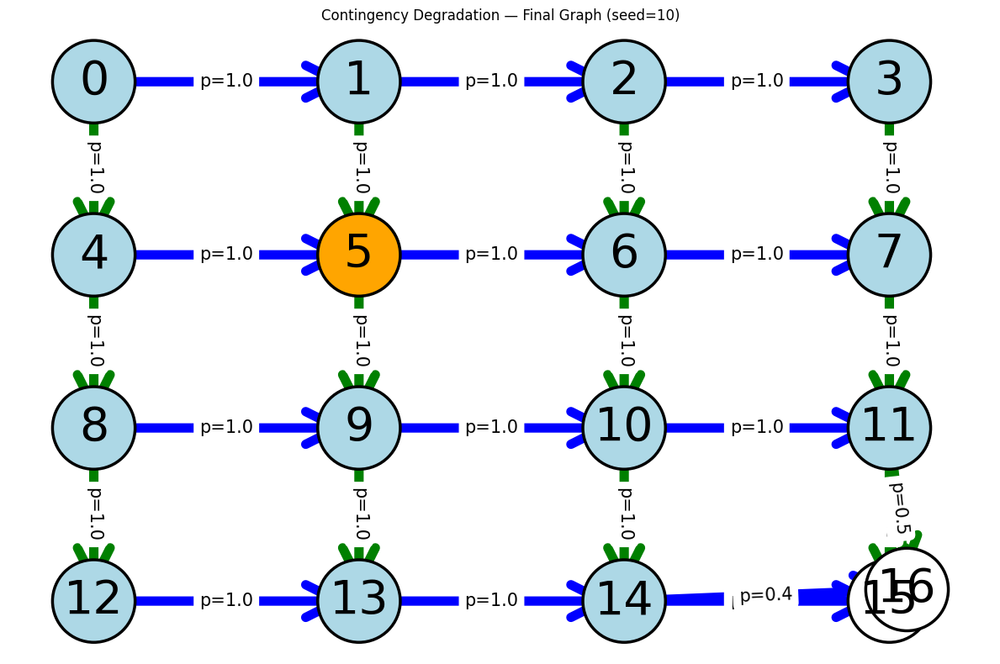

Latent inhibition — final acquisition graph (seed 11)


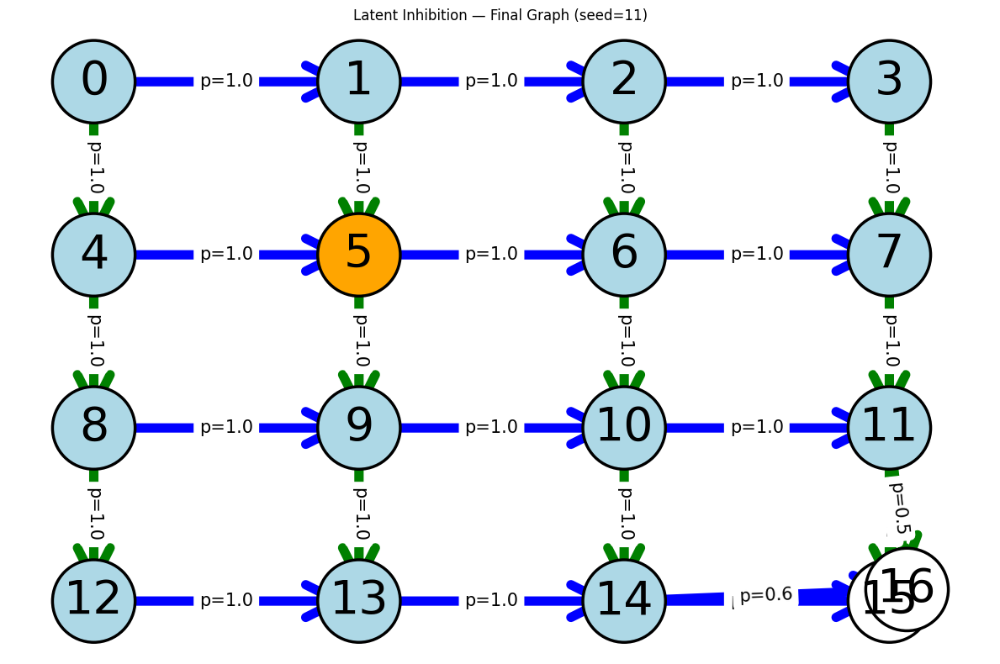

Contingency degradation — final graph (seed 11)


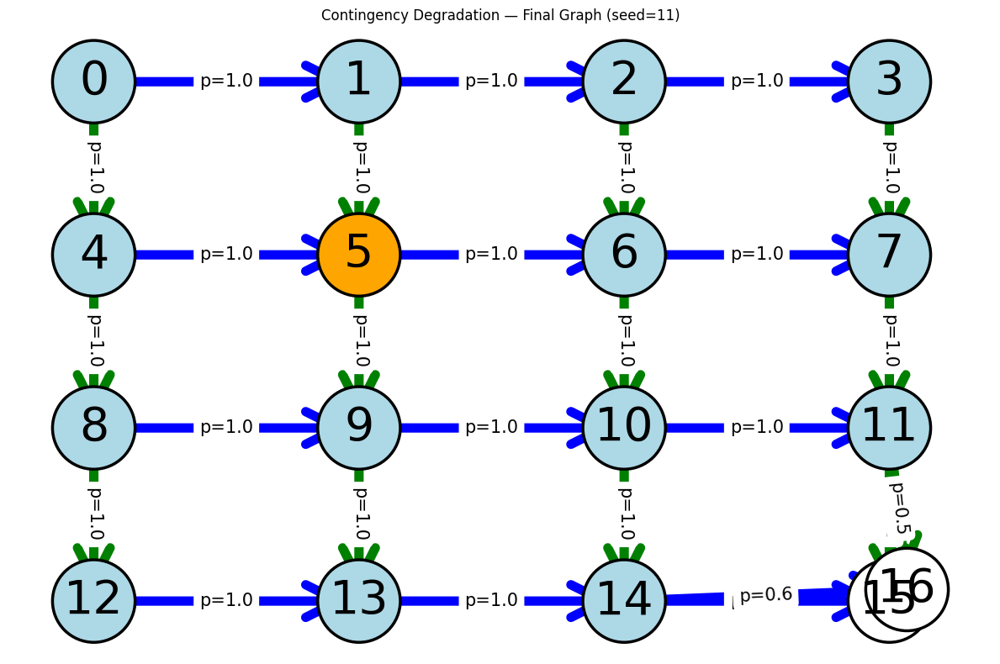

Latent inhibition — final acquisition graph (seed 12)


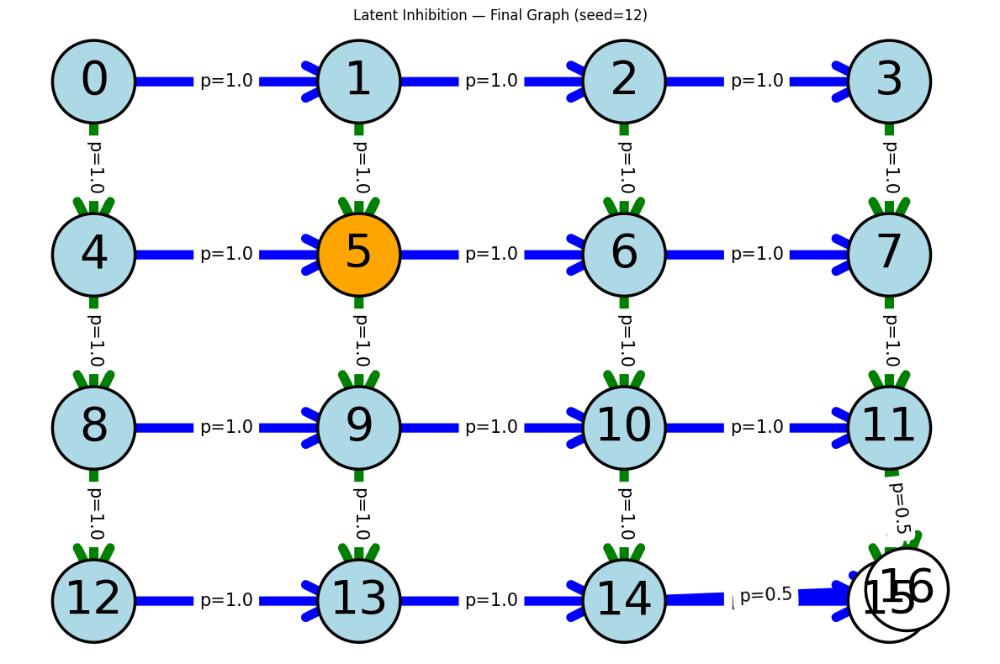

Contingency degradation — final graph (seed 12)


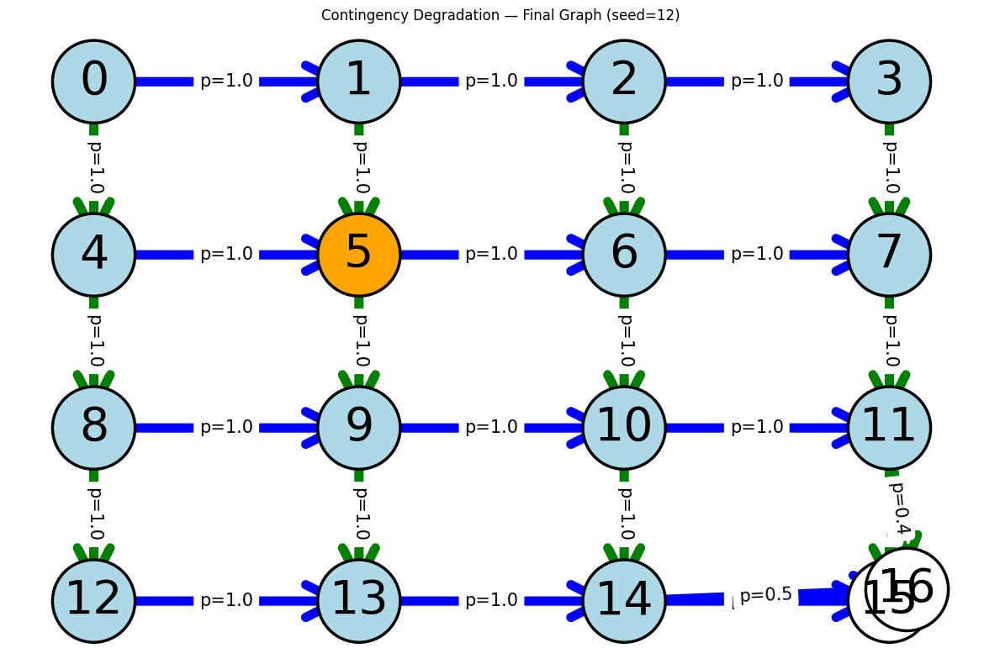

Latent inhibition — final acquisition graph (seed 13)


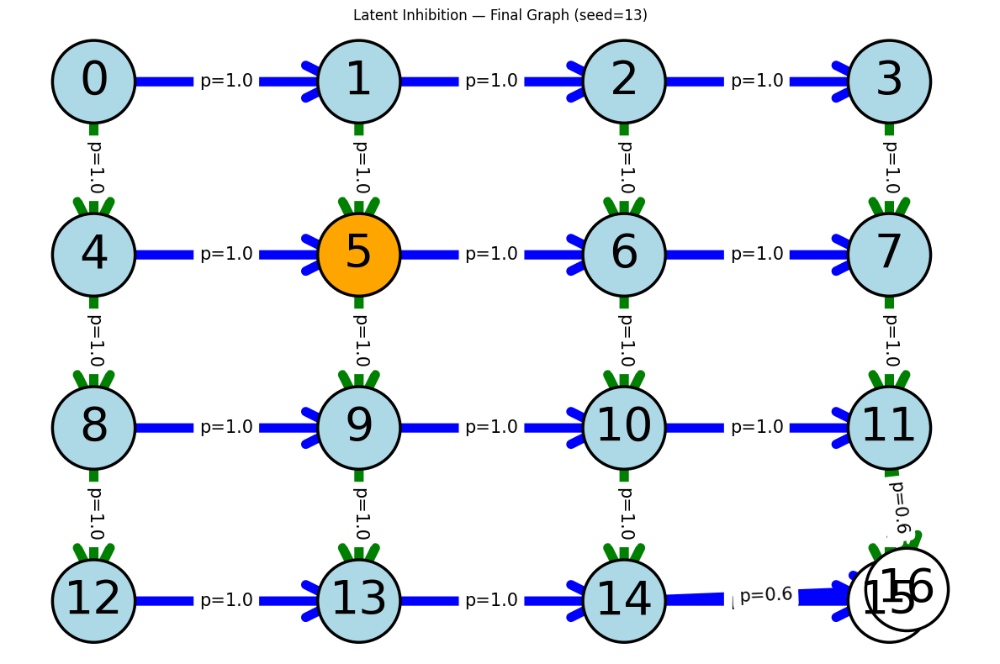

Contingency degradation — final graph (seed 13)


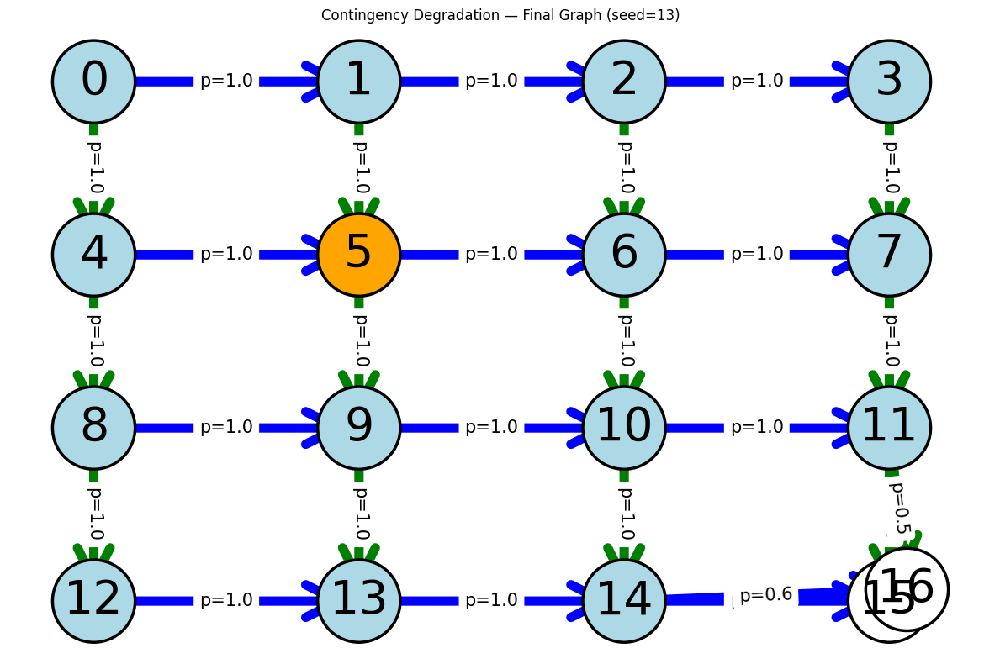

Latent inhibition — final acquisition graph (seed 14)


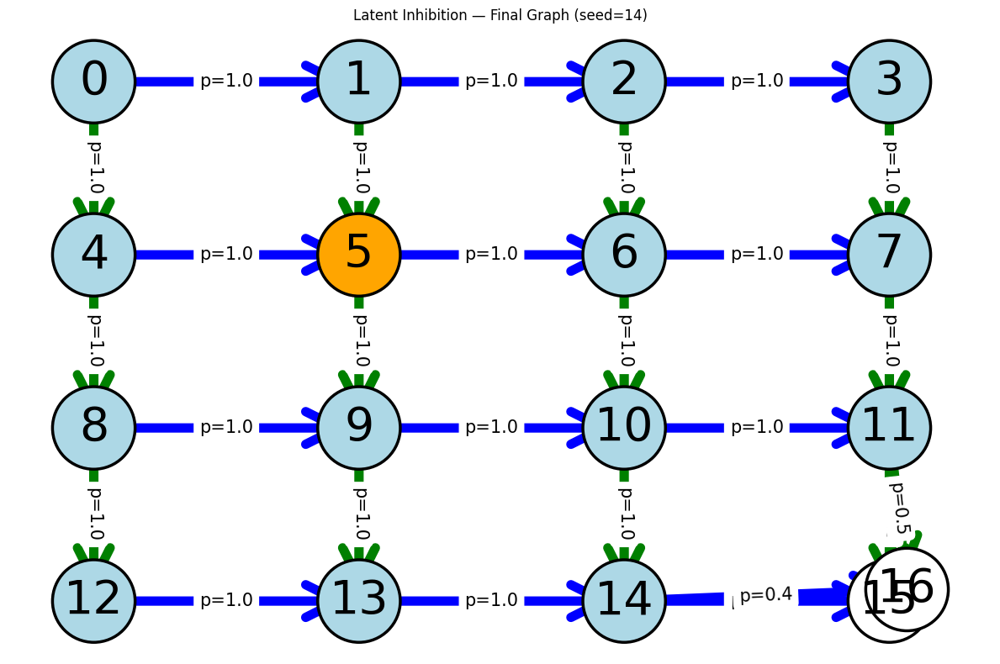

Contingency degradation — final graph (seed 14)


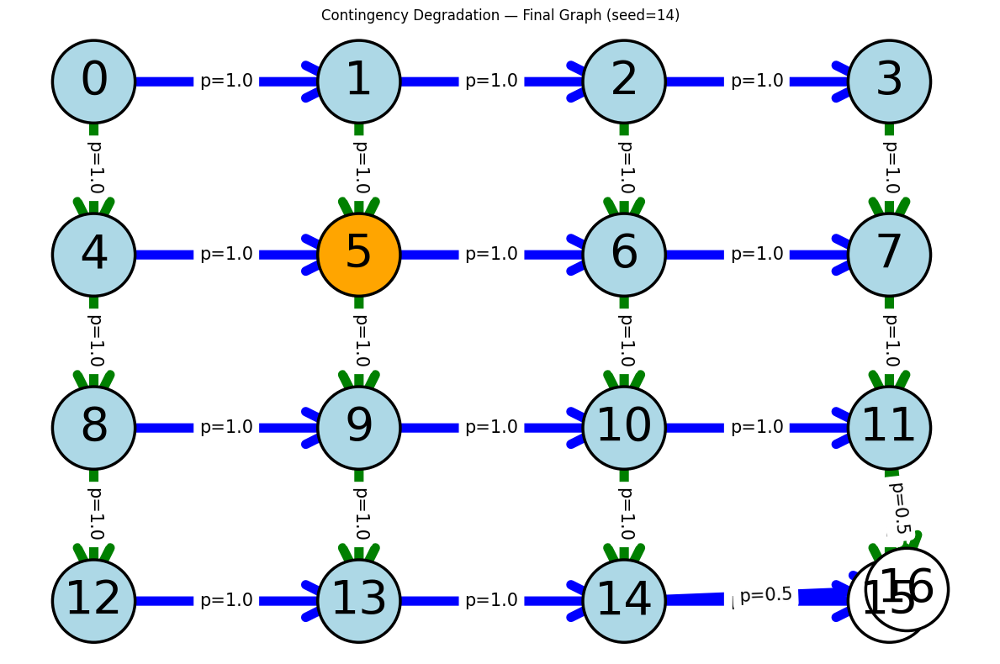

Latent inhibition — final acquisition graph (seed 15)


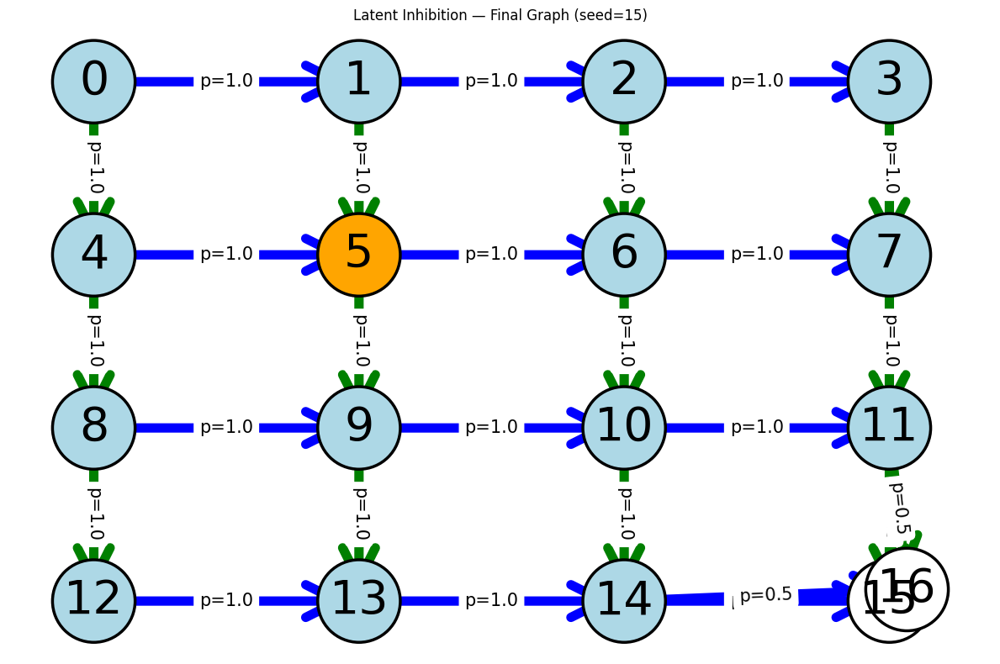

Contingency degradation — final graph (seed 15)


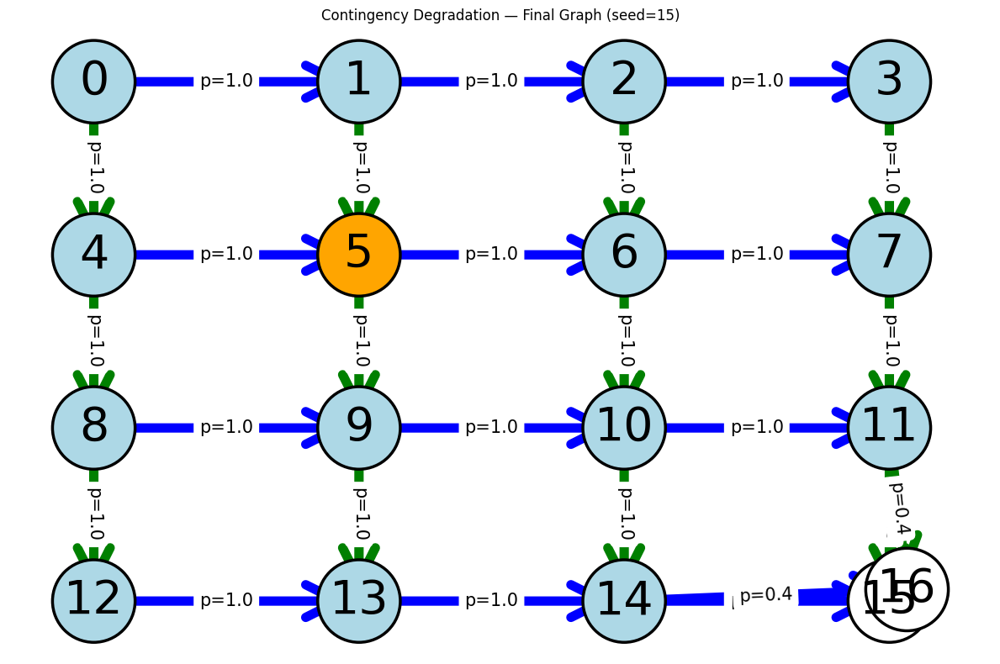

Latent inhibition — final acquisition graph (seed 16)


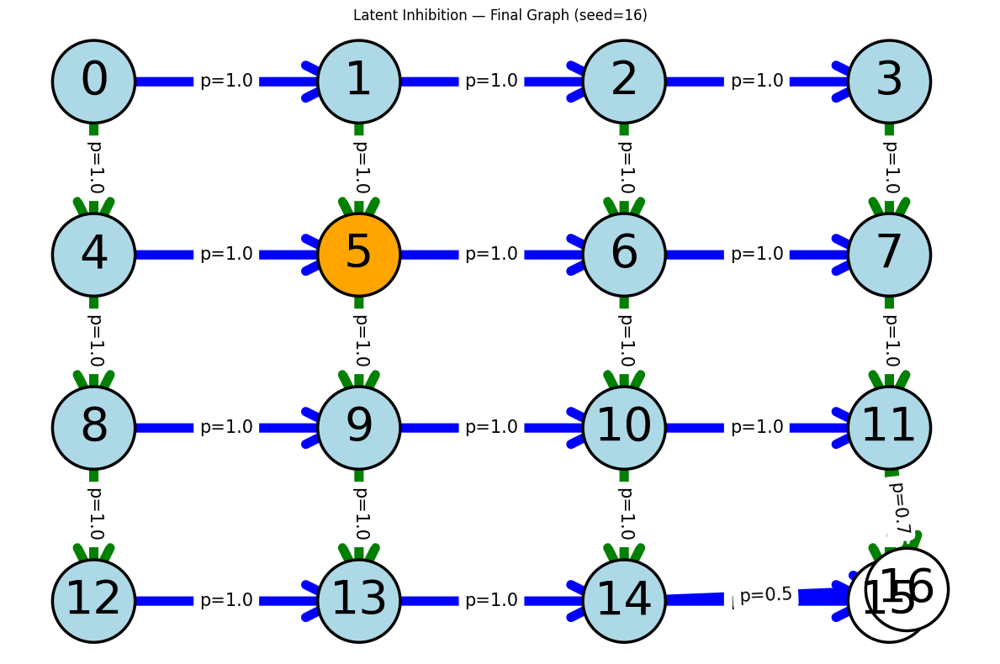

Contingency degradation — final graph (seed 16)


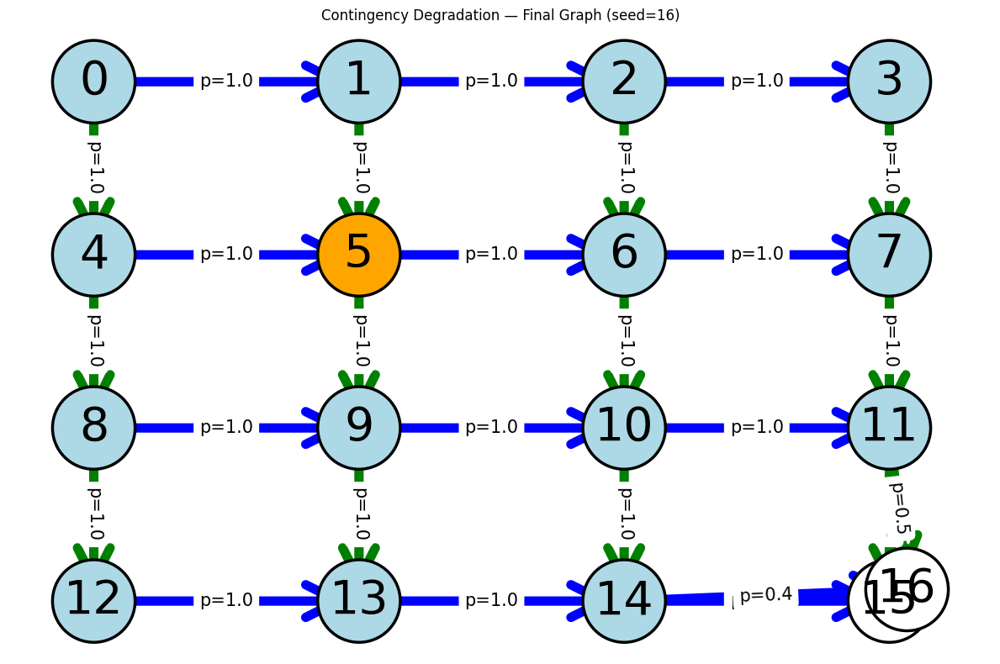

Latent inhibition — final acquisition graph (seed 17)


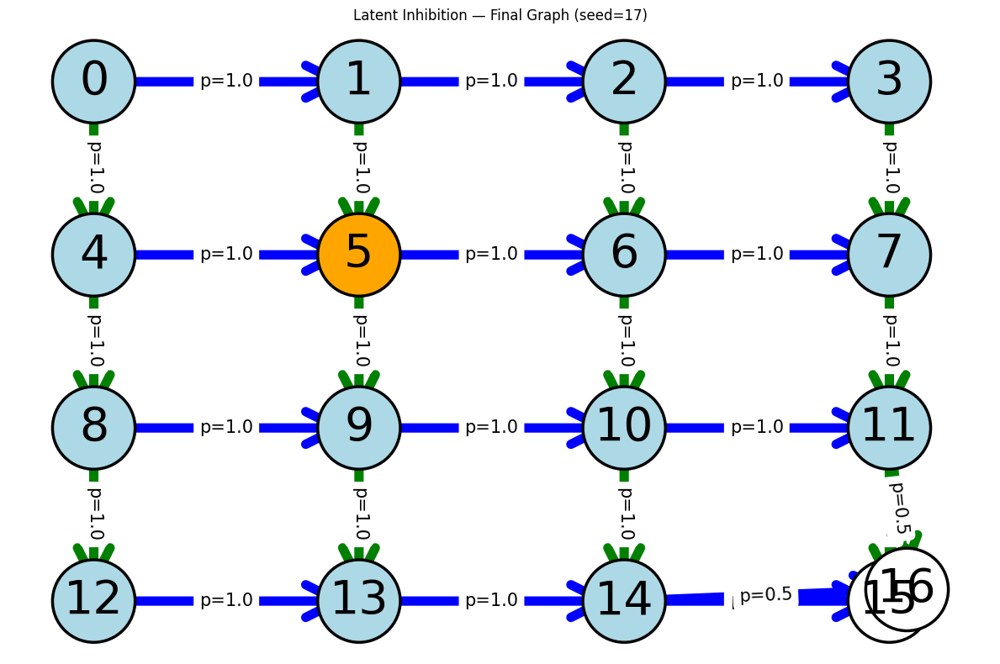

Contingency degradation — final graph (seed 17)


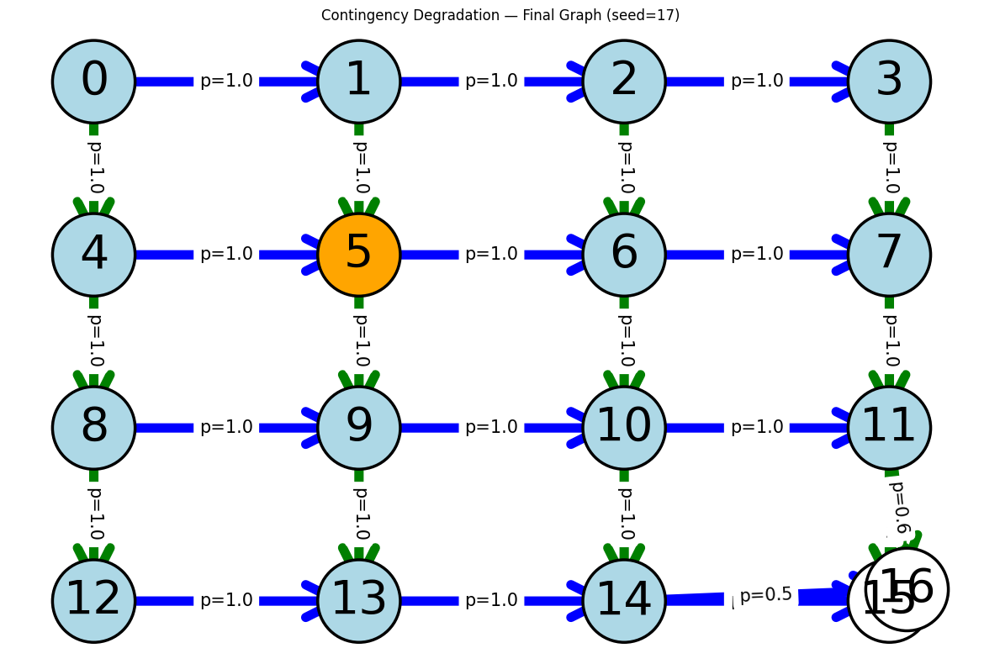

Latent inhibition — final acquisition graph (seed 18)


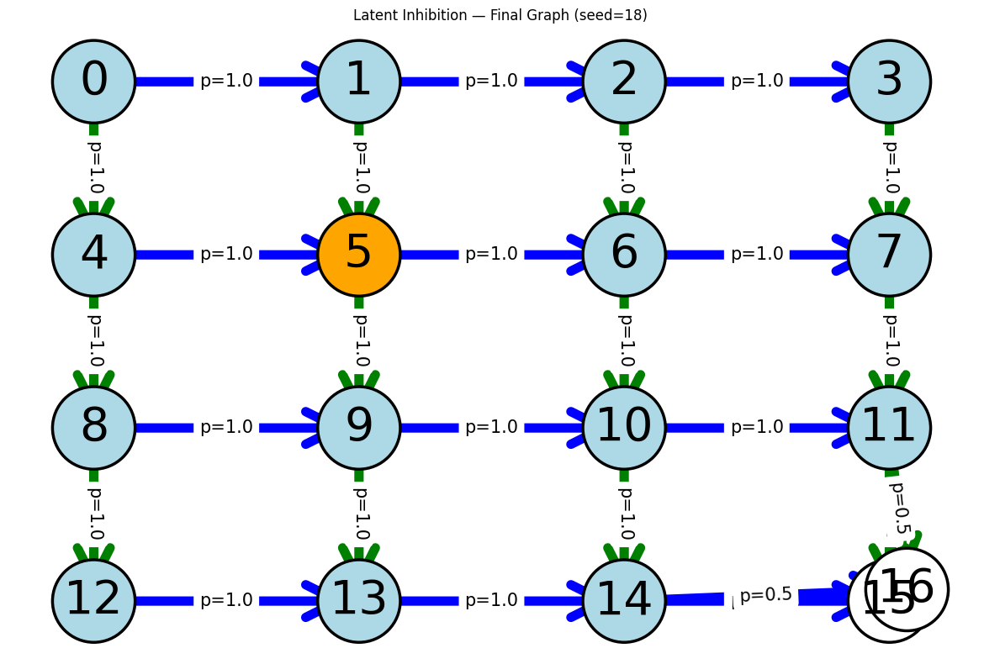

Contingency degradation — final graph (seed 18)


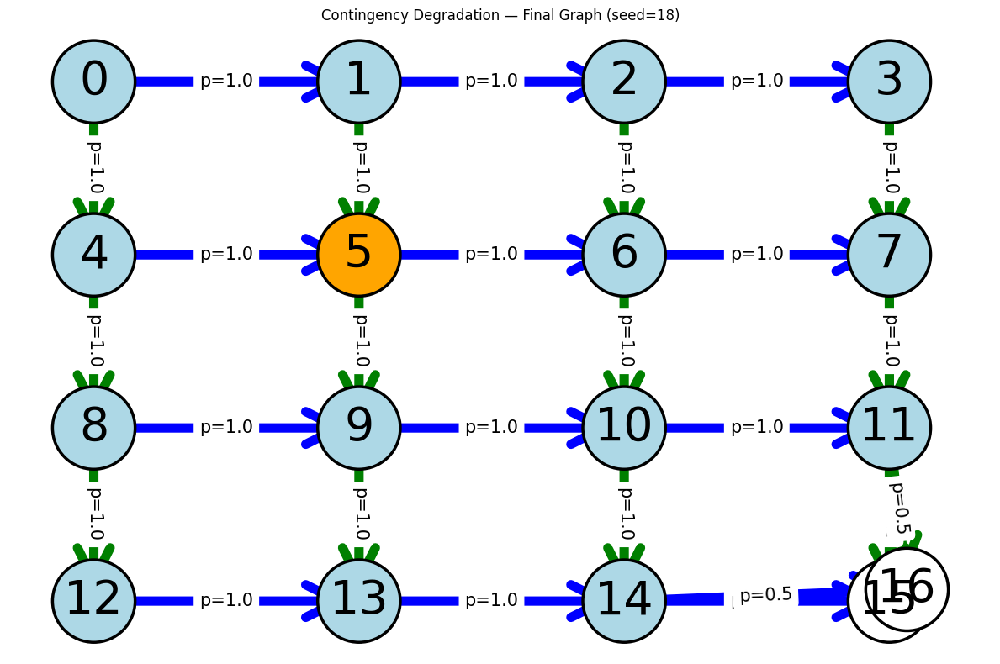

Latent inhibition — final acquisition graph (seed 19)


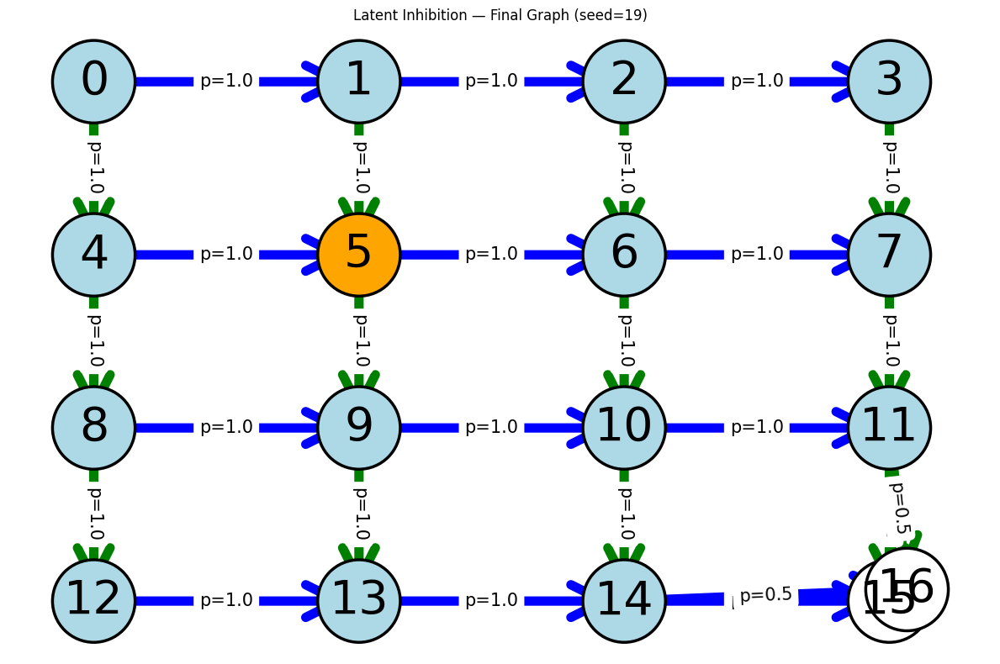

Contingency degradation — final graph (seed 19)


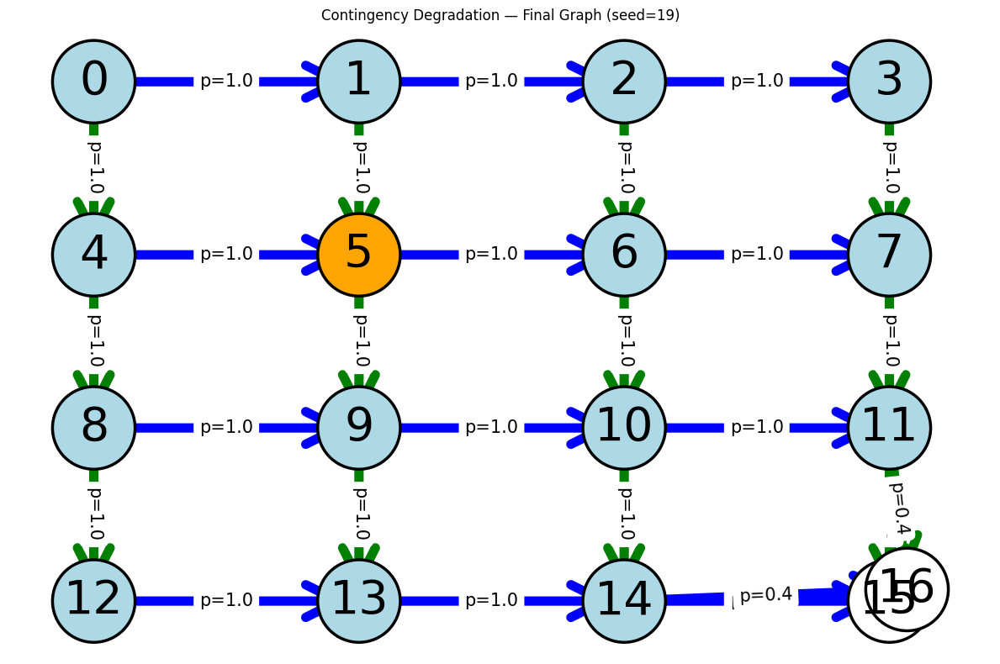

Latent inhibition — final acquisition graph (seed 20)


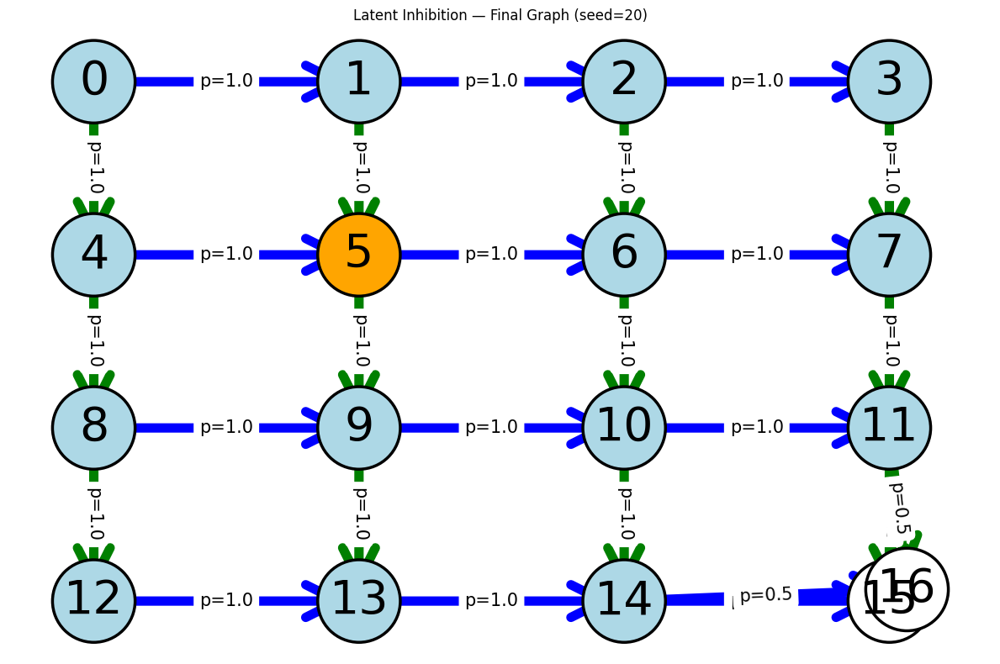

Contingency degradation — final graph (seed 20)


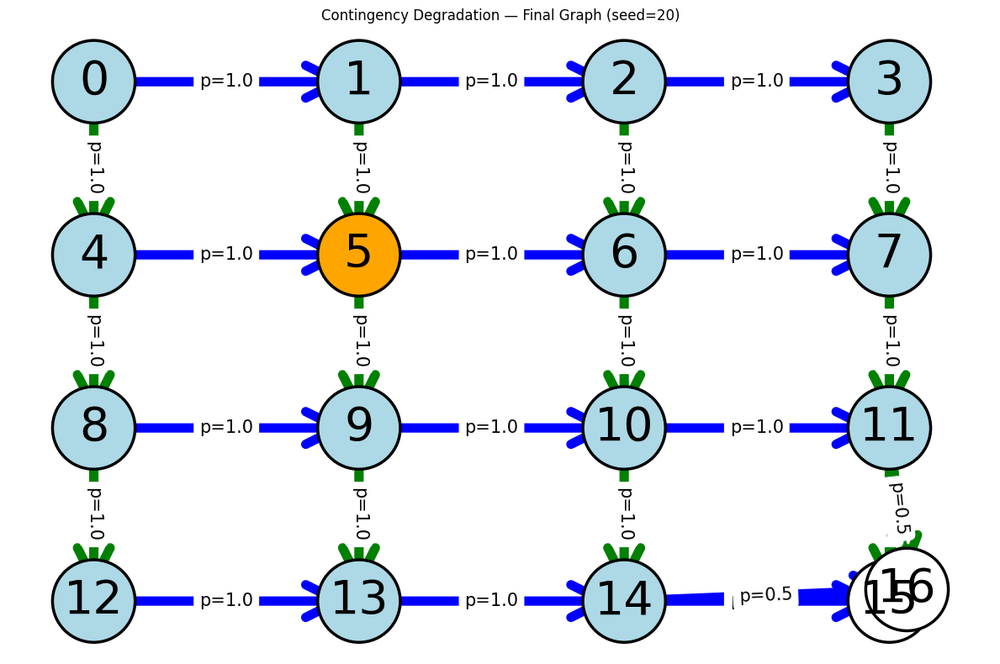

Latent inhibition — final acquisition graph (seed 21)


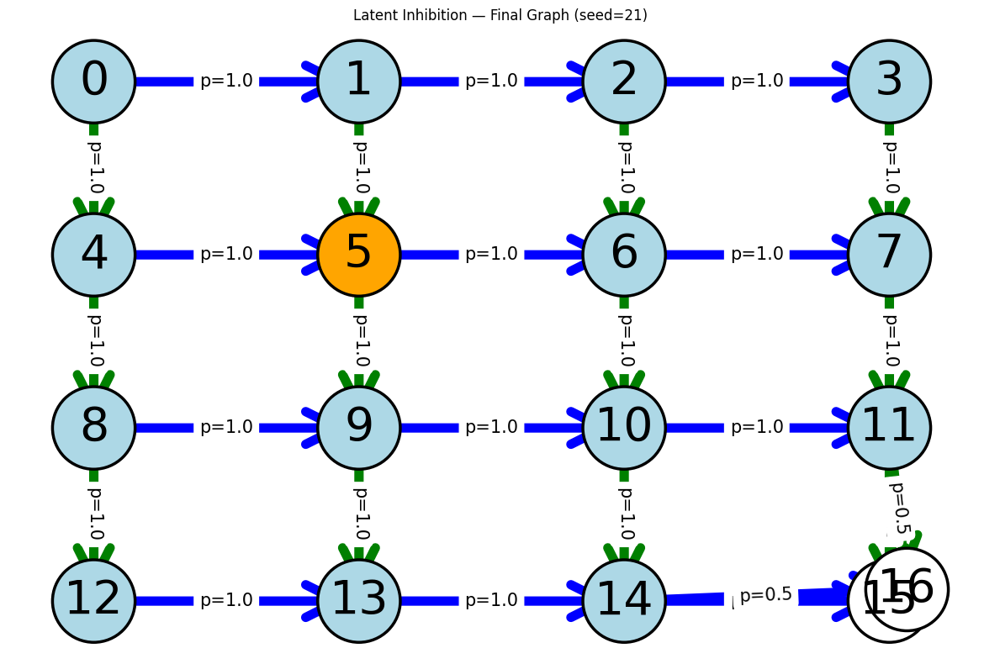

Contingency degradation — final graph (seed 21)


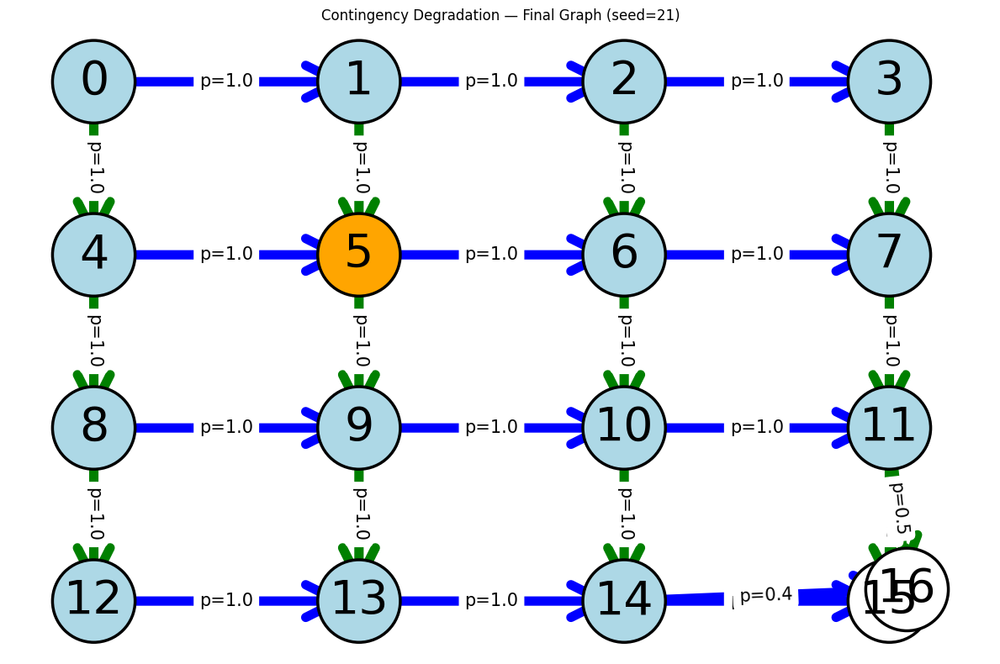

Latent inhibition — final acquisition graph (seed 22)


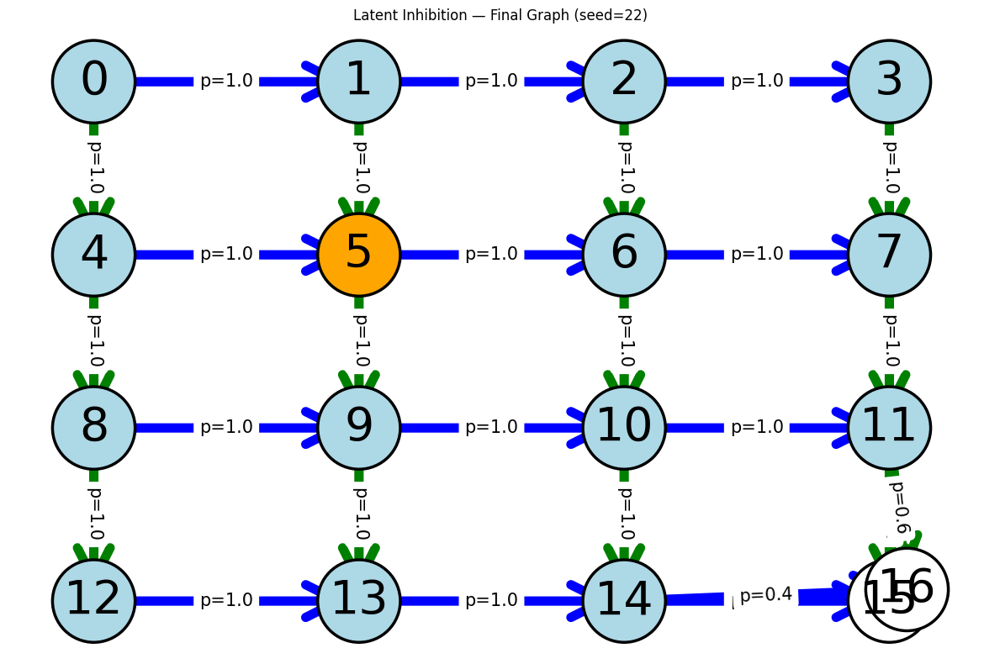

Contingency degradation — final graph (seed 22)


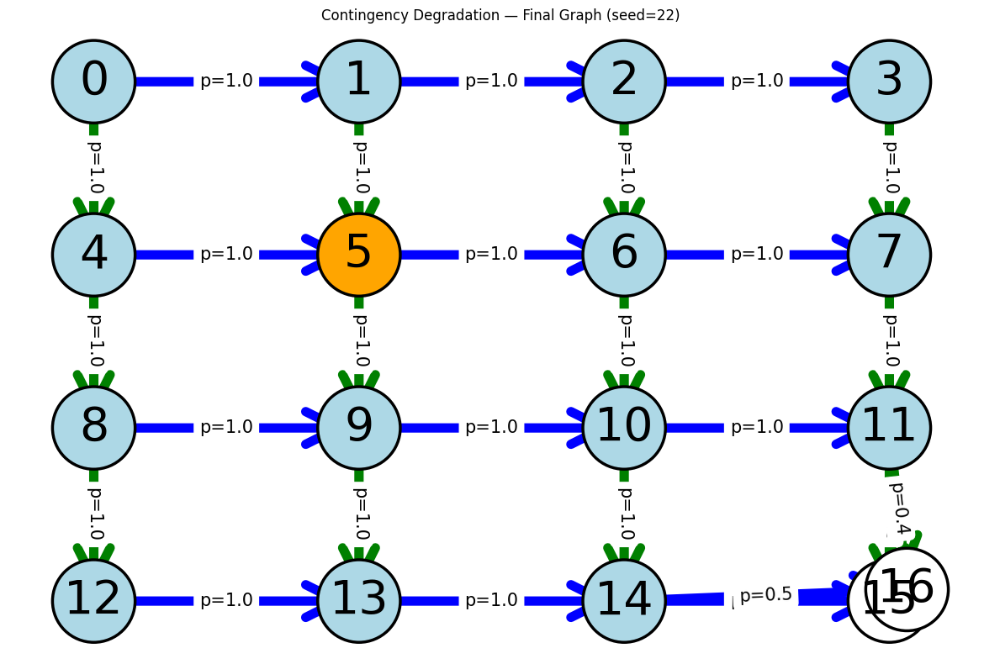

Latent inhibition — final acquisition graph (seed 23)


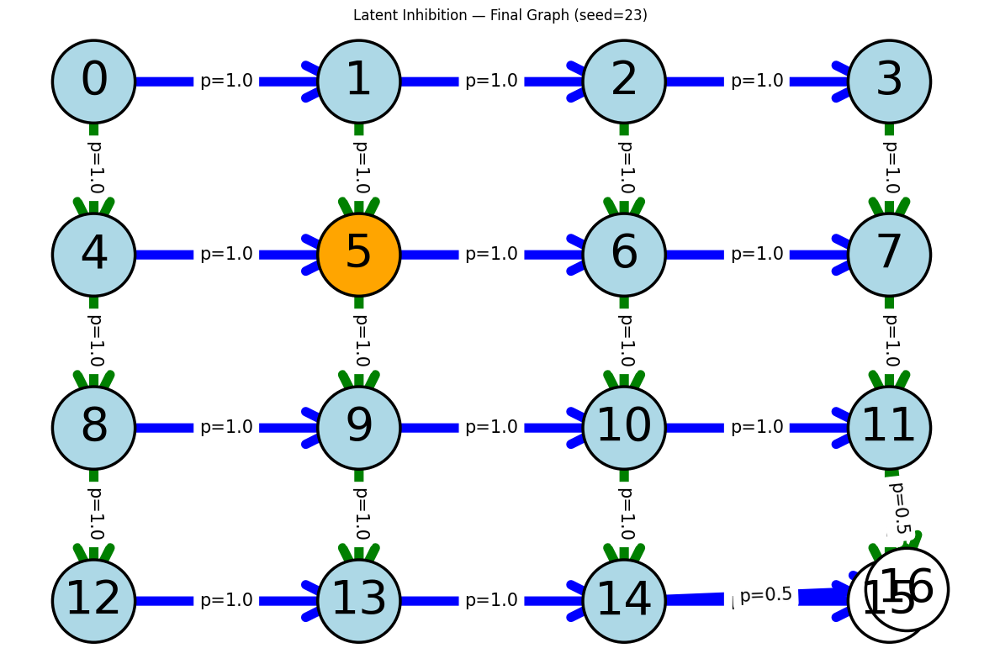

Contingency degradation — final graph (seed 23)


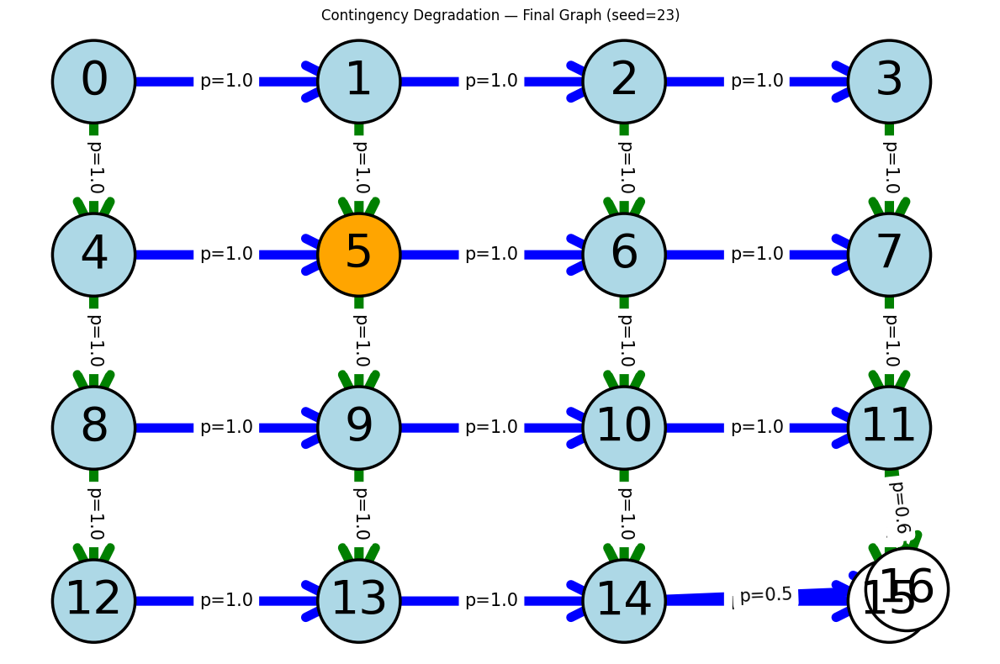

Latent inhibition — final acquisition graph (seed 24)


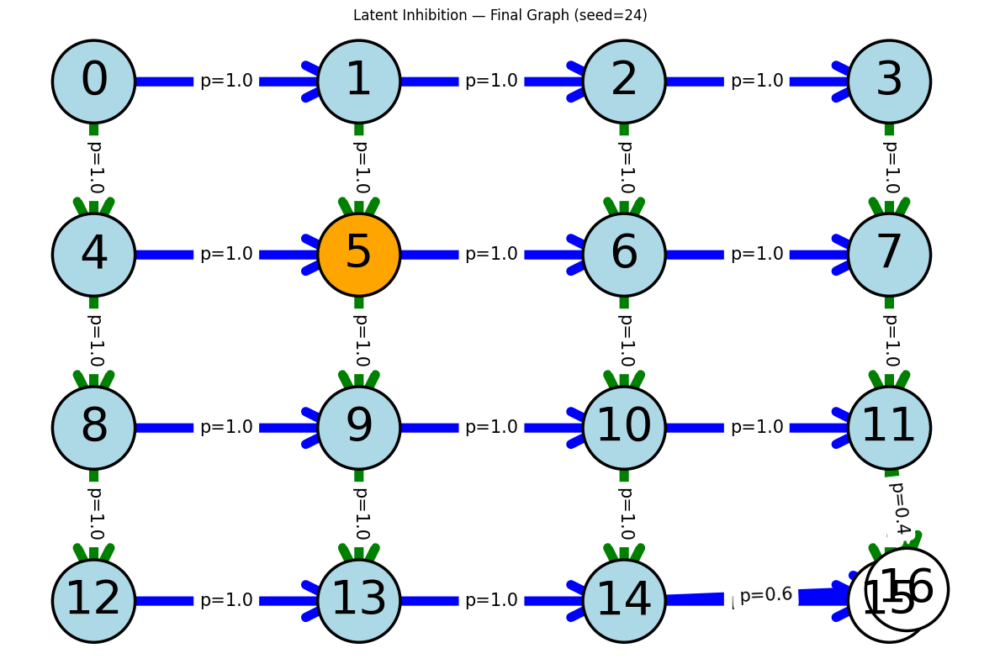

Contingency degradation — final graph (seed 24)


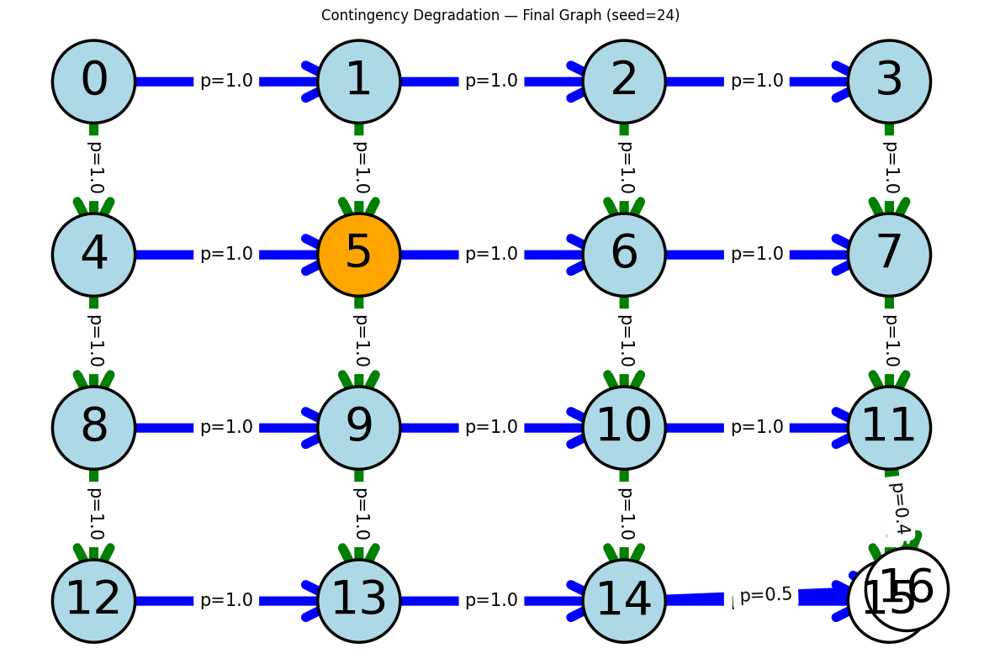

Latent inhibition — final acquisition graph (seed 25)


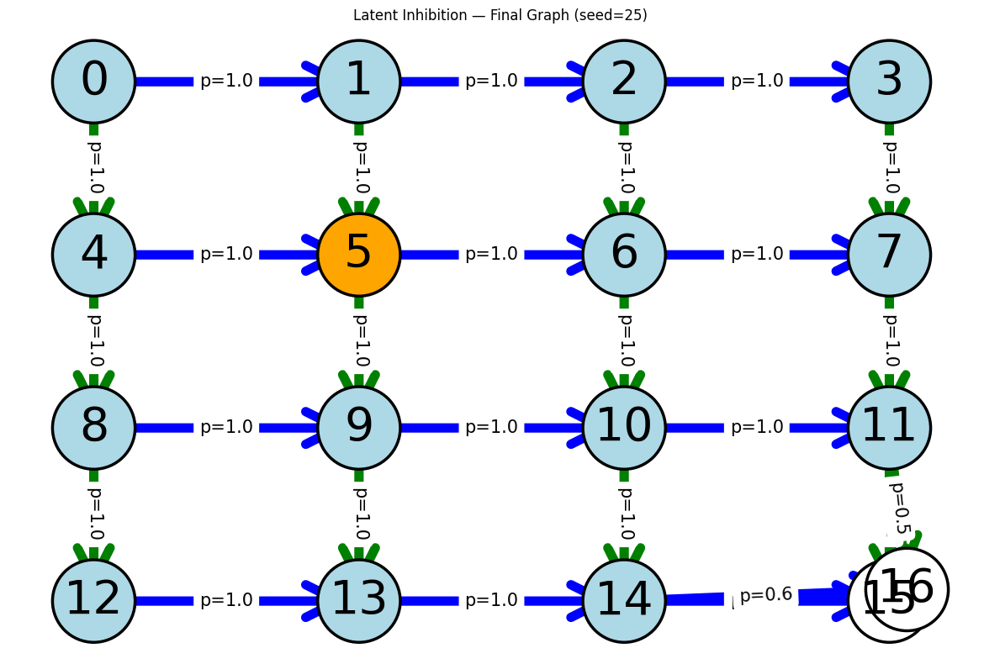

Contingency degradation — final graph (seed 25)


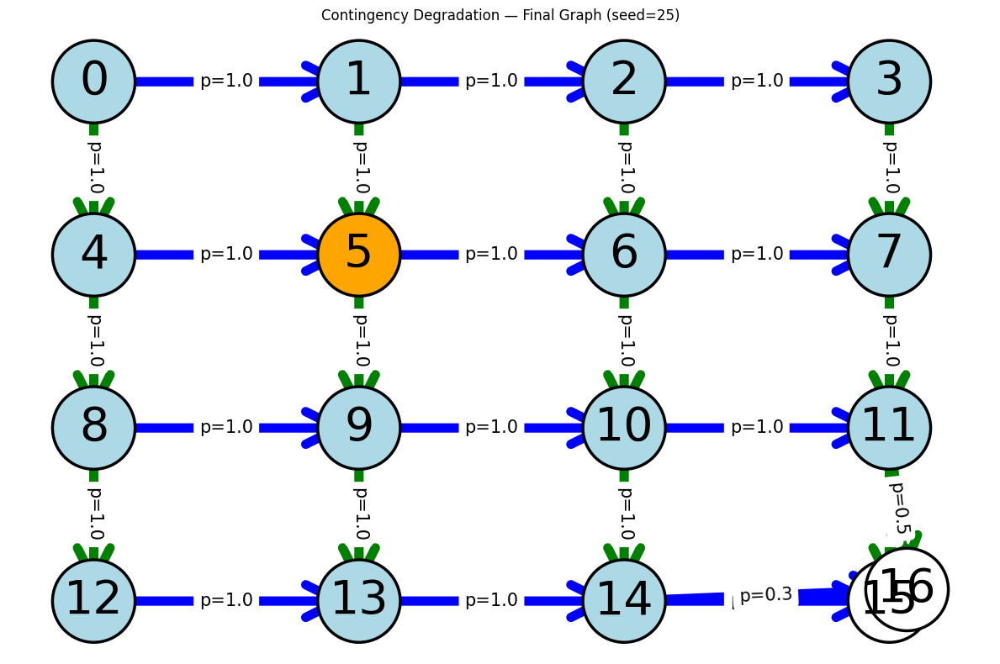

Latent inhibition — final acquisition graph (seed 26)


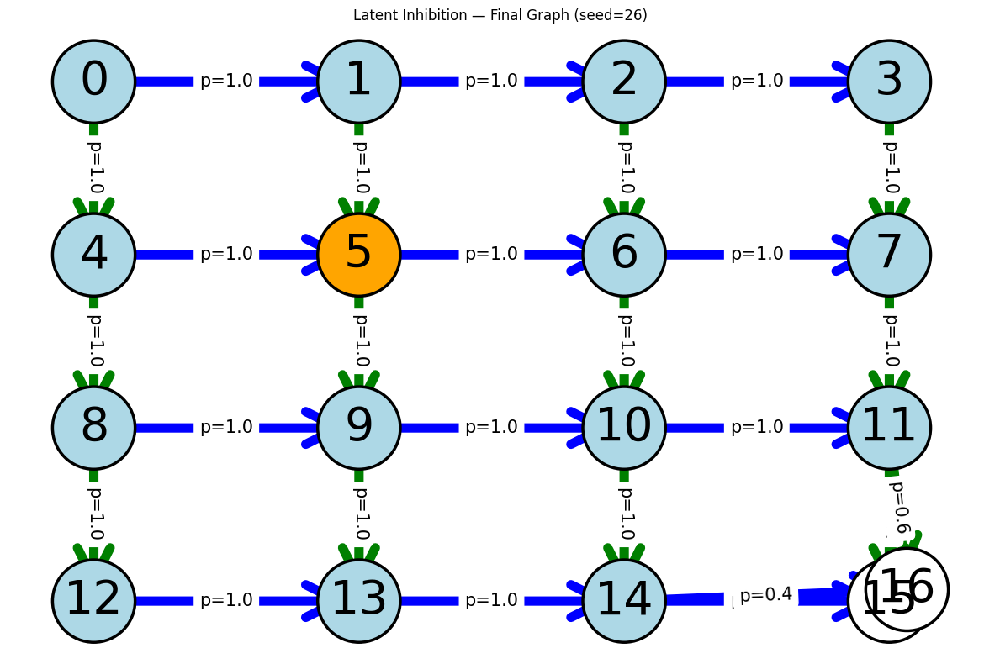

Contingency degradation — final graph (seed 26)


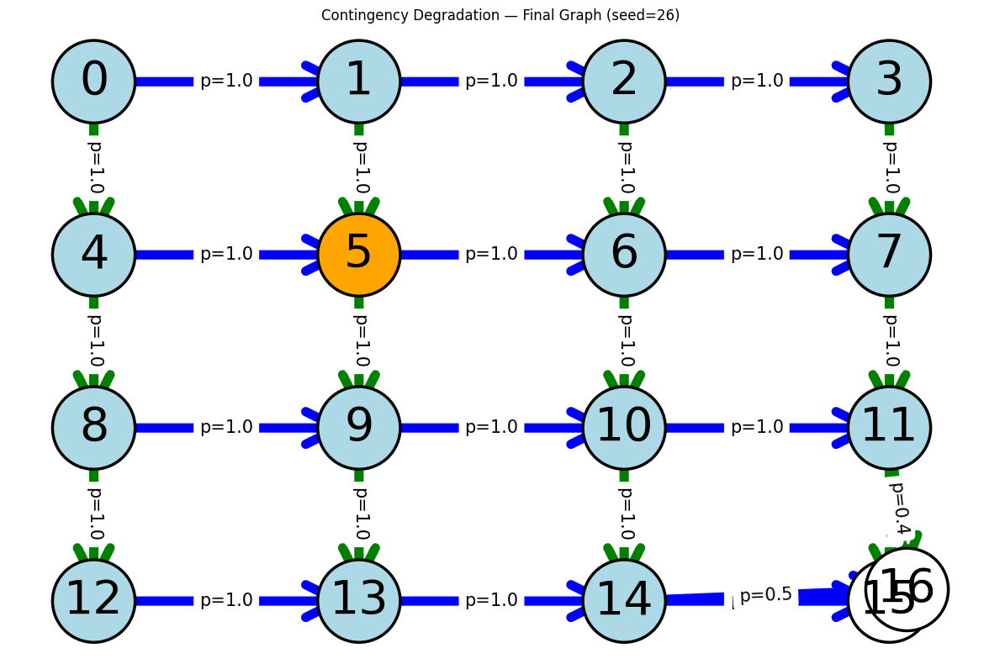

Latent inhibition — final acquisition graph (seed 27)


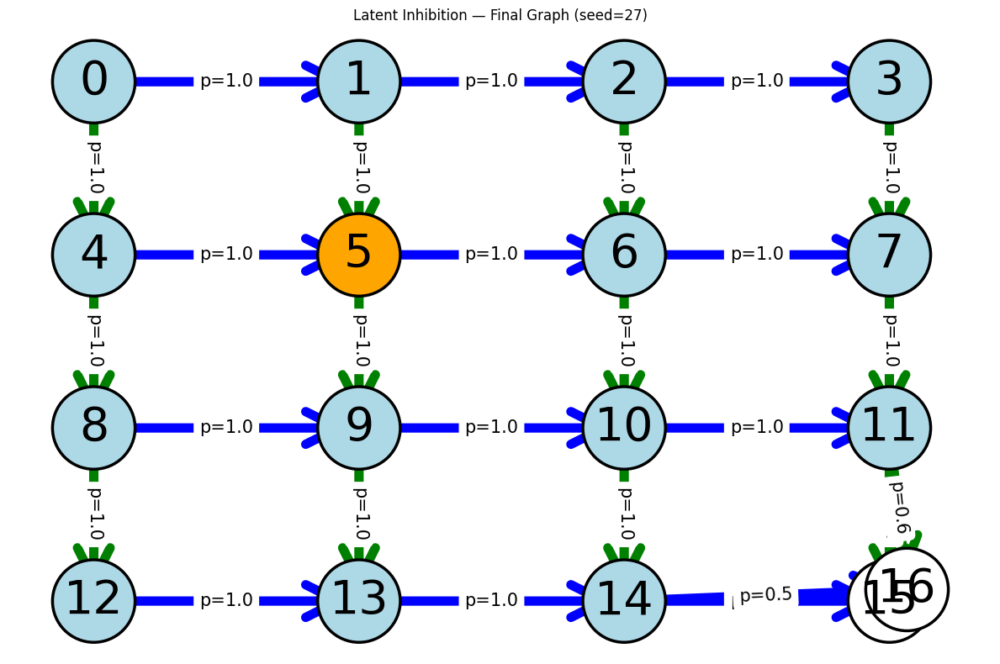

Contingency degradation — final graph (seed 27)


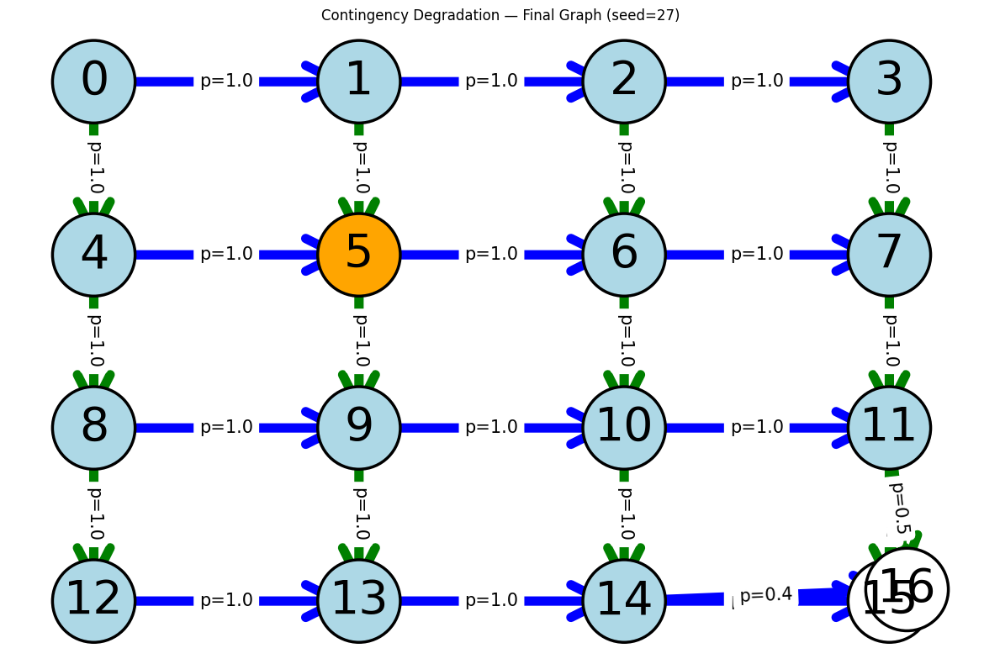

Latent inhibition — final acquisition graph (seed 28)


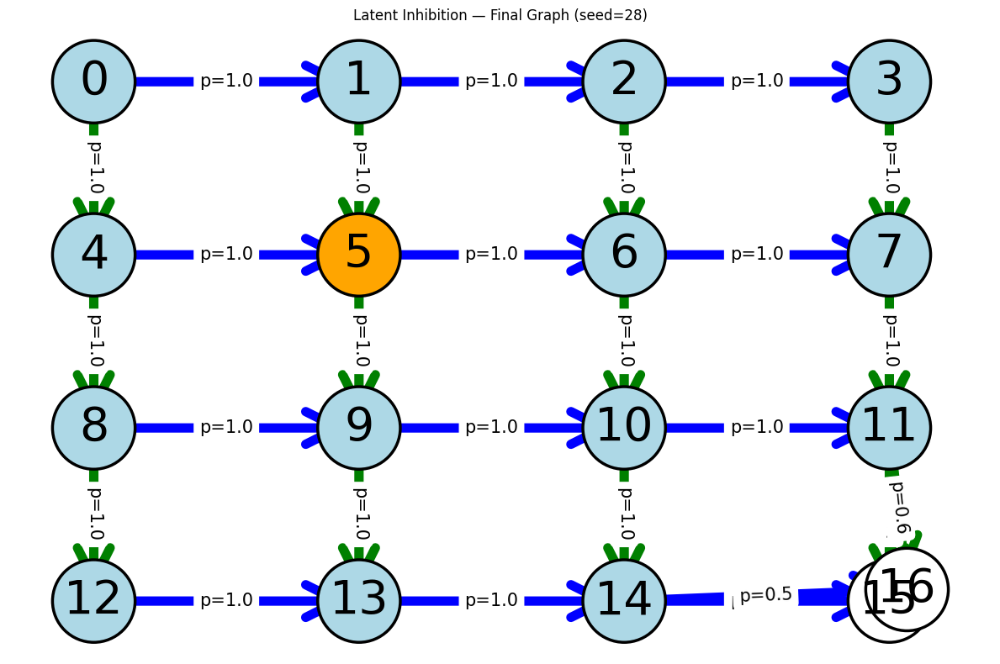

Contingency degradation — final graph (seed 28)


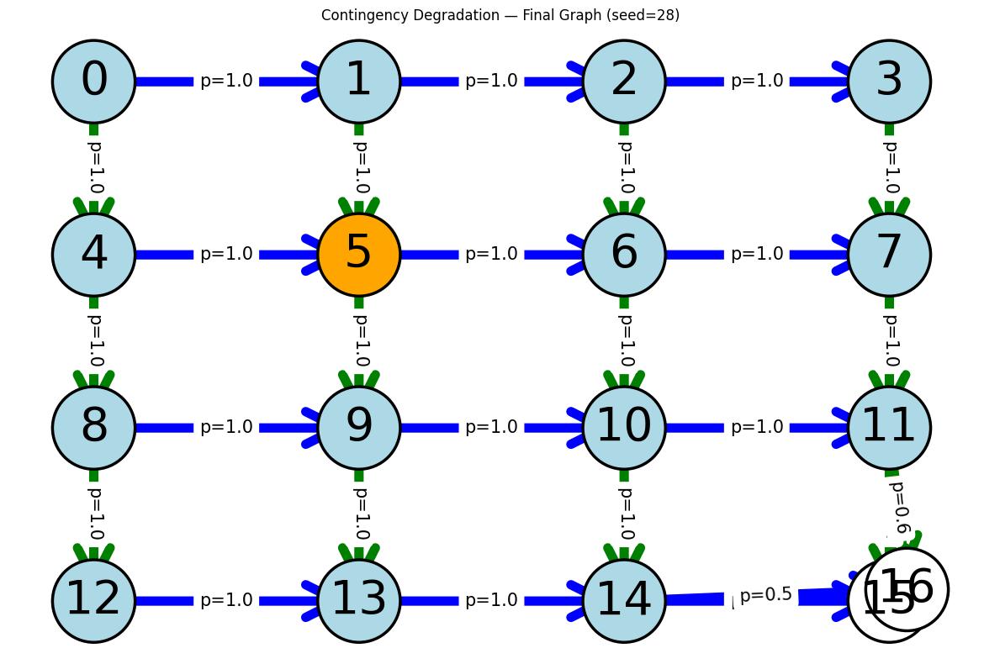

Latent inhibition — final acquisition graph (seed 29)


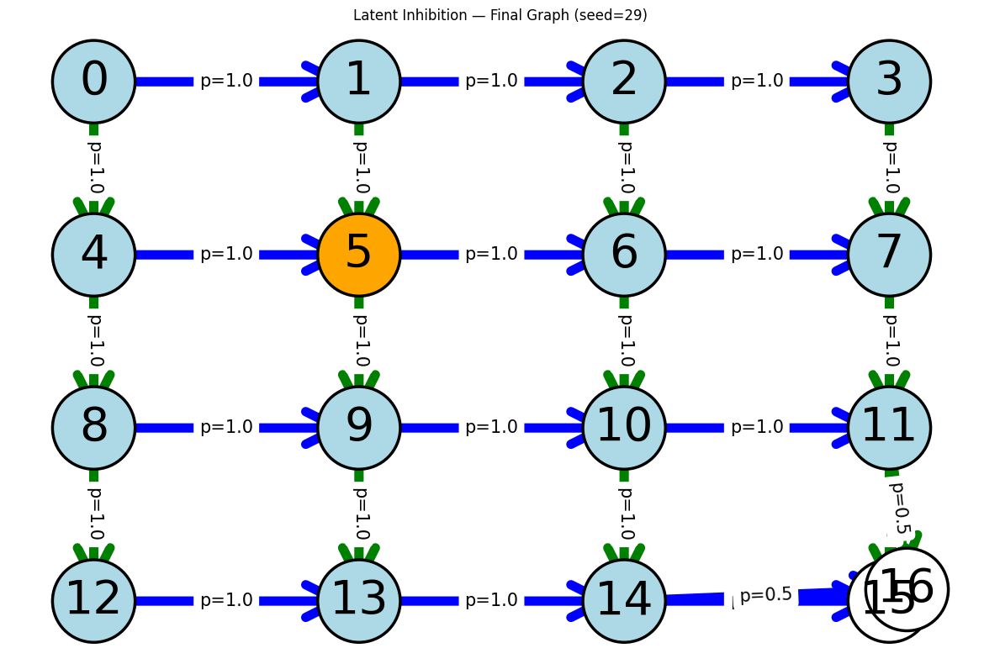

Contingency degradation — final graph (seed 29)


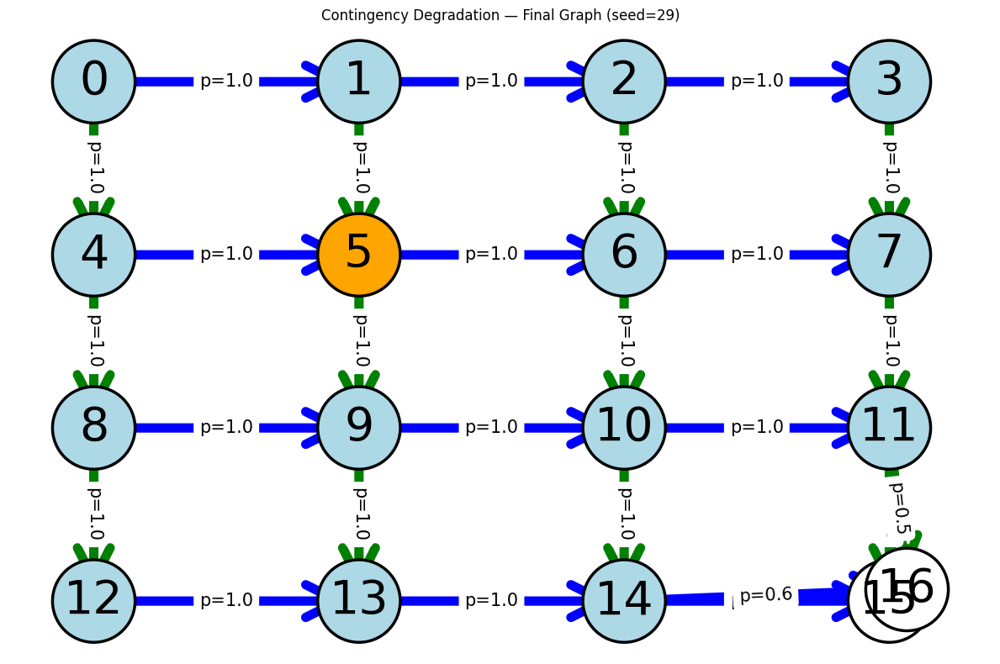

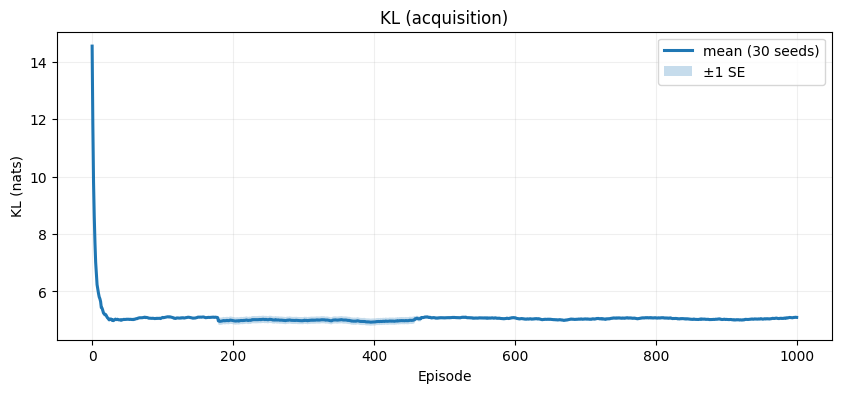

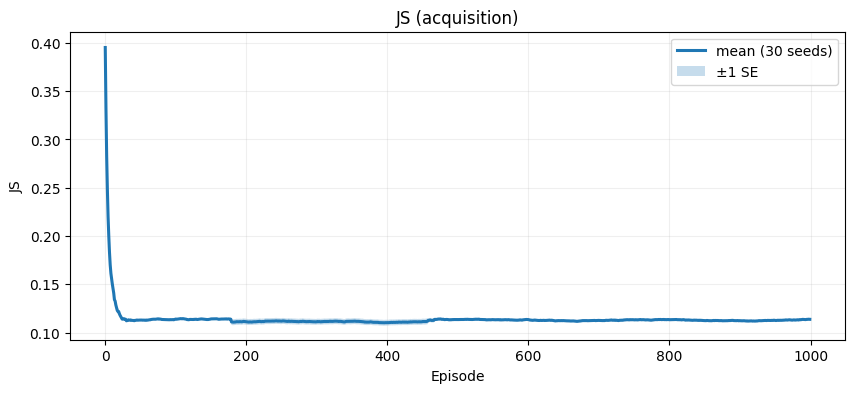

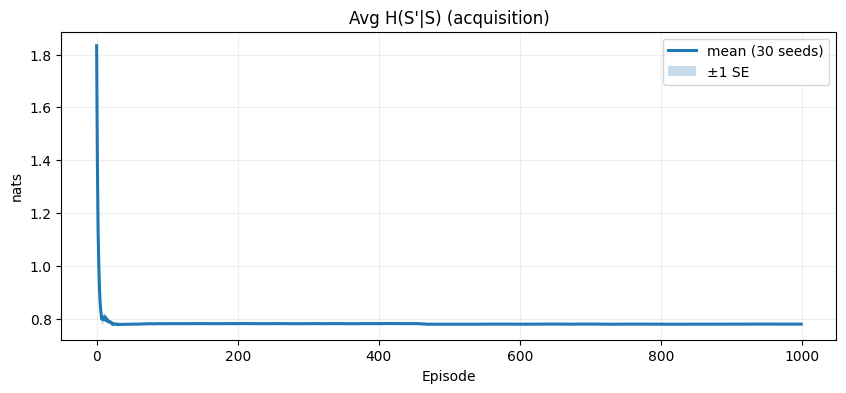

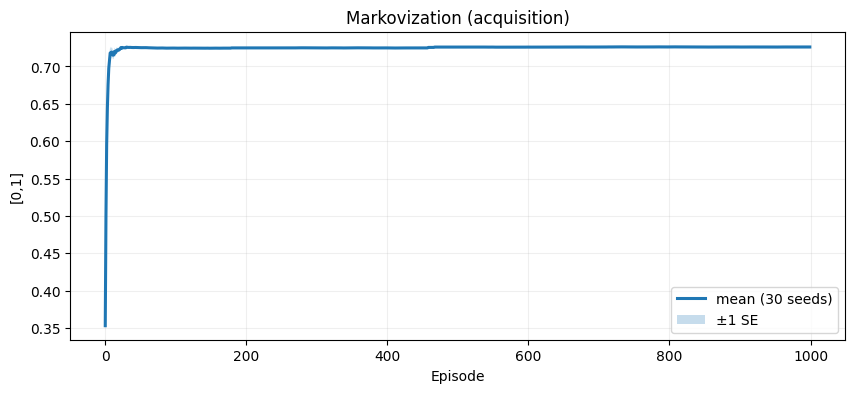

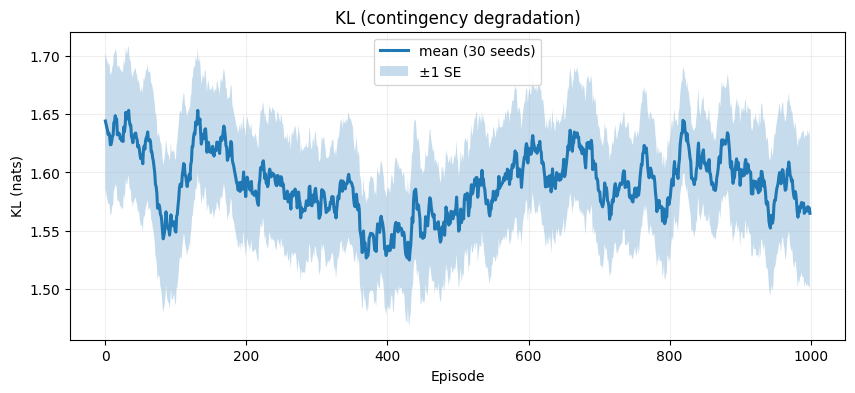

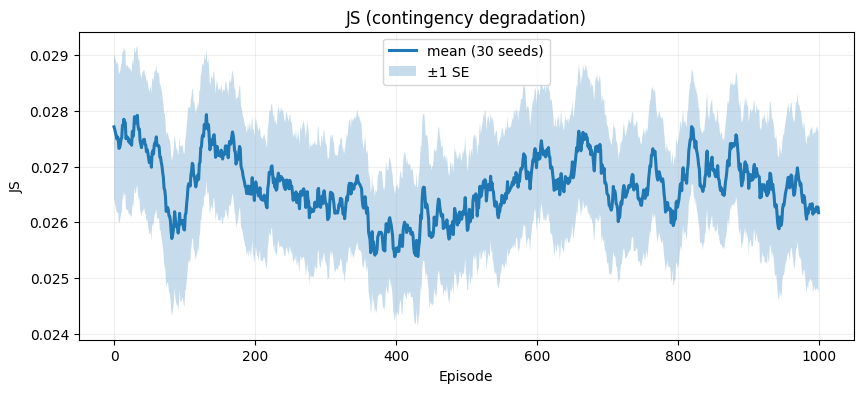

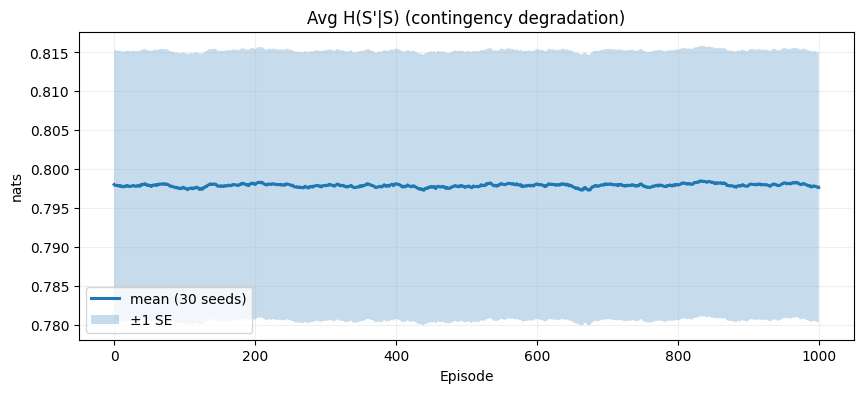

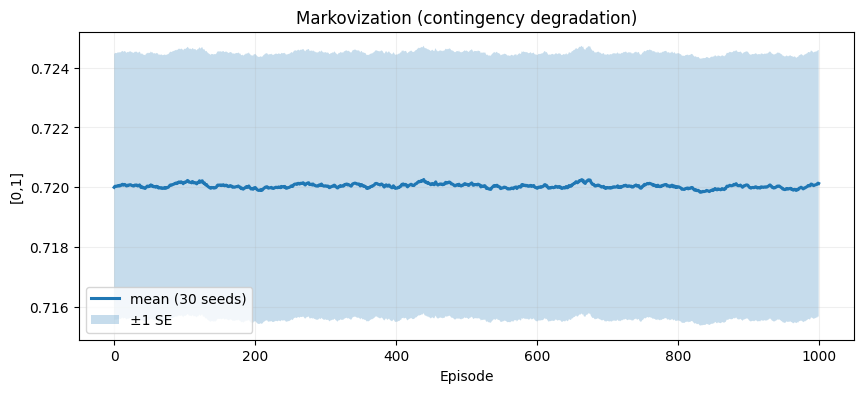

In [ ]:
# --- Parameters (paper-style) ---
N_LI_PRE = 500
N_LI_ACQ = 1000
N_CD_ACQ = 1000
N_CD_DEG = 1000
SEEDS    = list(range(30))  # 30 seeds

# Use your v2 acquisition cfg (keep it as you’ve set earlier)
cfg_li = CoDAConfig()  # latent inhibition relies on v2-like gating & uncertainty
cfg_cd = CoDAConfig()  # degradation uses same; merges depend on retrospective fall

# -------- Latent inhibition --------
res_li = run_latent_inhibition_many(cfg_li, SEEDS, pre_episodes=N_LI_PRE, acq_episodes=N_LI_ACQ, max_steps=MAX_STEPS, cue=CUE)
plot_latent_inhibition_summary(res_li, pre_episodes=N_LI_PRE)

# -------- Contingency degradation --------
res_deg = run_degradation_many(cfg_cd, SEEDS, acq_episodes=N_CD_ACQ, degr_episodes=N_CD_DEG, max_steps=MAX_STEPS, cue=CUE)
# plot_degradation_summary(res_deg)

# ===== Contingency degradation: plots in the same style as acquisition/extinction =====

# Unpack runs
KL_acq_runs = res_deg["KL_acq"]
JS_acq_runs = res_deg["JS_acq"]
H_acq_runs  = res_deg["H_acq"]
MS_acq_runs = res_deg["MS_acq"]

KL_deg_runs = res_deg["KL_deg"]
JS_deg_runs = res_deg["JS_deg"]
H_deg_runs  = res_deg["H_deg"]
MS_deg_runs = res_deg["MS_deg"]

# Reuse your mean±SE band helper
def mean_se(arrs):
    L = max(len(a) for a in arrs)
    M = np.full((len(arrs), L), np.nan)
    for i, a in enumerate(arrs):
        M[i, :len(a)] = a
    mean = np.nanmean(M, axis=0)
    se   = np.nanstd(M, axis=0, ddof=max(1, min(len(arrs)-1, 1))) / np.sqrt(max(1, len(arrs)))
    return mean, se

def plot_band(y_runs, title, ylabel):
    mean, se = mean_se(y_runs)
    x = np.arange(len(mean))
    plt.plot(x, mean, lw=2.2, label=f"mean ({len(y_runs)} seeds)")
    plt.fill_between(x, mean-se, mean+se, alpha=0.25, label="±1 SE")
    plt.title(title); plt.xlabel("Episode"); plt.ylabel(ylabel); plt.legend(); plt.grid(alpha=0.2)

# Acquisition portion (degradation runs, pre-switch)
plt.figure(figsize=(10,4)); plot_band(KL_acq_runs, "KL (acquisition)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_acq_runs, "JS (acquisition)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_acq_runs,  "Avg H(S'|S) (acquisition)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_acq_runs, "Markovization (acquisition)", "[0,1]"); plt.show()

# Degradation portion (post-switch)
plt.figure(figsize=(10,4)); plot_band(KL_deg_runs, "KL (contingency degradation)", "KL (nats)"); plt.show()
plt.figure(figsize=(10,4)); plot_band(JS_deg_runs, "JS (contingency degradation)", "JS"); plt.show()
plt.figure(figsize=(10,4)); plot_band(H_deg_runs,  "Avg H(S'|S) (contingency degradation)", "nats"); plt.show()
plt.figure(figsize=(10,4)); plot_band(MS_deg_runs, "Markovization (contingency degradation)", "[0,1]"); plt.show()


You can set `save=True` in `plot_graph` to export the changed snapshots as PNGs only for those episodes.

## Metrics: KL/JS vs episode, Entropy, and Markovization

In [ ]:

# Compute metrics using the module we prepared
from coda_metrics import kl_over_time, entropy_over_time, markovization_score, ref_empirical_from_rollouts, greedy_right_down_policy
import numpy as np

def ref_builder_factory(env, policy_fn, nroll=300, max_steps=20):
    def _make_ref(T_learned):
        return ref_empirical_from_rollouts(env, policy_fn, n_episodes=nroll, max_steps=max_steps)
    return _make_ref

# Build episode-wise empirical references
ref_fn_acq = ref_builder_factory(env,  greedy_right_down_policy, nroll=300, max_steps=20)
ref_fn_ext = ref_builder_factory(env2, greedy_right_down_policy, nroll=300, max_steps=20)

KL_acq = kl_over_time(T_series_acq, ref_fn_acq, use_js=False)
JS_acq = kl_over_time(T_series_acq, ref_fn_acq, use_js=True)
H_acq  = entropy_over_time(T_series_acq)
MS_acq = np.array([markovization_score(T) for T in T_series_acq])

KL_ext = kl_over_time(T_series_ext, ref_fn_ext, use_js=False)
JS_ext = kl_over_time(T_series_ext, ref_fn_ext, use_js=True)
H_ext  = entropy_over_time(T_series_ext)
MS_ext = np.array([markovization_score(T) for T in T_series_ext])


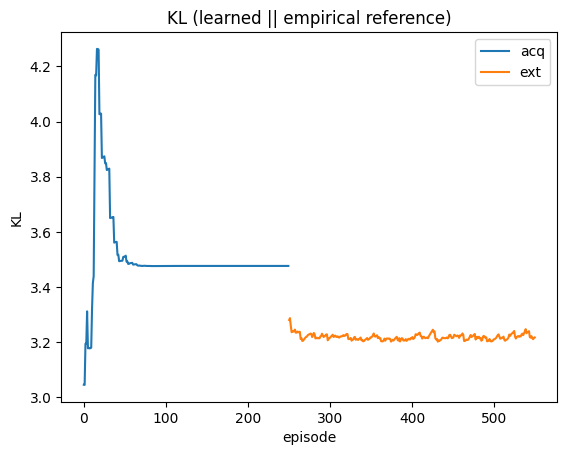

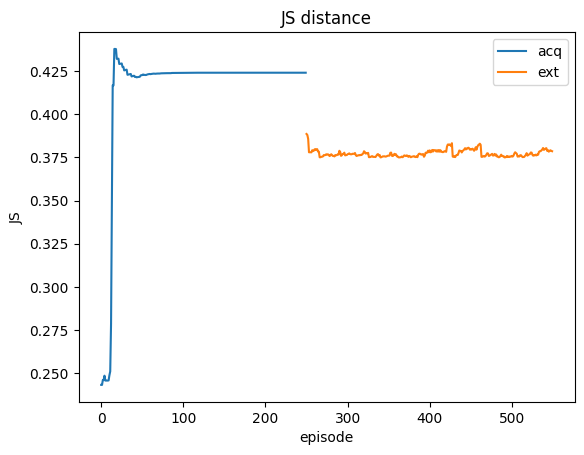

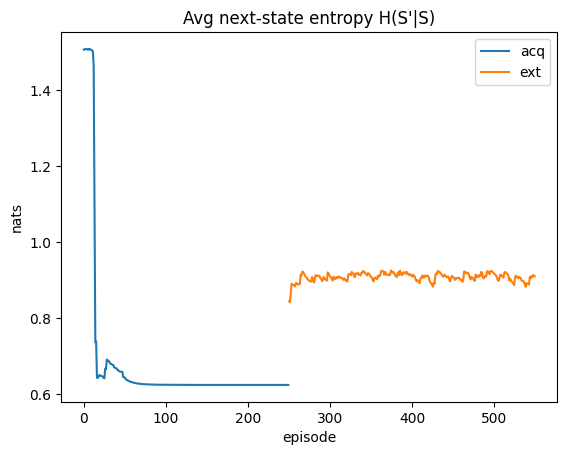

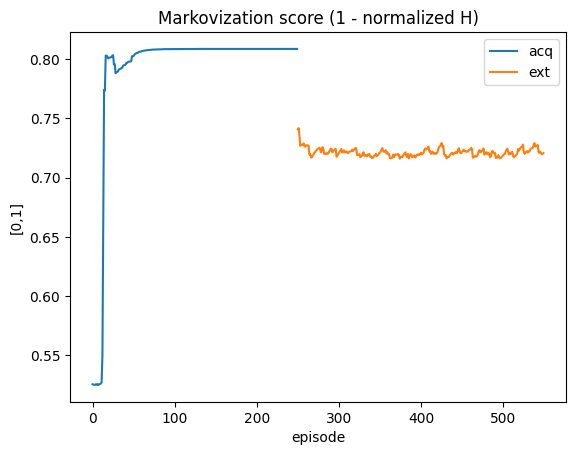

In [ ]:

# Plot (one metric per figure)
import matplotlib.pyplot as plt
import numpy as np

def _offset_plot(ax, y1, y2, label1, label2):
    ax.plot(y1, label=label1)
    off = len(y1)
    ax.plot(off + np.arange(len(y2)), y2, label=label2)
    ax.legend()
    ax.set_xlabel("episode")

fig, ax = plt.subplots()
ax.set_title("KL (learned || empirical reference)")
_offset_plot(ax, KL_acq, KL_ext, "acq", "ext")
ax.set_ylabel("KL")
plt.show()

fig, ax = plt.subplots()
ax.set_title("JS distance")
_offset_plot(ax, JS_acq, JS_ext, "acq", "ext")
ax.set_ylabel("JS")
plt.show()

fig, ax = plt.subplots()
ax.set_title("Avg next-state entropy H(S'|S)")
_offset_plot(ax, H_acq, H_ext, "acq", "ext")
ax.set_ylabel("nats")
plt.show()

fig, ax = plt.subplots()
ax.set_title("Markovization score (1 - normalized H)")
_offset_plot(ax, MS_acq, MS_ext, "acq", "ext")
ax.set_ylabel("[0,1]")
plt.show()


## Plots (separate panels with mean ± SE shading)

/opt/anaconda3/envs/coda-minigrid/lib/python3.10/site-packages/numpy/lib/_nanfunctions_impl.py:2019: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


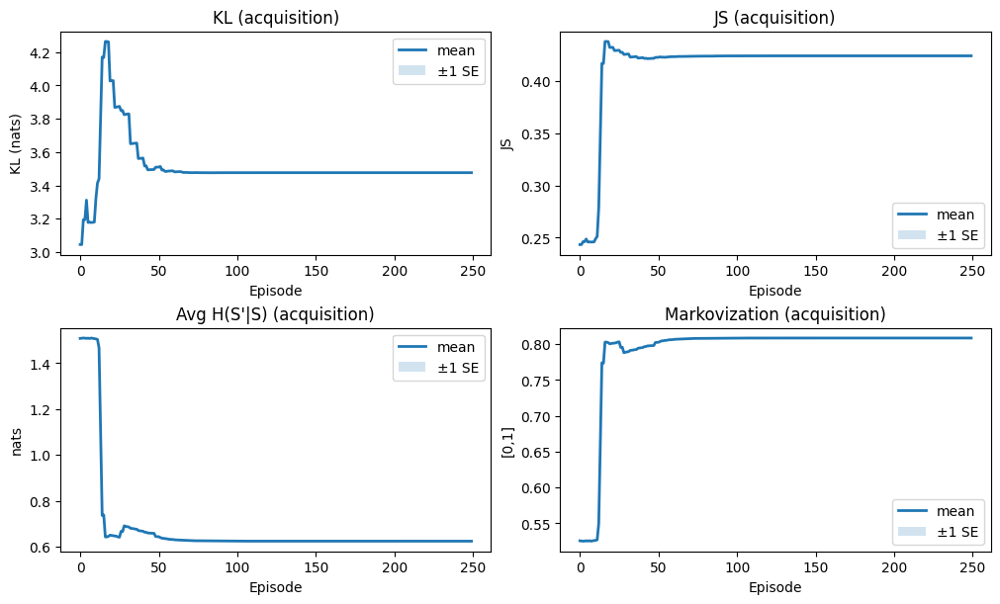

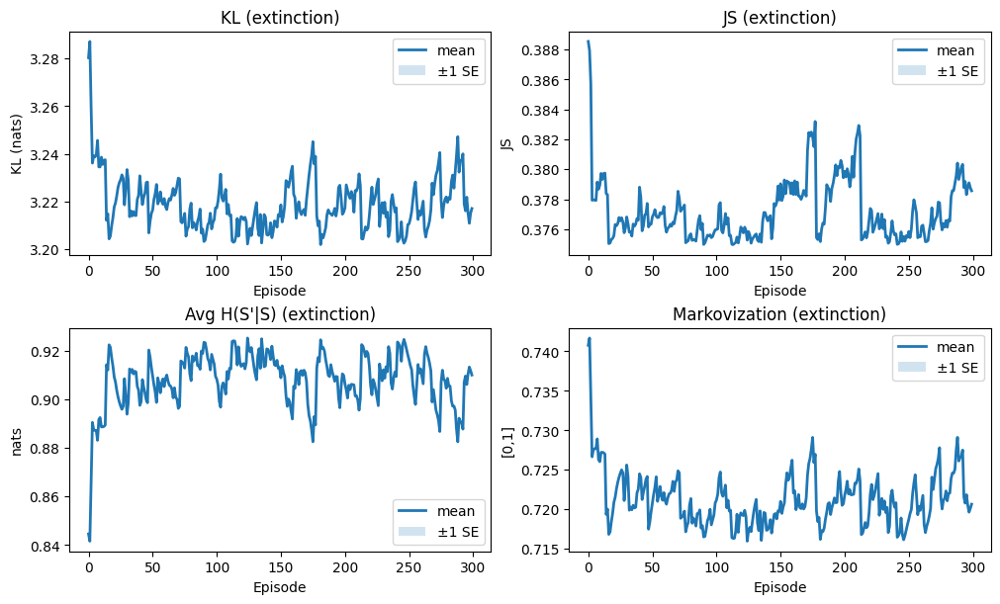

In [ ]:

import numpy as np
import matplotlib.pyplot as plt

def _pad_runs(runs):
    L = max(len(r) for r in runs)
    out = np.full((len(runs), L), np.nan, dtype=float)
    for i, r in enumerate(runs):
        out[i, :len(r)] = r
    return out

def _plot_with_band(ax, runs, title, ylabel):
    M = _pad_runs(runs) if isinstance(runs, (list, tuple)) and len(runs)>0 and isinstance(runs[0], (list, np.ndarray)) else np.atleast_2d(runs)
    mean = np.nanmean(M, axis=0)
    se   = np.nanstd(M, axis=0, ddof=1) / np.sqrt(max(1, M.shape[0]))
    x = np.arange(len(mean))
    ax.plot(x, mean, lw=2.0, label="mean")
    ax.fill_between(x, mean - se, mean + se, alpha=0.2, label="±1 SE")
    ax.set_title(title)
    ax.set_xlabel("Episode")
    ax.set_ylabel(ylabel)
    ax.legend()

# Wrap single-run arrays as [array] so the function produces a zero-width band
KL_acq_runs = [KL_acq] if not isinstance(KL_acq, (list, tuple)) else KL_acq
JS_acq_runs = [JS_acq] if not isinstance(JS_acq, (list, tuple)) else JS_acq
H_acq_runs  = [H_acq]  if not isinstance(H_acq,  (list, tuple)) else H_acq
MS_acq_runs = [MS_acq] if not isinstance(MS_acq, (list, tuple)) else MS_acq

KL_ext_runs = [KL_ext] if not isinstance(KL_ext, (list, tuple)) else KL_ext
JS_ext_runs = [JS_ext] if not isinstance(JS_ext, (list, tuple)) else JS_ext
H_ext_runs  = [H_ext]  if not isinstance(H_ext,  (list, tuple)) else H_ext
MS_ext_runs = [MS_ext] if not isinstance(MS_ext, (list, tuple)) else MS_ext

# Acquisition-only figure
fig, axes = plt.subplots(2, 2, figsize=(10,6), constrained_layout=True)
_plot_with_band(axes[0,0], KL_acq_runs, "KL (acquisition)", "KL (nats)")
_plot_with_band(axes[0,1], JS_acq_runs, "JS (acquisition)", "JS")
_plot_with_band(axes[1,0], H_acq_runs,  "Avg H(S'|S) (acquisition)", "nats")
_plot_with_band(axes[1,1], MS_acq_runs, "Markovization (acquisition)", "[0,1]")
plt.show()

# Extinction-only figure
fig, axes = plt.subplots(2, 2, figsize=(10,6), constrained_layout=True)
_plot_with_band(axes[0,0], KL_ext_runs, "KL (extinction)", "KL (nats)")
_plot_with_band(axes[0,1], JS_ext_runs, "JS (extinction)", "JS")
_plot_with_band(axes[1,0], H_ext_runs,  "Avg H(S'|S) (extinction)", "nats")
_plot_with_band(axes[1,1], MS_ext_runs, "Markovization (extinction)", "[0,1]")
plt.show()
